## Quantitative Risk Management Project -- VaR Construction and Backtesting using different models and tests.  


In [ ]:
!pip install yfinance==0.2.50

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.2/102.2 kB 4.2 MB/s eta 0:00:00
  Attempting uninstall: yfinance
    Found existing installation: yfinance 0.2.52
    Uninstalling yfinance-0.2.52:
      Successfully uninstalled yfinance-0.2.52


Data acquisition

In [ ]:
import pandas as pd
import yfinance as yf
tickers = ['AMZN', 'DIS', 'AAPL', 'MSFT', 'JPM', 'F', 'PG',  '^GSPC',  '^IXIC'] #added s&p500, nasdaq
start_date = '2009-06-10'
end_date = '2024-12-12'

combined_data = pd.DataFrame()
for ticker in tickers:
    print(f"Downloading the data for  {ticker}...")

    data = yf.download(ticker, start=start_date, end=end_date, interval='1d')
    # Extract only column "Adj Close"
    if not data.empty:
        combined_data[ticker] = data['Adj Close']
    else:
        print(f"Warning: No data found for {ticker}.")

# Save combined data in  .CSV
combined_data.to_csv('combined_data_adj_close.csv')
print("Data succesfully  saved in csv")

[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


[*********************100%***********************]  1 of 1 completed


Data succesfully  saved in csv


                  AMZN         DIS        AAPL        MSFT         JPM  \
Date                                                                     
2022-01-03  170.404495  154.847076  178.879898  326.287689  147.901245   
2022-01-04  167.522003  153.829651  176.609650  320.692780  153.508133   
2022-01-05  164.356995  153.296234  171.911835  308.382111  150.701706   
2022-01-06  163.253998  154.985352  169.042068  305.945343  152.302719   
2022-01-07  162.554001  155.904022  169.209137  306.101227  153.811783   

                    F          PG        ^GSPC         ^IXIC  
Date                                                          
2022-01-03  17.831310  150.336319  4796.560059  15832.799805  
2022-01-04  19.911764  150.862381  4793.540039  15622.719727  
2022-01-05  19.379362  151.545303  4700.580078  15100.169922  
2022-01-06  20.034622  150.271713  4696.049805  15080.860352  
2022-01-07  20.018240  150.188675  4677.029785  14935.900391  

Tickers found: Index(['AMZN', 'DIS', 'A

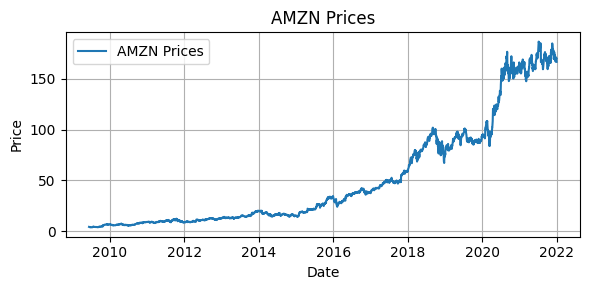

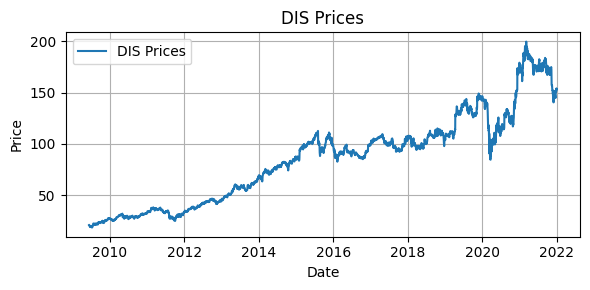

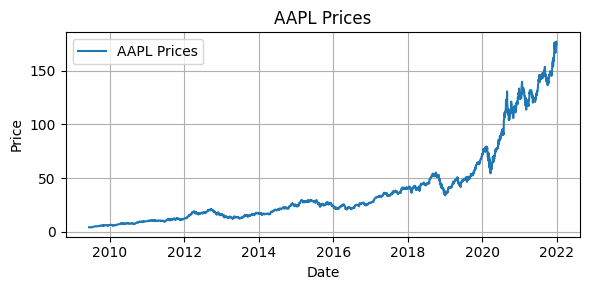

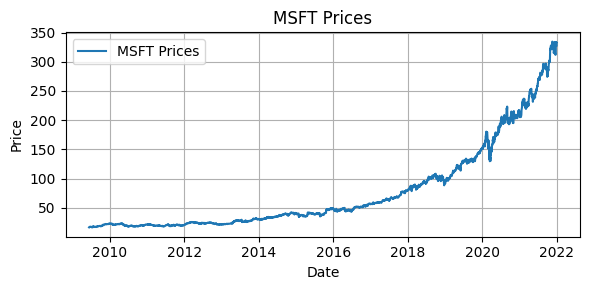

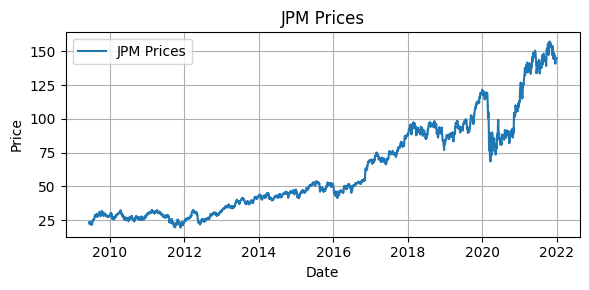

...

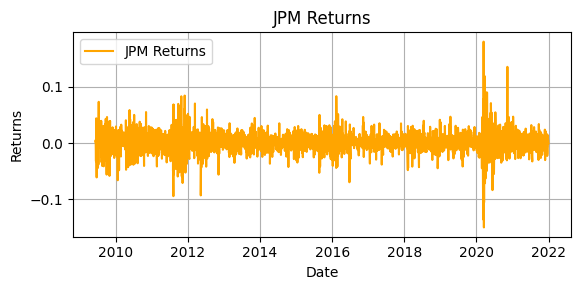

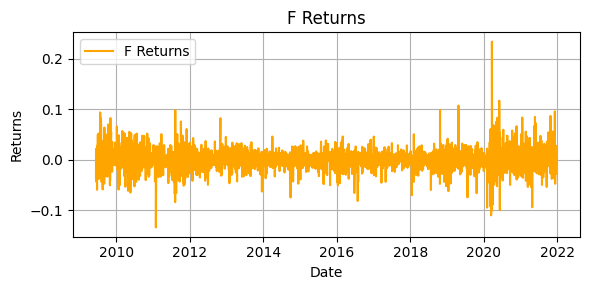

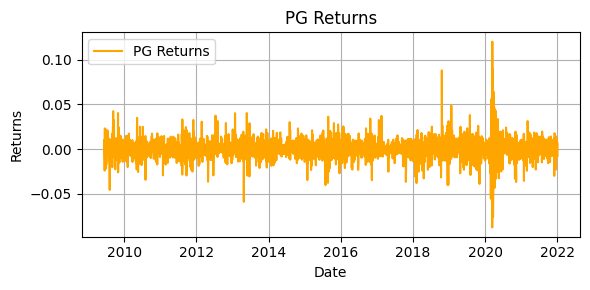

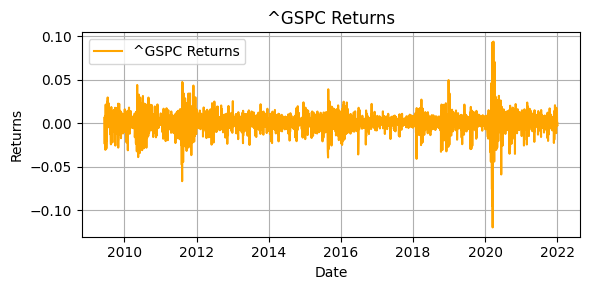

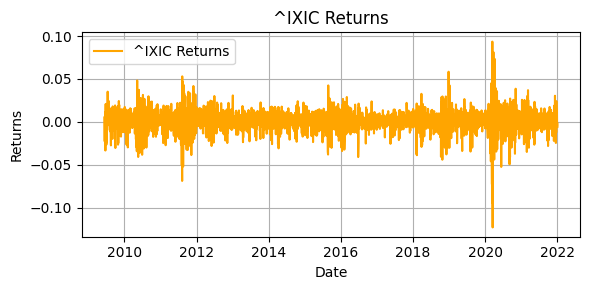

Statistics:
Mean: 0.000869
Median: 0.000764
Standard Deviation: 0.016199
95% VaR (5th percentile): -0.023678
99% VaR (1st percentile): -0.043670
Maximum Value: 0.267951
Minimum Value: -0.149649

Statistics for AMZN:
Statistics:
Mean: 0.001358
Median: 0.000974
Standard Deviation: 0.020279
95% VaR (5th percentile): -0.027965
99% VaR (1st percentile): -0.052417
Maximum Value: 0.267951
Minimum Value: -0.126568

Statistics for DIS:
Statistics:
Mean: 0.000747
Median: 0.000626
Standard Deviation: 0.015786
95% VaR (5th percentile): -0.021505
99% VaR (1st percentile): -0.039281
Maximum Value: 0.144123
Minimum Value: -0.129846

Statistics for AAPL:
Statistics:
Mean: 0.001332
Median: 0.001097
Standard Deviation: 0.017588
95% VaR (5th percentile): -0.025703
99% VaR (1st percentile): -0.045784
Maximum Value: 0.119808
Minimum Value: -0.128647

Statistics for MSFT:
Statistics:
Mean: 0.001064
Median: 0.000744
Standard Deviation: 0.015771
95% VaR (5th percentile): -0.022835
99% VaR (1st percentile): -0

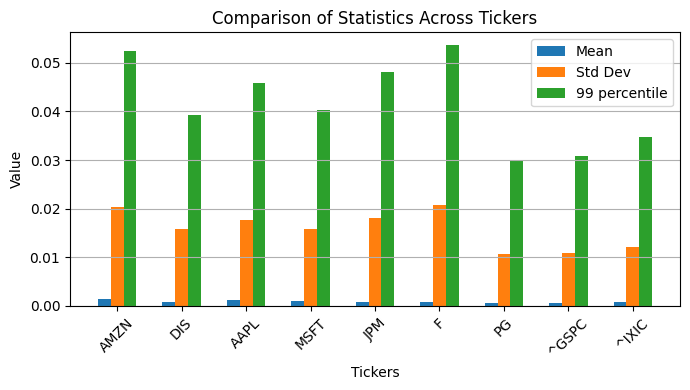

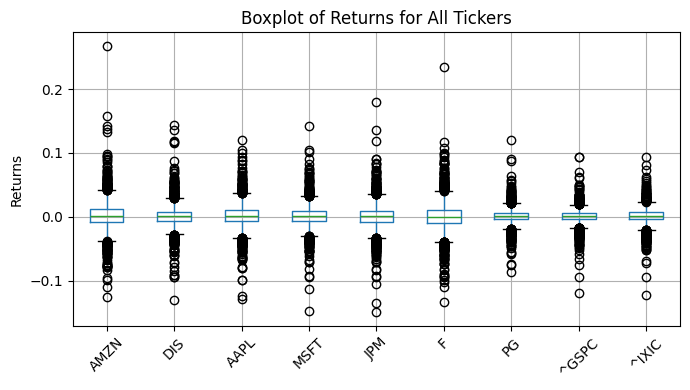

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

file_path = 'combined_data_adj_close.csv'
prices = pd.read_csv(file_path, index_col='Date', parse_dates=True)
prices_out_of_sample = prices.loc['2022-01-01': '2024-12-20'] # test set = 3 years
print(prices_out_of_sample.head())
prices=prices.loc[:'2021-12-31']    # ONLY SET 12 years FOR MODEL ESTIMATION

# Extract only  Adj Close prices column for each ticker
tickers = prices.columns
print("\nTickers found:", tickers)

# create dictionary to store prices and ticker together
prices_dict = {ticker: prices[ticker] for ticker in tickers}

for ticker in tickers:
    print(f"\nPrice for {ticker}:")
    print(prices_dict[ticker].head())

# RETURNS for each ticker
#returns = prices.pct_change()
returns = (prices.values[1:] / prices.values[:-1]) - 1
#returns= (returns - returns.mean()) / returns.std()     #  standardization

#print(returns.head())
returns_df = pd.DataFrame(returns, columns=prices.columns, index=prices.index[1:])
print(returns_df.head())

# LOG RETURNS for each ticker
log_returns = np.log(prices / prices.shift(1))
print("\nLog returns (first rows):")
print(log_returns.head())

# Save returns in file CSV
#returns.to_csv('simple_returns.csv')
log_returns.to_csv('log_returns.csv')
print("\nReturns saved in 'simple_returns.csv' and 'log_returns.csv'.")

########## FIGURES-----------

# PRICES: Plot each ticker in a separate graph
for ticker in prices.columns:
    plt.figure(figsize=(6, 3))  # Create a new figure for each ticker
    plt.plot(prices.index, prices[ticker], label=f'{ticker} Prices')
    plt.title(f'{ticker} Prices')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# RETURNS: Plot each ticker's returns
for ticker in returns_df.columns:
    plt.figure(figsize=(6, 3))  # Create a new figure for each ticker
    plt.plot(returns_df.index, returns_df[ticker], label=f'{ticker} Returns', color='orange')
    plt.title(f'{ticker} Returns')
    plt.xlabel('Date')
    plt.ylabel('Returns')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# for ticker in returns_df.columns:
#     plt.figure(figsize=(6, 3))  # Create a new figure for each ticker
#     plt.plot(log_returns.index, log_returns[ticker], label=f'{ticker} LogReturns', color='orange')
#     plt.title(f'{ticker} LogReturns')
#     plt.xlabel('Date')
#     plt.ylabel('LogReturns')
#     plt.legend()
#     plt.grid(True)
#     plt.tight_layout()
#     plt.show()

def calculate_statistics(returns):
    mean = np.mean(returns)
    median = np.median(returns)
    std_dev = np.std(returns)
    var_95 = np.percentile(returns, 5)  # 5th percentile for 95% VaR
    var_99 = np.percentile(returns, 1)  # 1st percentile for 99% VaR
    max_value = np.max(returns)
    min_value = np.min(returns)

    print("Statistics:")
    print(f"Mean: {mean:.6f}")
    print(f"Median: {median:.6f}")
    print(f"Standard Deviation: {std_dev:.6f}")
    print(f"95% VaR (5th percentile): {var_95:.6f}")
    print(f"99% VaR (1st percentile): {var_99:.6f}")
    print(f"Maximum Value: {max_value:.6f}")
    print(f"Minimum Value: {min_value:.6f}")

# Ex Calculate for one ticker
calculate_statistics(returns)

# Loop through all tickers in a DataFrame
for ticker in returns_df.columns:
    print(f"\nStatistics for {ticker}:")
    calculate_statistics(returns_df[ticker].dropna().values)

def plot_statistics(returns_df):
    # Calculate statistics for all tickers
    stats = {
        'Mean': [],
        'Median': [],
        'Std Dev': [],
        '99 percentile': []
    }

    tickers = returns_df.columns
    for ticker in tickers:
        returns = returns_df[ticker].dropna().values
        stats['Mean'].append(np.mean(returns))
        stats['Median'].append(np.median(returns))
        stats['Std Dev'].append(np.std(returns))
        #stats['95% percentile'].append(np.percentile(returns, 5))
        stats['99 percentile'].append(-np.percentile(returns, 1))

    # Bar Chart to Compare Mean, Std Dev, and VaR across tickers
    x = np.arange(len(tickers))  # Index for tickers
    width = 0.2

    plt.figure(figsize=(7, 4))

    plt.bar(x - width, stats['Mean'], width, label='Mean')
    plt.bar(x, stats['Std Dev'], width, label='Std Dev')
    plt.bar(x + width, stats['99 percentile'], width, label='99 percentile')

    plt.xticks(x, tickers, rotation=45)
    plt.xlabel('Tickers')
    plt.ylabel('Value')
    plt.title('Comparison of Statistics Across Tickers')
    plt.legend()
    plt.grid(axis='y')
    plt.tight_layout()
    plt.show()

    # Box Plot for Distribution of Returns
    plt.figure(figsize=(7, 4))
    returns_df.boxplot()
    plt.title('Boxplot of Returns for All Tickers')
    plt.ylabel('Returns')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

plot_statistics(returns_df)

In [ ]:
!pip install arch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 985.3/985.3 kB 16.4 MB/s eta 0:00:00


## Garch (2,2) Model fit in sample data

Adapting GARCH for  AMZN...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004112. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                          Zero Mean - GARCH Model Results                           
Dep. Variable:                         AMZN   R-squared:                       0.000
Mean Model:                       Zero Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:                8293.77
Distribution:      Standardized Student's t   AIC:                          -16575.5
Method:                  Maximum Likelihood   BIC:                          -16539.2
                                              No. Observations:                 3163
Date:                      Sat, Feb 15 2025   Df Residuals:                     3163
Time:                              12:44:52   Df Model:                            0
                               Volatility Model                              
                 coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------------------------------------------------
o

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002492. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003093. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                          Zero Mean - GARCH Model Results                           
Dep. Variable:                         AAPL   R-squared:                       0.000
Mean Model:                       Zero Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:                8653.69
Distribution:      Standardized Student's t   AIC:                          -17295.4
Method:                  Maximum Likelihood   BIC:                          -17259.0
                                              No. Observations:                 3163
Date:                      Sat, Feb 15 2025   Df Residuals:                     3163
Time:                              12:44:52   Df Model:                            0
                              Volatility Model                              
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
omeg

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002487. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003282. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                          Zero Mean - GARCH Model Results                           
Dep. Variable:                          JPM   R-squared:                       0.000
Mean Model:                       Zero Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:                8814.24
Distribution:      Standardized Student's t   AIC:                          -17616.5
Method:                  Maximum Likelihood   BIC:                          -17580.1
                                              No. Observations:                 3163
Date:                      Sat, Feb 15 2025   Df Residuals:                     3163
Time:                              12:44:53   Df Model:                            0
                              Volatility Model                              
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
omeg

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004342. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001153. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarn

                          Zero Mean - GARCH Model Results                           
Dep. Variable:                            F   R-squared:                       0.000
Mean Model:                       Zero Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:                8292.73
Distribution:      Standardized Student's t   AIC:                          -16573.5
Method:                  Maximum Likelihood   BIC:                          -16537.1
                                              No. Observations:                 3163
Date:                      Sat, Feb 15 2025   Df Residuals:                     3163
Time:                              12:44:53   Df Model:                            0
                              Volatility Model                              
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
omeg

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001478. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                          Zero Mean - GARCH Model Results                           
Dep. Variable:                        ^GSPC   R-squared:                       0.000
Mean Model:                       Zero Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:                10651.4
Distribution:      Standardized Student's t   AIC:                          -21290.8
Method:                  Maximum Likelihood   BIC:                          -21254.5
                                              No. Observations:                 3163
Date:                      Sat, Feb 15 2025   Df Residuals:                     3163
Time:                              12:44:53   Df Model:                            0
                              Volatility Model                              
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
omeg

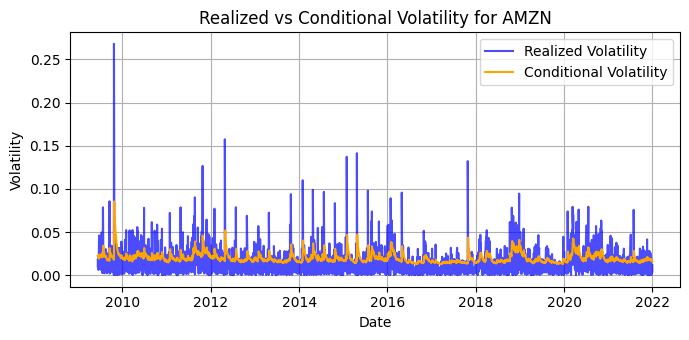

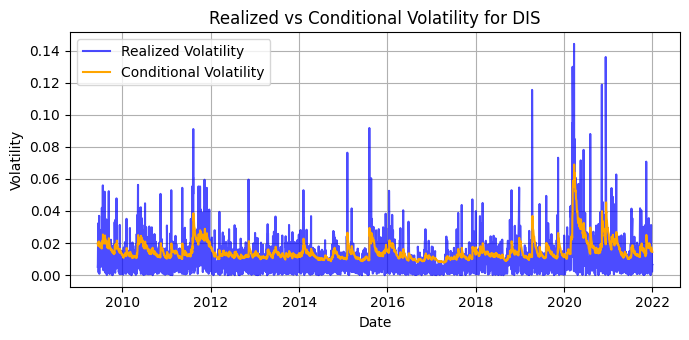

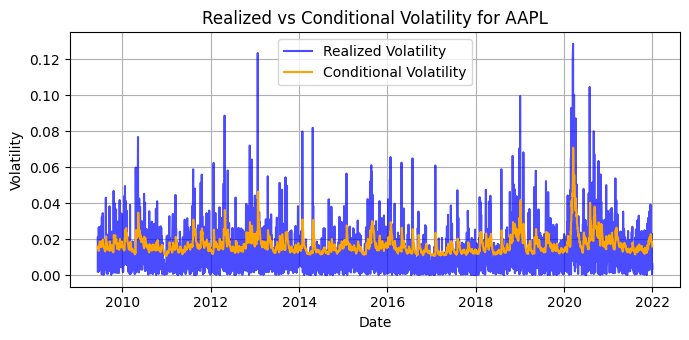

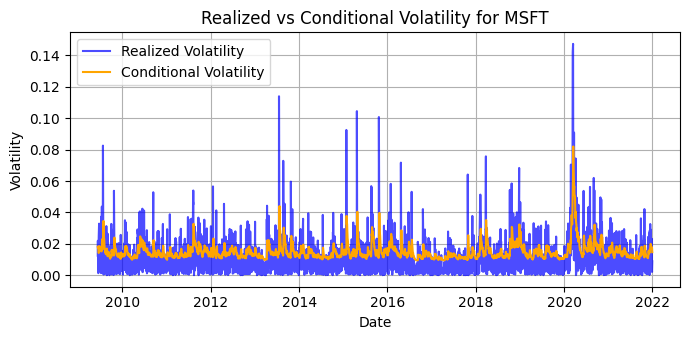

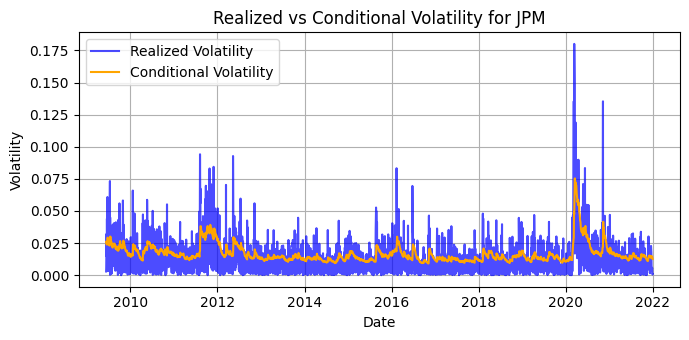

...

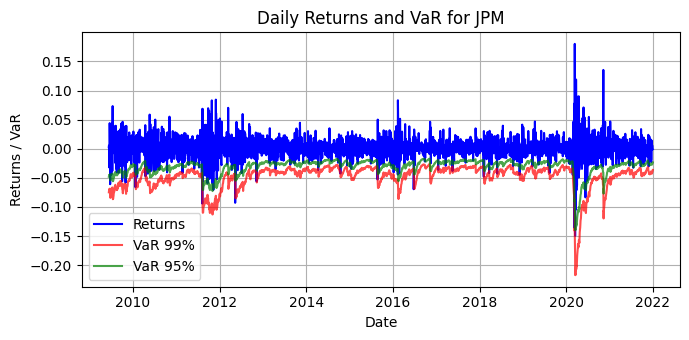

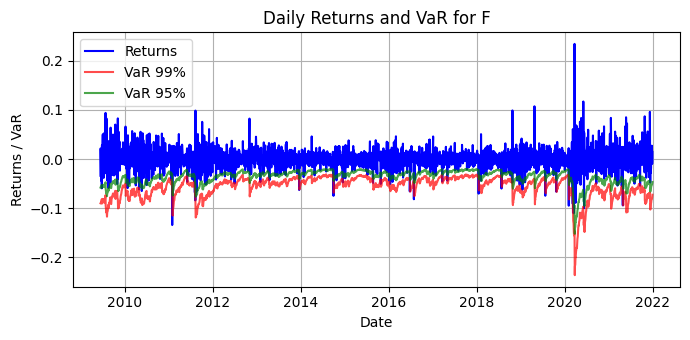

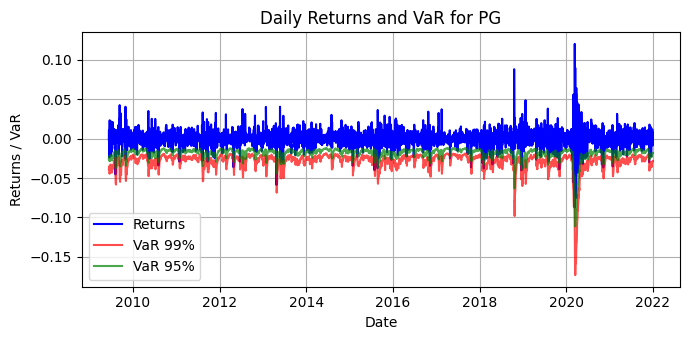

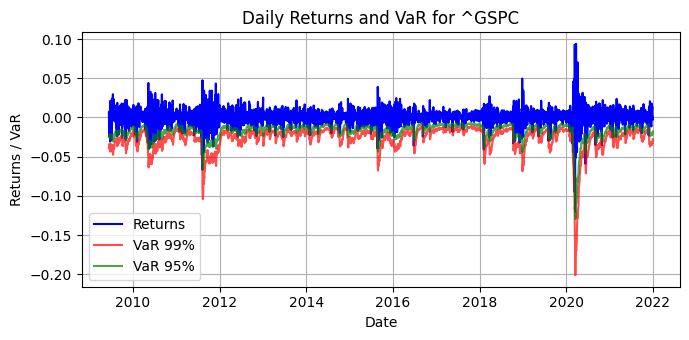

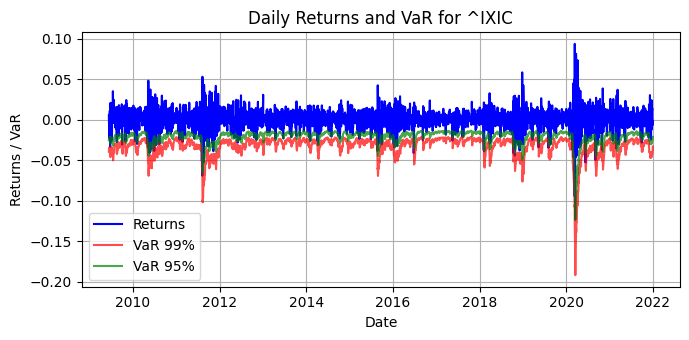

In [ ]:
from arch import arch_model
from scipy.stats import t, norm

# Dictionary
garch_models = {}

for ticker in returns_df.columns:
    print(f"Adapting GARCH for  {ticker}...")
    returns = returns_df[ticker].dropna()
    model = arch_model(returns, mean='Zero', vol='Garch', p=2, q=2, dist='t')
    # model = arch_model(returns, mean='Zero', vol='EGarch', p=1, q=1, dist='t')
    # model = arch_model(returns, mean='Zero', vol='Garch', p=1, q=1, dist= 'normal')
    res = model.fit(update_freq=5, disp='off')
    garch_models[ticker] = res
    print(res.summary())


confidence_level = 0.01
z = norm.ppf(1 - confidence_level)

for ticker, res in garch_models.items():
    plt.figure(figsize=(7,3.5))
    # realized volatility as absolute value of returns
    realized_vol = returns_df[ticker].abs()
    plt.plot(realized_vol, label='Realized Volatility', color='blue', alpha=0.7)
     #conditional volatilty
    conditional_vol = res.conditional_volatility
    plt.plot(conditional_vol, label='Conditional Volatility', color='orange')

    plt.title(f"Realized vs Conditional Volatility for {ticker}")
    plt.xlabel("Date")
    plt.ylabel("Volatility")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

dof = res.params['nu']
quantile_t = t.ppf(1 - confidence_level, df=dof)
dof, quantile_t
quantile_5 = t.ppf(1 - 0.05, df=dof)

for ticker, res in garch_models.items():
    plt.figure(figsize=(7,3.5))

    # conditional
    conditional_vol = res.conditional_volatility
    # var computation
    #VaR = conditional_vol * z
    VaR_99 = conditional_vol * quantile_t
    VaR_95 = conditional_vol * quantile_5

    # Plot
    plt.plot(returns_df.index, returns_df[ticker], label='Returns', color='blue')
    plt.plot(returns_df.index, -VaR_99, label='VaR 99%', color='red', alpha=0.7)
    plt.plot(returns_df.index, -VaR_95, label='VaR 95%', color='green', alpha=0.7)

    plt.title(f"Daily Returns and VaR for {ticker}")
    plt.xlabel("Date")
    plt.ylabel("Returns / VaR")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

## Historical var

In [ ]:
def empirical_quantile(returns, alpha=0.01):  # python dovrebbe farlo gia di default
    """
    computing the empirical quantile using formula from prof slides
    Returns:
    q_alpha: float, empirical quantile
    """
    # ordering returns (ascending)
    sorted_returns = np.sort(returns)
    #  kth position in ordered distribution
    T = len(sorted_returns)
    k = T * alpha
     # interpolating
    m = int(np.ceil(k))  # first integer value >= k
    m_minus_1 = m - 1    # previous value
    # Interpolation
    if m < T:
        q_alpha = (
            (m - k) * sorted_returns[m_minus_1] + (k - (m_minus_1)) * sorted_returns[m]
        )
    else:
        q_alpha = sorted_returns[-1]  # if m is bigger than T, use the last value

    return q_alpha


def historical_var(returns, alpha=0.01):
    return np.percentile(returns, alpha * 100)
historical_var(returns, 0.01)


def cornish_fisher_var(returns, alpha=0.01):
    """
    - VaR: corrected var value for skewness and  kurtosis, useful if we have few observations
    """
    mu = np.mean(returns)
    sigma = np.std(returns)
    skew = pd.Series(returns).skew()
    kurt = pd.Series(returns).kurt()

    # quantile from standard normal
    qz_alpha = norm.ppf(alpha)
    # cornish-Fisher adjustment
    q_cf = (
        qz_alpha +
        (skew / 6) * (qz_alpha**2 - 1) +
        (kurt / 24) * (qz_alpha**3 - 3 * qz_alpha) -
        (skew**2 / 36) * (2 * qz_alpha**3 - 5 * qz_alpha)
    )

    # VaR
    var = mu + sigma * q_cf
    return var


def historical_var_horizon(returns, alpha=0.01, horizon=1, use_square_root=False):
    """
    computing var, (optional : set time horizon)
    Parameters:
    - horizon: int, temporal horizon in days  (default 1)
    - use_square_root: bool, if True, use square root del tempo to scale  VaR
    """
    var = np.percentile(returns, alpha * 100)

    if use_square_root and horizon > 1:
        var *= np.sqrt(horizon)

    return var


for ticker in tickers:
    returns = returns_df[ticker].dropna()

    # Historical Simulation
    hs_var = historical_var_horizon(returns,  horizon=10, alpha=0.01,  use_square_root=False)
    # Cornish-Fisher Approximation
    cf_var = cornish_fisher_var(returns, alpha=0.01)
    print(f"{ticker}: Historical VaR (99%): {hs_var:.5f}, Cornish-Fisher VaR (99%): {cf_var:.5f}")


for ticker in tickers:
  returns = returns_df[ticker].dropna()
  var_empirical_app = empirical_quantile(returns, alpha=0.01)
  print(f"{ticker}: empirical distribution approximation for var 99% : {var_empirical_app:.5f}")


for ticker in returns_df.columns:
    print(f"\nCalculating annual historical VaR for {ticker}...")
    returns = returns_df[ticker]
    annual_groups = returns.groupby(returns.index.year)
    for year, annual_returns in annual_groups:
        var_99 = historical_var(annual_returns, 0.01)
        print(f"Historical VaR (99%) for {ticker} in {year}: {var_99:.5f}")

for ticker in returns_df.columns:
  returns = returns_df[ticker].dropna().values
  var_99_hist = np.percentile(returns, 1)  #  (VaR  99%)
  var_95_hist = np.percentile(returns, 5)   #  (VaR  95%)
  print(f"Historical VaR (99%): {var_99_hist} for {ticker}, Historical VaR (95%): {var_95_hist} for {ticker}")

AMZN: Historical VaR (99%): -0.05242, Cornish-Fisher VaR (99%): -0.09335
DIS: Historical VaR (99%): -0.03928, Cornish-Fisher VaR (99%): -0.07249
AAPL: Historical VaR (99%): -0.04578, Cornish-Fisher VaR (99%): -0.06403
MSFT: Historical VaR (99%): -0.04029, Cornish-Fisher VaR (99%): -0.07060
JPM: Historical VaR (99%): -0.04803, Cornish-Fisher VaR (99%): -0.07927
F: Historical VaR (99%): -0.05359, Cornish-Fisher VaR (99%): -0.08142
PG: Historical VaR (99%): -0.03003, Cornish-Fisher VaR (99%): -0.05574
^GSPC: Historical VaR (99%): -0.03092, Cornish-Fisher VaR (99%): -0.06423
^IXIC: Historical VaR (99%): -0.03474, Cornish-Fisher VaR (99%): -0.05685
AMZN: empirical distribution approximation for var 99% : -0.05241
DIS: empirical distribution approximation for var 99% : -0.03928
AAPL: empirical distribution approximation for var 99% : -0.04578
MSFT: empirical distribution approximation for var 99% : -0.04029
JPM: empirical distribution approximation for var 99% : -0.04803
F: empirical distrib

## Extreme value theory - GEV with block maxima


 Finding GEV distribution for AMZN...
GEV Parameters: Shape=-0.2269, Scale=0.0124, Loc=0.0248


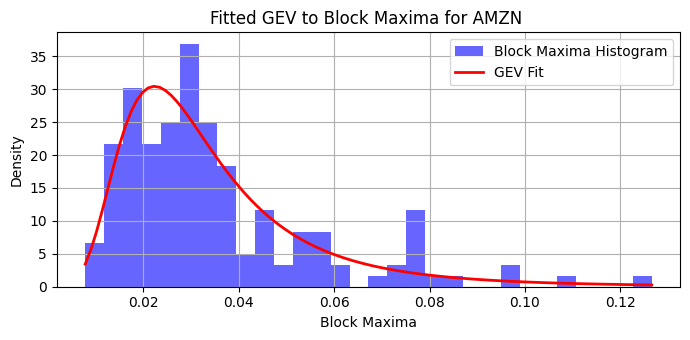


 Finding GEV distribution for DIS...
GEV Parameters: Shape=-0.2816, Scale=0.0092, Loc=0.0188


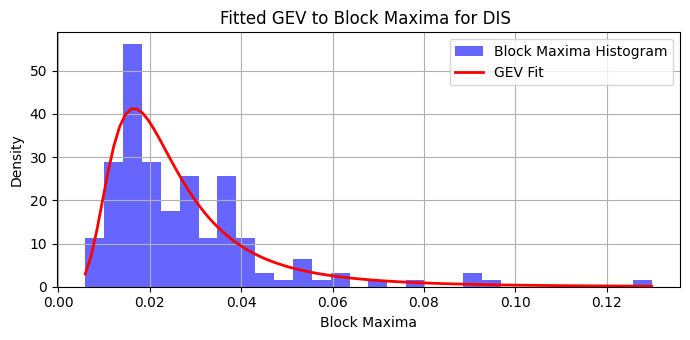


 Finding GEV distribution for AAPL...
GEV Parameters: Shape=-0.1307, Scale=0.0124, Loc=0.0228


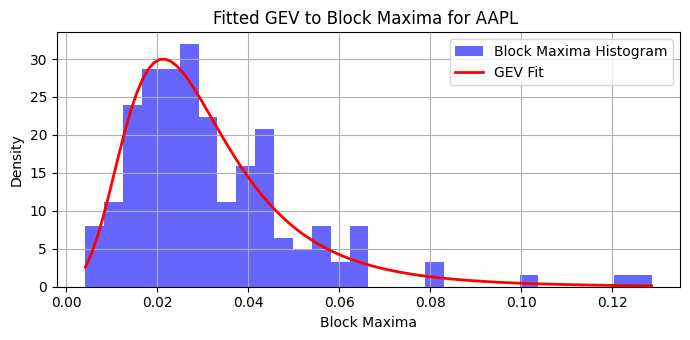


 Finding GEV distribution for MSFT...
GEV Parameters: Shape=-0.9070, Scale=0.0124, Loc=0.0188


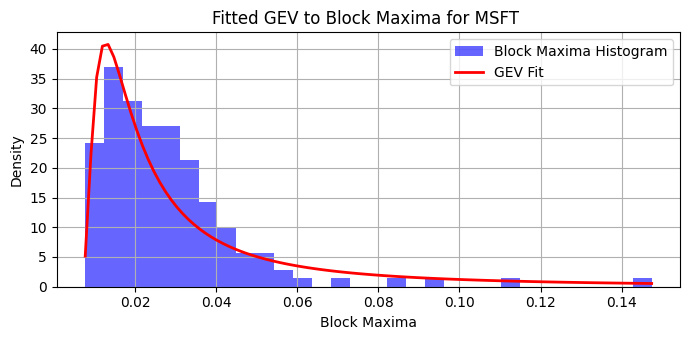


 Finding GEV distribution for JPM...
GEV Parameters: Shape=-0.2266, Scale=0.0108, Loc=0.0208


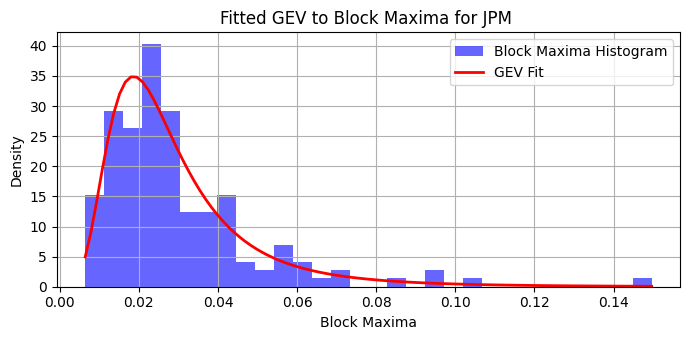


 Finding GEV distribution for F...
GEV Parameters: Shape=-0.1275, Scale=0.0140, Loc=0.0278


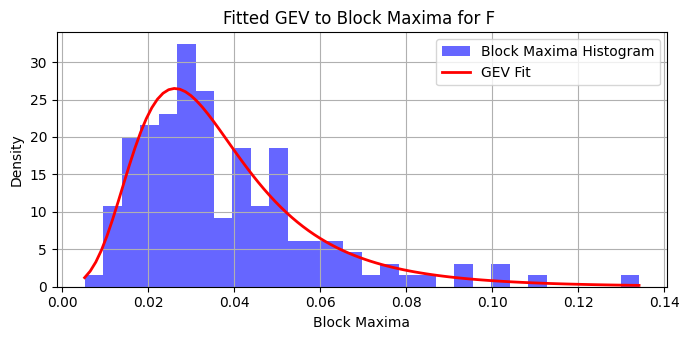


 Finding GEV distribution for PG...
GEV Parameters: Shape=-0.7664, Scale=0.0084, Loc=0.0131


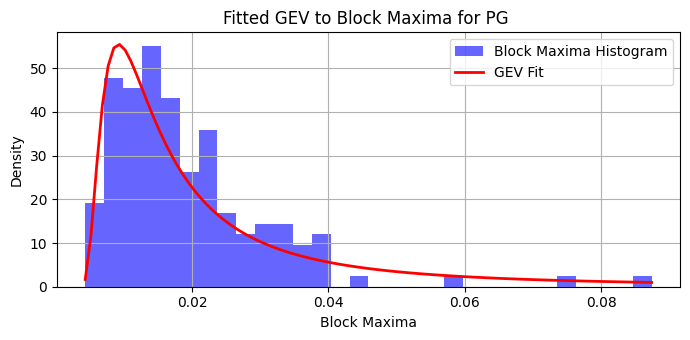


 Finding GEV distribution for ^GSPC...
GEV Parameters: Shape=-0.2276, Scale=0.0072, Loc=0.0125


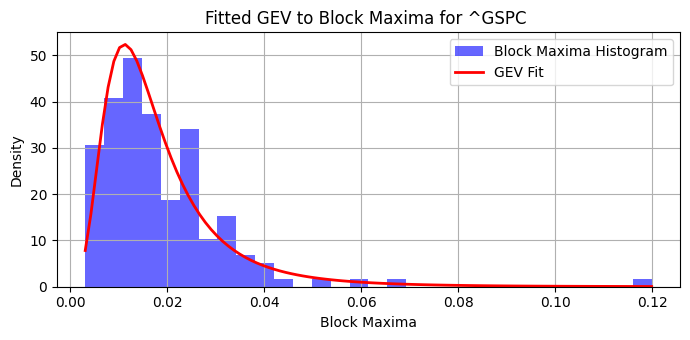


 Finding GEV distribution for ^IXIC...
GEV Parameters: Shape=-0.7680, Scale=0.0096, Loc=0.0145


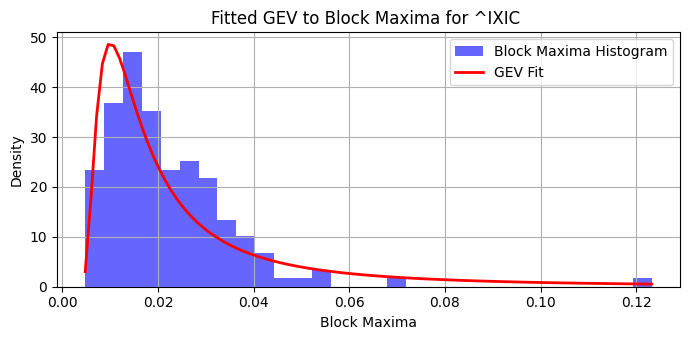

AMZN: Shape=-0.2269, Loc=0.0248, Scale=0.0124
DIS: Shape=-0.2816, Loc=0.0188, Scale=0.0092
AAPL: Shape=-0.1307, Loc=0.0228, Scale=0.0124
MSFT: Shape=-0.9070, Loc=0.0188, Scale=0.0124
JPM: Shape=-0.2266, Loc=0.0208, Scale=0.0108
F: Shape=-0.1275, Loc=0.0278, Scale=0.0140
PG: Shape=-0.7664, Loc=0.0131, Scale=0.0084
^GSPC: Shape=-0.2276, Loc=0.0125, Scale=0.0072
^IXIC: Shape=-0.7680, Loc=0.0145, Scale=0.0096


<ipython-input-7-59c00fe5a11c>:57: RuntimeWarning: invalid value encountered in power
  residuals = (1 + shape * (block_maxima - loc) / scale) ** (-1 / shape)


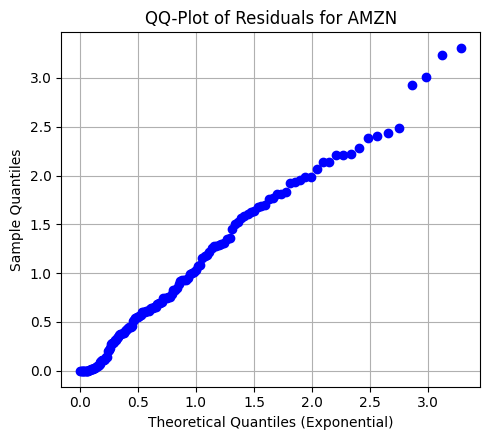

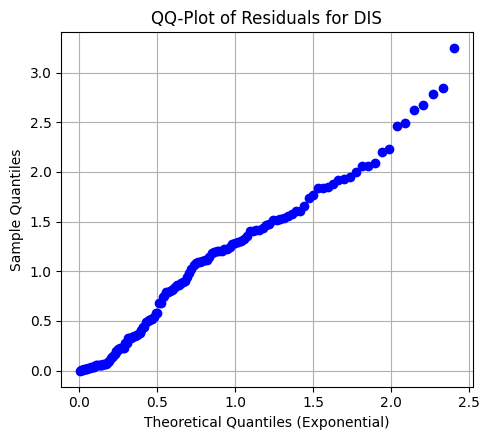

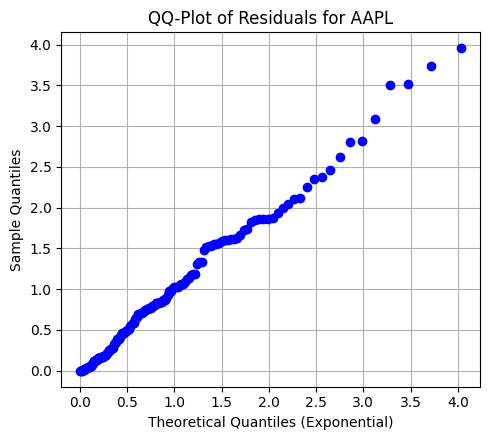

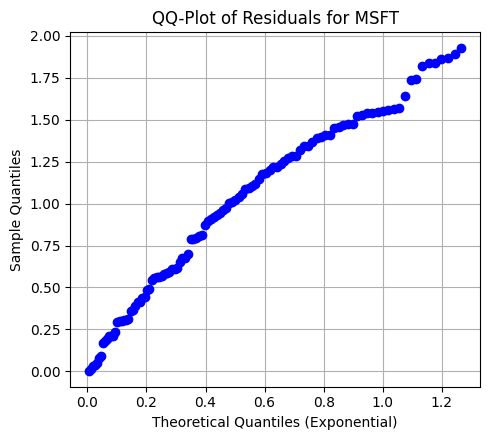

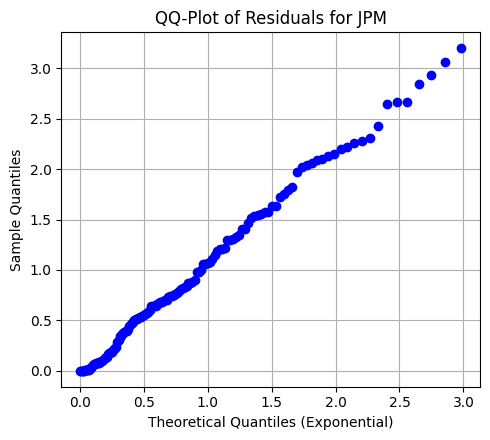

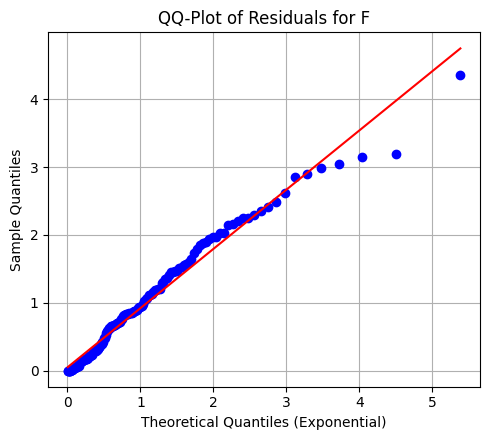

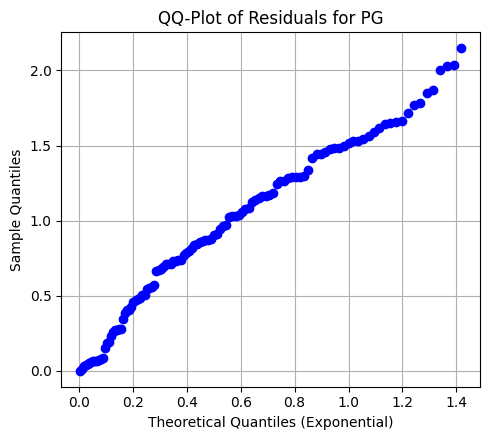

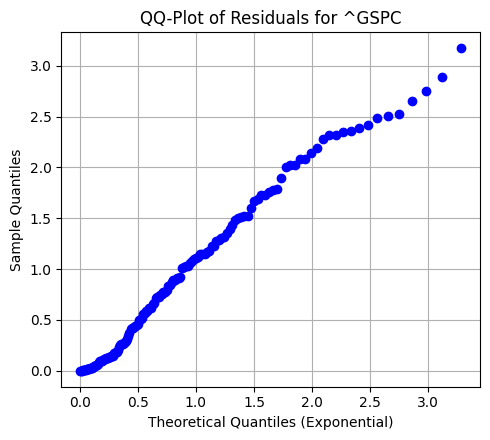

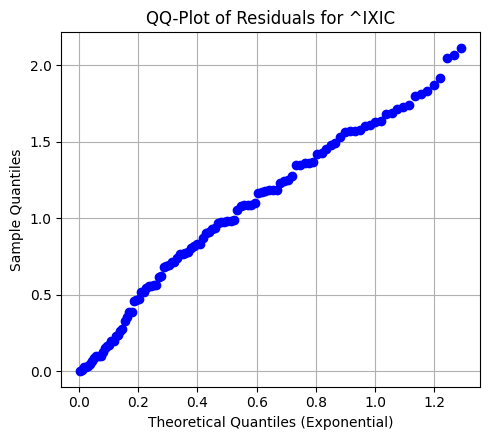

VaR (GEV) for AMZN at 99.0% confidence level: -0.0746
VaR (GEV) for DIS at 99.0% confidence level: -0.0673
VaR (GEV) for AAPL at 99.0% confidence level: -0.0545
VaR (GEV) for MSFT at 99.0% confidence level: -0.8314
VaR (GEV) for JPM at 99.0% confidence level: -0.0657
VaR (GEV) for F at 99.0% confidence level: -0.0591
VaR (GEV) for PG at 99.0% confidence level: -0.3410
VaR (GEV) for ^GSPC at 99.0% confidence level: -0.0453
VaR (GEV) for ^IXIC at 99.0% confidence level: -0.3906


In [ ]:
from scipy.stats import genextreme, genpareto, expon, probplot

def calculate_block_maxima_all_tickers(returns_df, block_size):
    """
    compute block maxima using negative returns.
    block_maxima_dict: dict, block maxima for each ticker
    """
    block_maxima_dict = {}
    for ticker in returns_df.columns:
        returns = -returns_df[ticker].dropna().values  # Use negative returns for losses
        block_maxima = [
            max(returns[i:i + block_size]) for i in range(0, len(returns), block_size)
        ]
        block_maxima_dict[ticker] = np.array(block_maxima)
    return block_maxima_dict

# Calculate block maxima
block_size = 21
block_maxima_dict = calculate_block_maxima_all_tickers(returns_df, block_size)
alpha=0.01
def fit_gev(block_maxima):
    # Adapt Generalized Extreme Value (GEV)  to maxima
    params_gev = genextreme.fit(block_maxima)
    shape, loc, scale = params_gev
    print(f"GEV Parameters: Shape={shape:.4f}, Scale={scale:.4f}, Loc={loc:.4f}")

    plt.figure(figsize=(7, 3.5))
    x = np.linspace(min(block_maxima), max(block_maxima), 100)
    pdf = genextreme.pdf(x, shape, loc=loc, scale=scale)
    plt.hist(block_maxima, bins=30, density=True, alpha=0.6, color='blue', label='Block Maxima Histogram')
    plt.plot(x, pdf, 'r-', lw=2, label='GEV Fit')
    plt.title(f'Fitted GEV to Block Maxima for {ticker} ')
    plt.xlabel('Block Maxima')
    plt.ylabel('Density')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    return params_gev


gev_params_dict = {}

for ticker, block_maxima in block_maxima_dict.items():
    print(f"\n Finding GEV distribution for {ticker}...")
    gev_params_dict[ticker] = fit_gev(block_maxima)

for ticker, params in gev_params_dict.items():
    print(f"{ticker}: Shape={params[0]:.4f}, Loc={params[1]:.4f}, Scale={params[2]:.4f}")


confidence_level = 0.99
var_gev_dict = {}

def calculate_residuals(block_maxima, shape, loc, scale):
    residuals = (1 + shape * (block_maxima - loc) / scale) ** (-1 / shape)
    return residuals

def qq_plot_residuals(residuals, ticker):

    plt.figure(figsize=(5, 4.5))
    probplot(residuals, dist=expon, plot=plt)
    plt.title(f"QQ-Plot of Residuals for {ticker}")
    plt.xlabel("Theoretical Quantiles (Exponential)")
    plt.ylabel("Sample Quantiles")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# compute  and plot residuals for each ticker
for ticker, block_maxima in block_maxima_dict.items():
    shape, loc, scale = gev_params_dict[ticker]
    residuals = calculate_residuals(block_maxima, shape, loc, scale)
    qq_plot_residuals(residuals, ticker)


def calculate_var_gev(shape, loc, scale, block_size, alpha):
    m = block_size
    if shape != 0:
        var = loc - (scale / shape) * (1 - (-m * np.log(1 - alpha)) ** (-shape))
    else:
        var = loc - scale * np.log(-m * np.log(1 - alpha))
    return var

# Calculate and print VaR for each ticker
var_gev_dict = {}


for ticker, params in gev_params_dict.items():
    shape, loc, scale = params
    var_gev = calculate_var_gev(shape, loc, scale, block_size, confidence_level)
    var_gev_dict[ticker] = var_gev
    print(f"VaR (GEV) for {ticker} at {0.99 * 100:.1f}% confidence level: {var_gev:.4f}")

## Extreme value theory - Generalized Pareto Distribution

Processing Pareto for AMZN...
GPD Parameters: Shape=0.2856, Scale=0.0118, Loc=0.0000


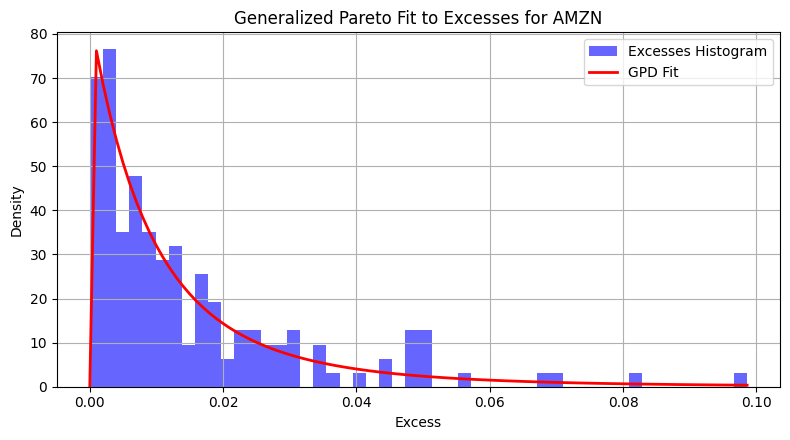

Threshold (u): 0.05241681923553127
Shape (ξ): 0.28561872499192564
Scale (σ): 0.011792719834611845
Loc (μ): 2.6465236356404567e-06
Total Observations (T): 3163
Exceedances (T_u): 40
Calculated VaR: 0.04955326626342445
Pareto VaR for AMZN at 99.0% confidence level: 0.0496


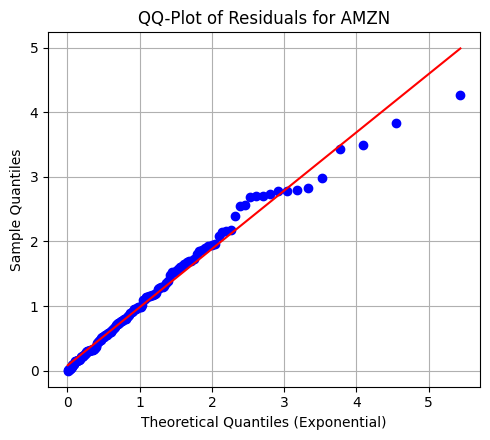

Processing Pareto for DIS...
GPD Parameters: Shape=0.7291, Scale=0.0086, Loc=0.0000


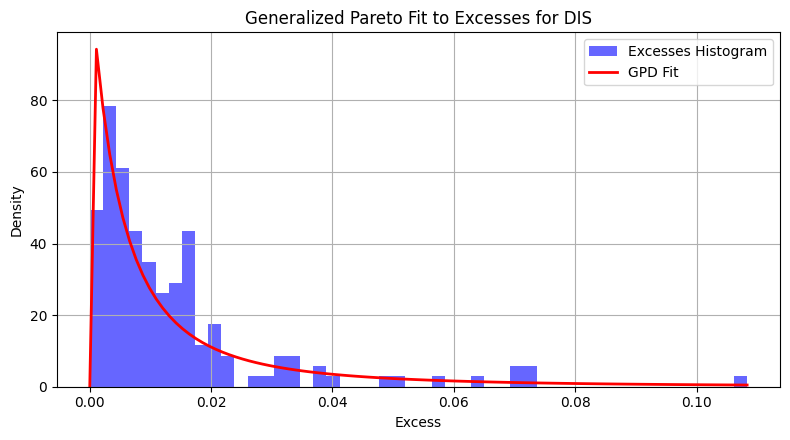

Threshold (u): 0.03928148208753063
Shape (ξ): 0.7291156125278819
Scale (σ): 0.008594580726638365
Loc (μ): 1.0743126217415659e-07
Total Observations (T): 3163
Exceedances (T_u): 49
Calculated VaR: 0.03484990582872926
Pareto VaR for DIS at 99.0% confidence level: 0.0348


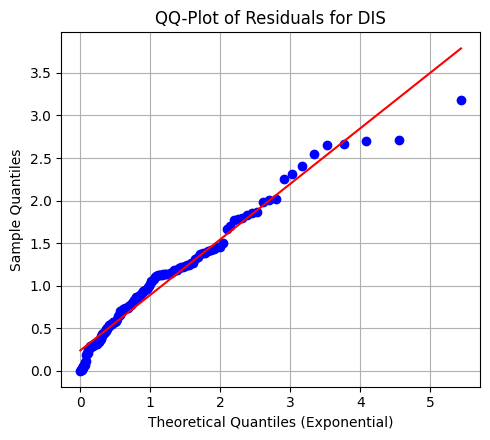

Processing Pareto for AAPL...
GPD Parameters: Shape=0.4448, Scale=0.0094, Loc=0.0000


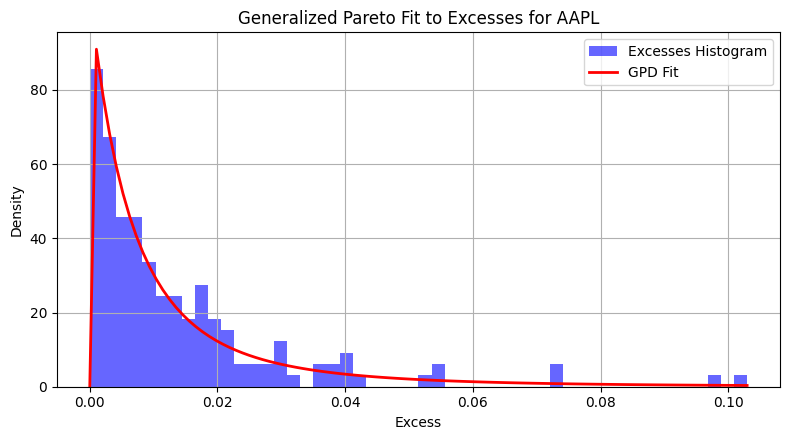

Threshold (u): 0.04578390726296388
Shape (ξ): 0.44480530464701545
Scale (σ): 0.009415032340797486
Loc (μ): 6.930781249198704e-06
Total Observations (T): 3163
Exceedances (T_u): 39
Calculated VaR: 0.0437170912380691
Pareto VaR for AAPL at 99.0% confidence level: 0.0437


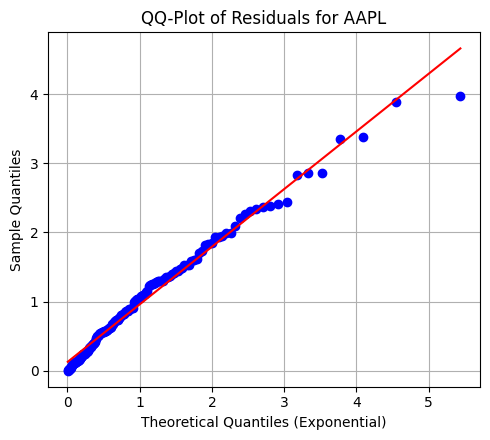

Processing Pareto for MSFT...
GPD Parameters: Shape=0.1954, Scale=0.0101, Loc=0.0000


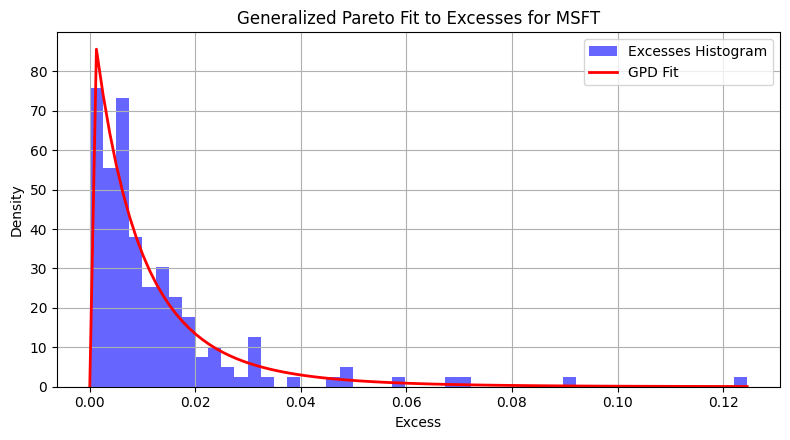

Threshold (u): 0.04029373352431344
Shape (ξ): 0.19535804948712465
Scale (σ): 0.010103799975565732
Loc (μ): 2.0126118069734847e-05
Total Observations (T): 3163
Exceedances (T_u): 38
Calculated VaR: 0.03840626157828301
Pareto VaR for MSFT at 99.0% confidence level: 0.0384


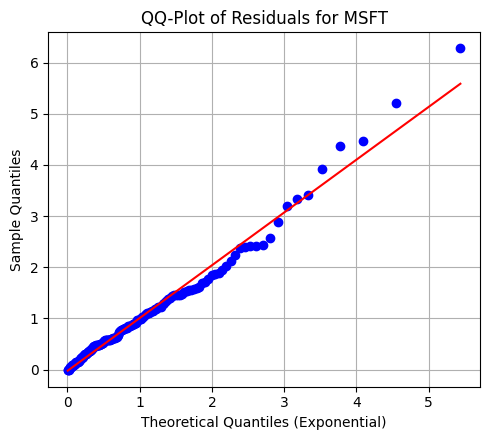

Processing Pareto for JPM...
GPD Parameters: Shape=0.7156, Scale=0.0087, Loc=0.0000


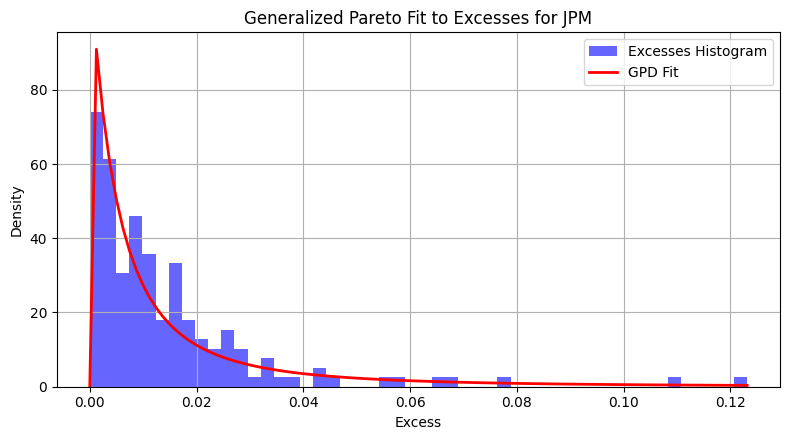

Threshold (u): 0.04802795757246237
Shape (ξ): 0.7155596258876509
Scale (σ): 0.008737910458541082
Loc (μ): 1.4550878711407407e-05
Total Observations (T): 3163
Exceedances (T_u): 35
Calculated VaR: 0.04711048193008102
Pareto VaR for JPM at 99.0% confidence level: 0.0471


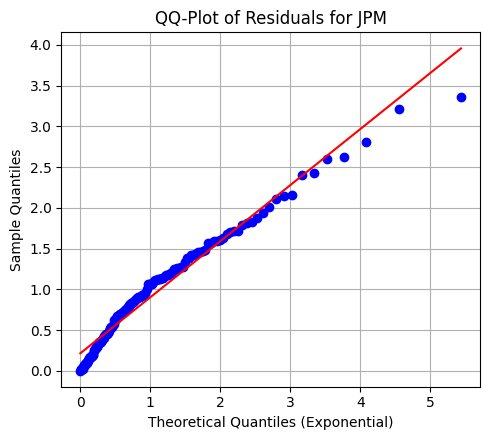

Processing Pareto for F...
GPD Parameters: Shape=0.3339, Scale=0.0121, Loc=0.0000


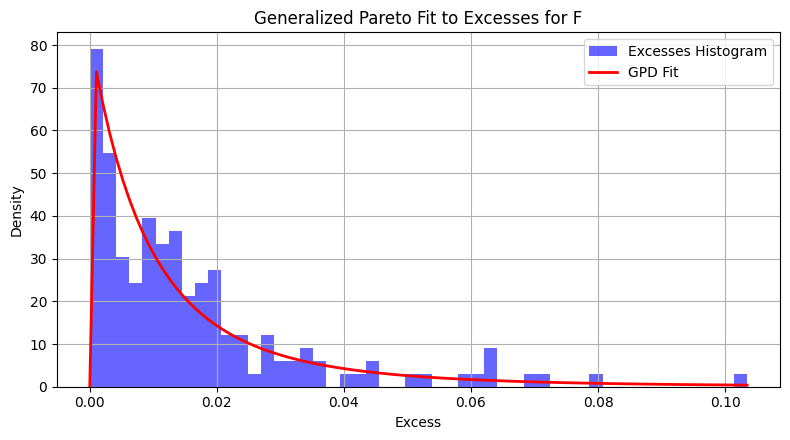

Threshold (u): 0.05358719500870603
Shape (ξ): 0.33385495589365644
Scale (σ): 0.012110288892660807
Loc (μ): 8.187320597413624e-06
Total Observations (T): 3163
Exceedances (T_u): 42
Calculated VaR: 0.04998535634247997
Pareto VaR for F at 99.0% confidence level: 0.0500


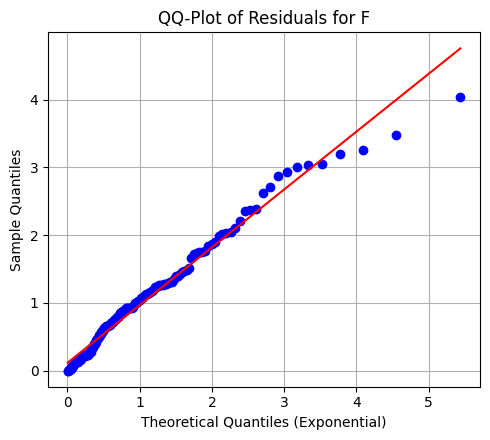

Processing Pareto for PG...
GPD Parameters: Shape=0.4560, Scale=0.0066, Loc=0.0000


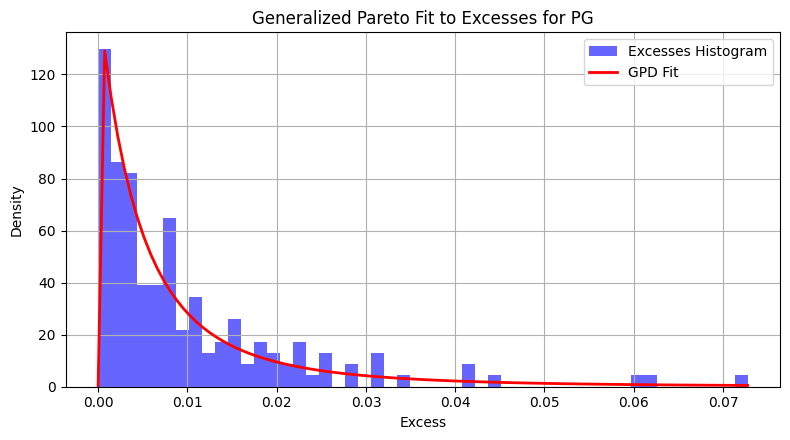

Threshold (u): 0.030028051002842306
Shape (ξ): 0.4560356077902169
Scale (σ): 0.006619534077409795
Loc (μ): 2.175469716996994e-07
Total Observations (T): 3163
Exceedances (T_u): 32
Calculated VaR: 0.029950862202375257
Pareto VaR for PG at 99.0% confidence level: 0.0300


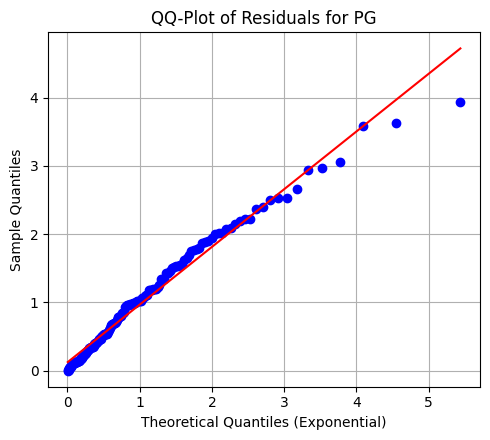

Processing Pareto for ^GSPC...
GPD Parameters: Shape=0.5198, Scale=0.0067, Loc=0.0000


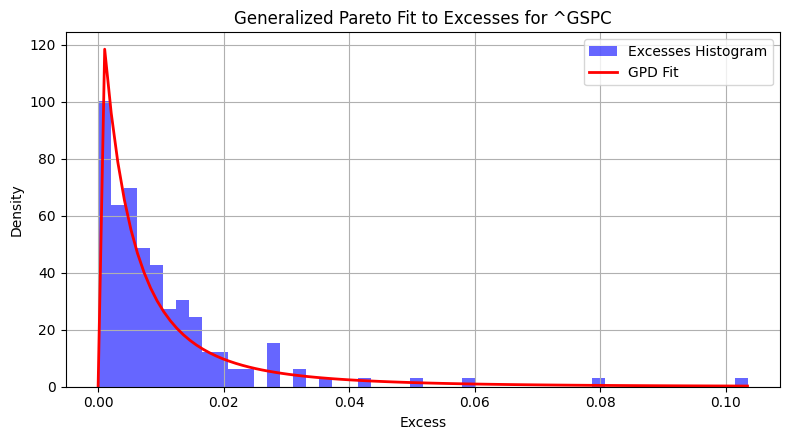

Threshold (u): 0.03092241614963314
Shape (ξ): 0.519753297126305
Scale (σ): 0.0067316873812734886
Loc (μ): 2.1102146767779972e-06
Total Observations (T): 3163
Exceedances (T_u): 23
Calculated VaR: 0.032899032877509
Pareto VaR for ^GSPC at 99.0% confidence level: 0.0329


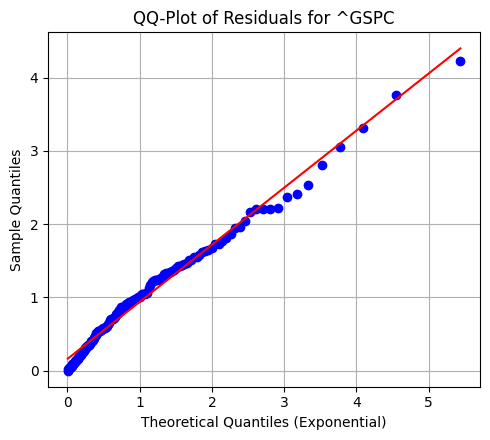

Processing Pareto for ^IXIC...
GPD Parameters: Shape=0.7938, Scale=0.0062, Loc=0.0000


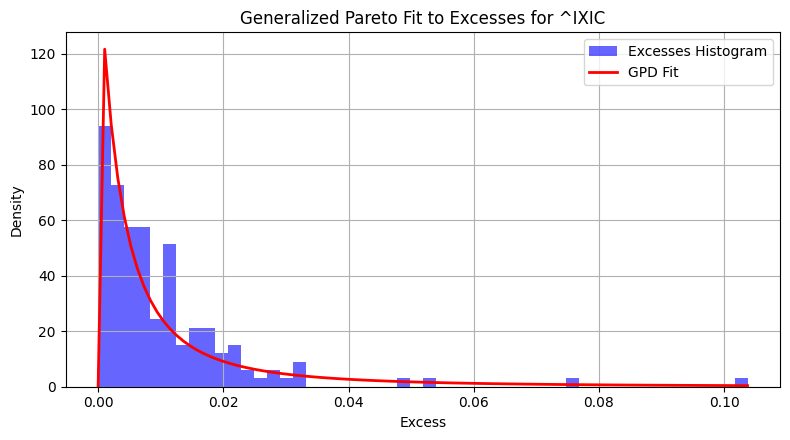

Threshold (u): 0.03474200099875717
Shape (ξ): 0.7937857723113808
Scale (σ): 0.00618154889526904
Loc (μ): 2.4874577077430515e-06
Total Observations (T): 3163
Exceedances (T_u): 25
Calculated VaR: 0.03606840212243023
Pareto VaR for ^IXIC at 99.0% confidence level: 0.0361


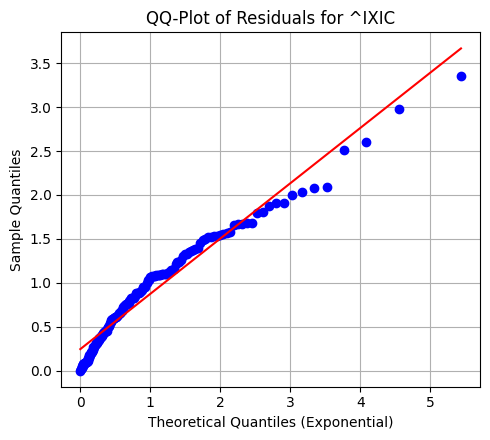

In [ ]:
from scipy.stats import pareto, probplot, genpareto
from scipy.stats import linregress


def fit_generalized_pareto_with_percentile(returns):
    """
    fits a Generalized Pareto Distribution to exceedances above the 95th percentile threshold. (python function)
    Returns:
    params_gpd: tuple, fitted GPD parameters (shape, loc, scale)
    excesses: array, exceedances above the threshold
    """
    losses = -returns
    threshold = np.percentile(losses, 95)
    excesses = losses[losses > threshold] - threshold

    # fit of Generalized Pareto Distribution
    params_gpd = genpareto.fit(excesses)
    shape, loc, scale = params_gpd
    print(f"GPD Parameters: Shape={shape:.4f}, Scale={scale:.4f}, Loc={loc:.4f}")

    # Plot of  fit GPD
    plt.figure(figsize=(8, 4.5))
    x = np.linspace(0, max(excesses), 100)
    pdf = genpareto.pdf(x, shape, loc=loc, scale=scale)

    plt.hist(excesses, bins=50, density=True, alpha=0.6, color='blue', label='Excesses Histogram')
    plt.plot(x, pdf, 'r-', lw=2, label='GPD Fit')
    plt.title(f"Generalized Pareto Fit to Excesses for {ticker}")
    plt.xlabel("Excess")
    plt.ylabel("Density")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    return params_gpd, excesses


# Calculate Generalized Residuals
def calculate_residuals_gpd(excesses, params_pareto, threshold):

    shape, loc, scale = params_pareto
    residuals = (1 / shape) * np.log(1 + (shape * excesses) /(scale))
    return residuals

def qq_plot_residuals(residuals, ticker):

    plt.figure(figsize=(5, 4.5))
    probplot(residuals, dist=expon, plot=plt)
    plt.title(f"QQ-Plot of Residuals for {ticker}")
    plt.xlabel("Theoretical Quantiles (Exponential)")
    plt.ylabel("Sample Quantiles")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


def var_pareto_gpd(returns, threshold, shape, scale, loc, confidence_level):

    T = len(returns)

    excesses = returns[returns > threshold]
    Tu = len(excesses)  # Number of exceedances

    print(f"Threshold (u): {threshold}")
    print(f"Shape (ξ): {shape}")
    print(f"Scale (σ): {scale}")
    print(f"Loc (μ): {loc}")
    print(f"Total Observations (T): {T}")
    print(f"Exceedances (T_u): {Tu}")

    alpha = 1 - confidence_level
    if Tu == 0:
        raise ValueError("No exceedances found. Adjust the threshold.")

    if shape != 0:
        var = threshold + (scale / shape) * (1 - ((T / Tu * alpha) ** (-shape)))

    else:  # limit case for  shape = 0
        var = threshold - scale - np.log(T / Tu * alpha)

    print(f"Calculated VaR: {var}")
    return var


confidence_level = 0.99
pareto_params_dict = {}
for ticker in tickers:
    print(f"Processing Pareto for {ticker}...")
    returns = returns_df[ticker].dropna().values

    #threshold = plot_mrl(returns, ticker)
    #print(f"Selected threshold for {ticker}: {threshold:.4f}")

    params_pareto, excesses = fit_generalized_pareto_with_percentile(returns)
    losses = -returns
    threshold = np.percentile(losses, 99)
    pareto_params_dict[ticker] = params_pareto

    shape, loc, scale = params_pareto
    T = len(returns)

    Tu = len(excesses)
    alpha= 1 - confidence_level
    var = var_pareto_gpd(returns, threshold, shape, scale, loc, confidence_level)
    print(f"Pareto VaR for {ticker} at {confidence_level * 100:.1f}% confidence level: {var:.4f}")

     # Calculate and plot residuals
    residuals = calculate_residuals_gpd(excesses, params_pareto, threshold)
    qq_plot_residuals(residuals, ticker)


## Filtered historical simulation first garch(1,1) and then egarch


Simulating returns for AMZN...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004112. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


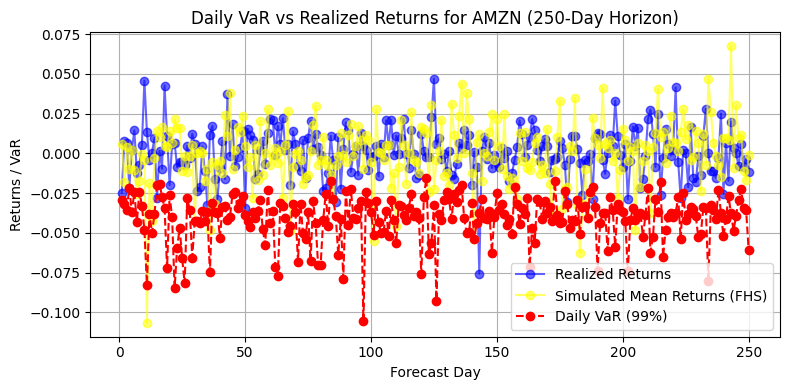

FHS VaR (99%) for AMZN: -0.23428


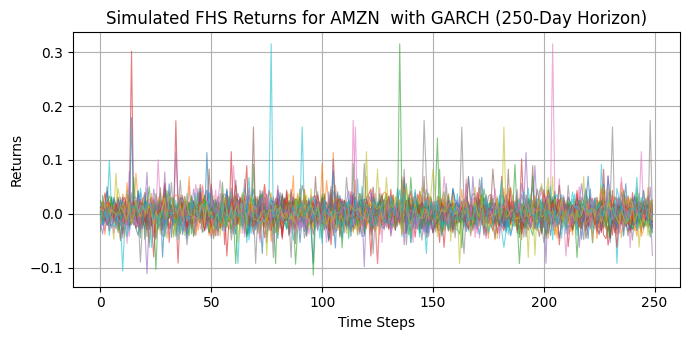

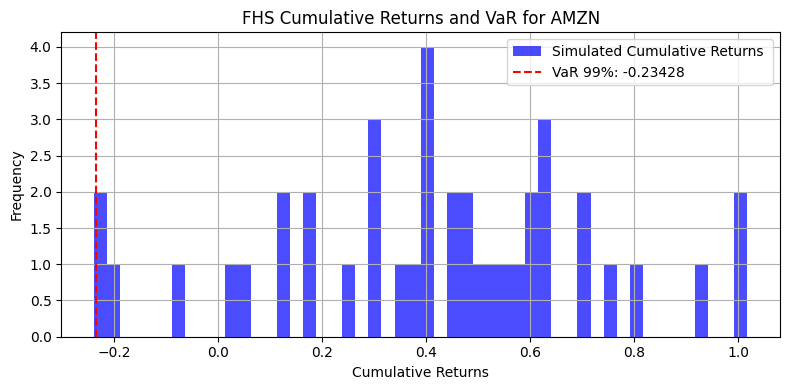


Simulating returns for DIS...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002492. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


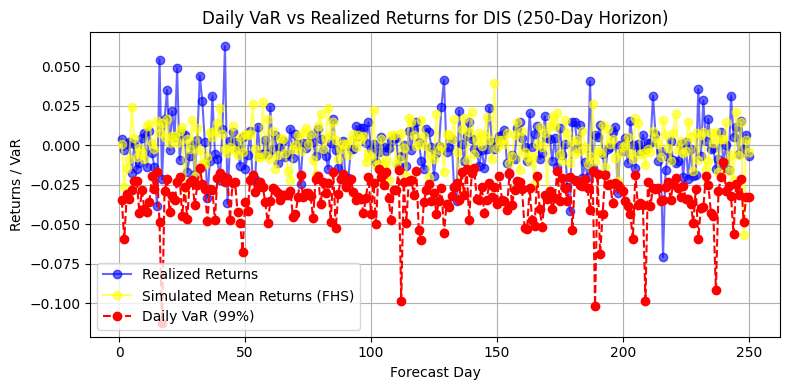

FHS VaR (99%) for DIS: -0.33067


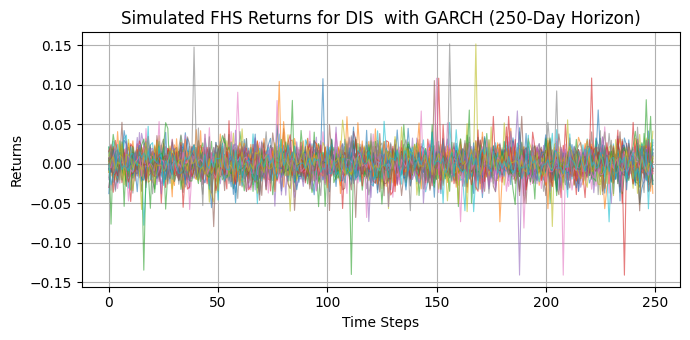

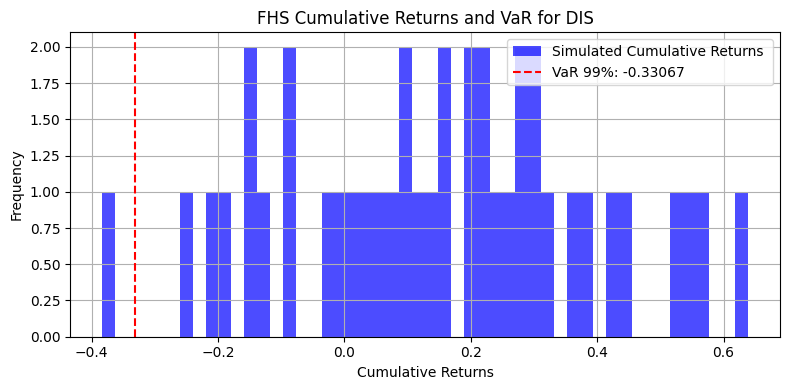


Simulating returns for AAPL...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003093. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


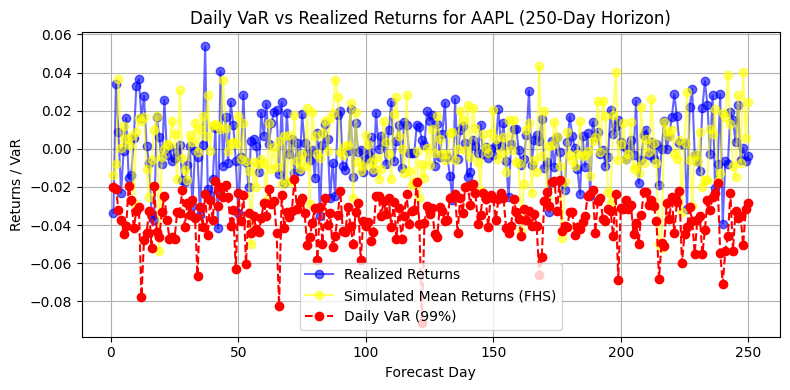

FHS VaR (99%) for AAPL: -0.10885


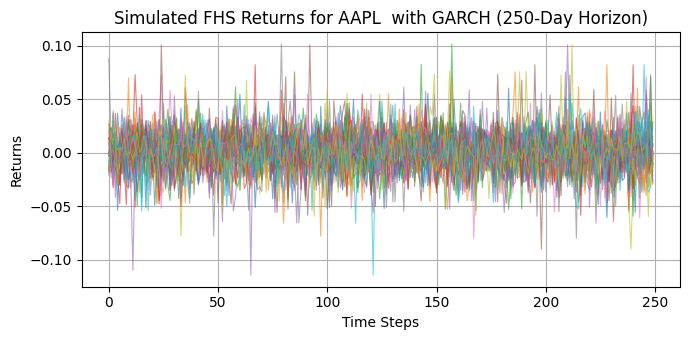

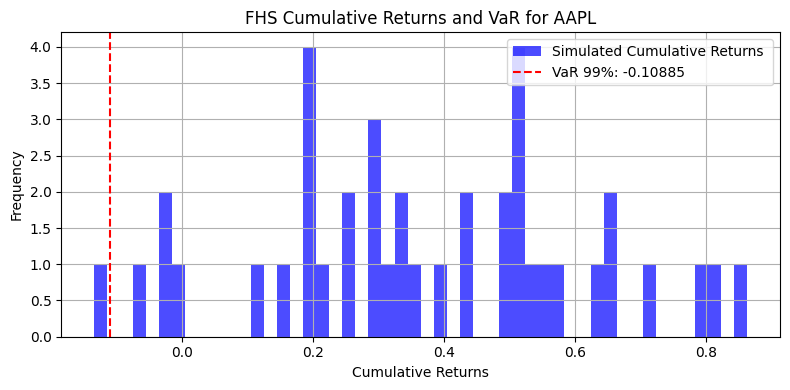


Simulating returns for MSFT...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002487. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


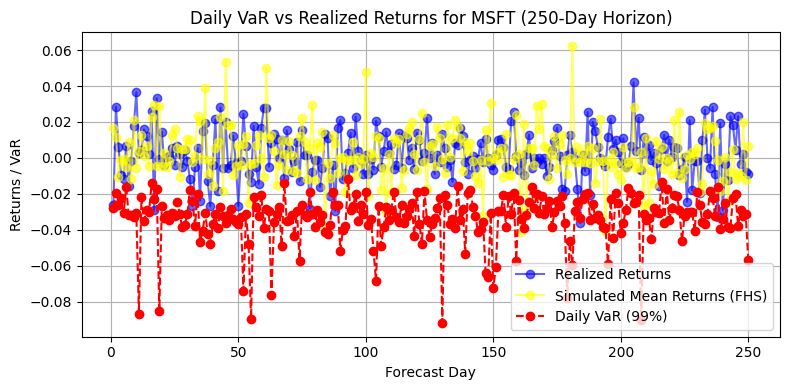

FHS VaR (99%) for MSFT: -0.33419


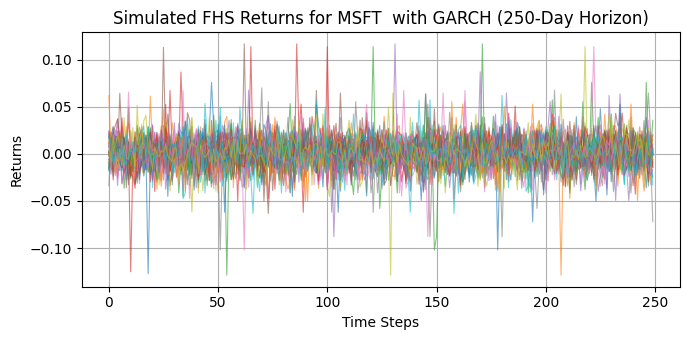

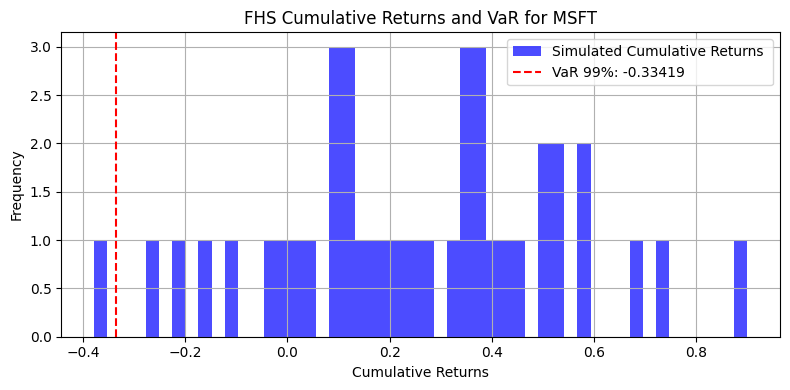


Simulating returns for JPM...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003282. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


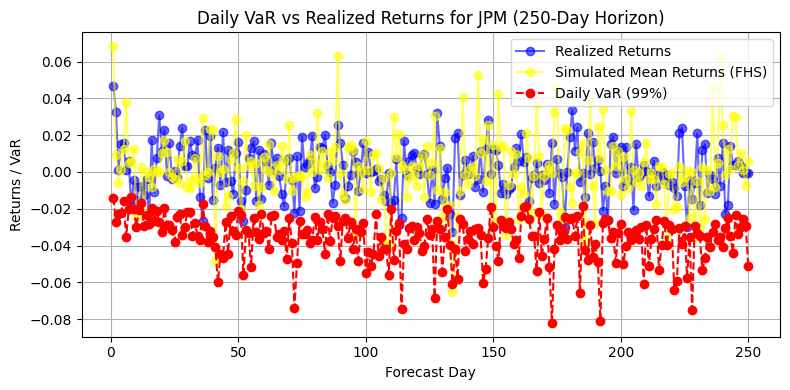

FHS VaR (99%) for JPM: -0.34957


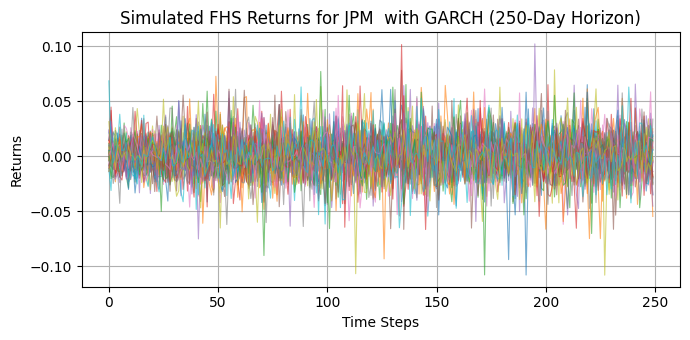

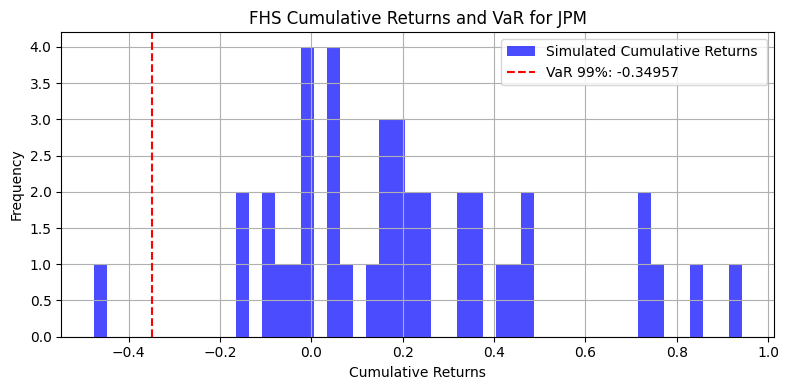


Simulating returns for F...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004342. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


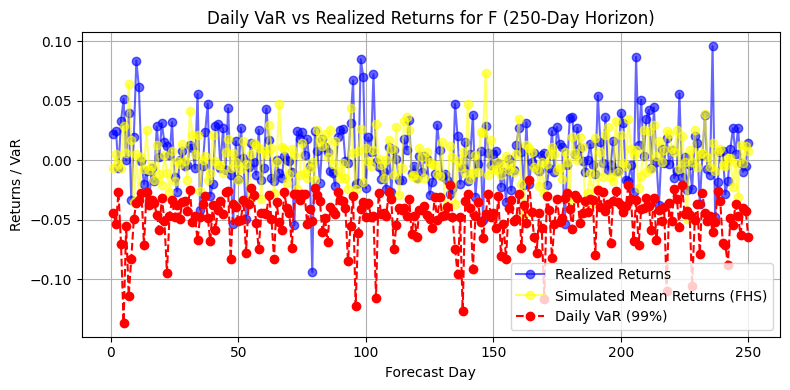

FHS VaR (99%) for F: -0.74239


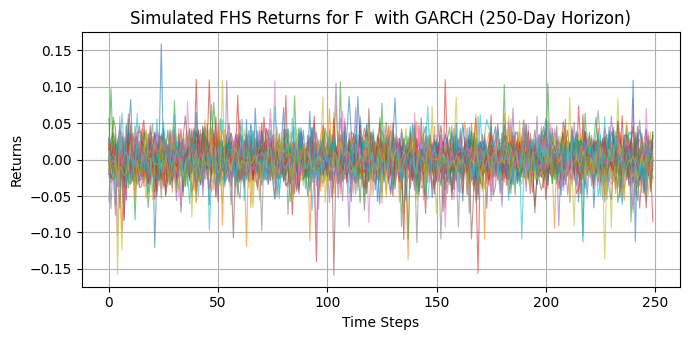

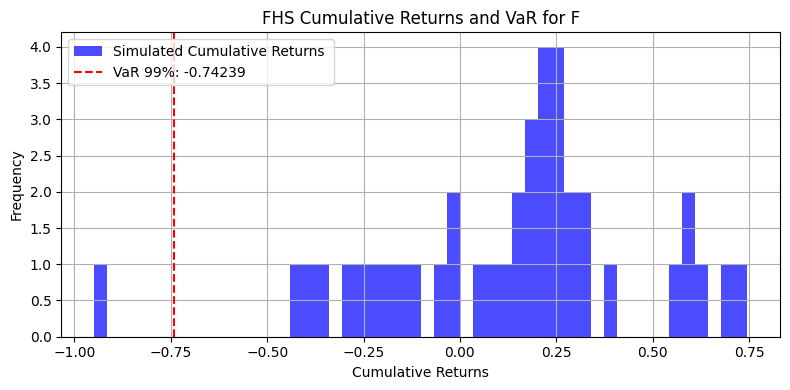


Simulating returns for PG...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001153. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


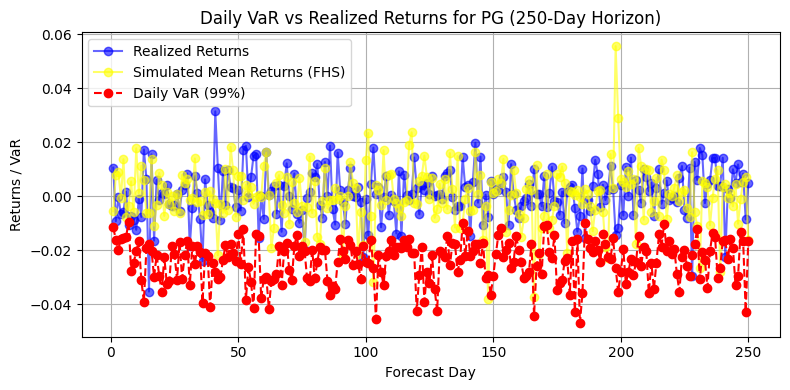

FHS VaR (99%) for PG: -0.17536


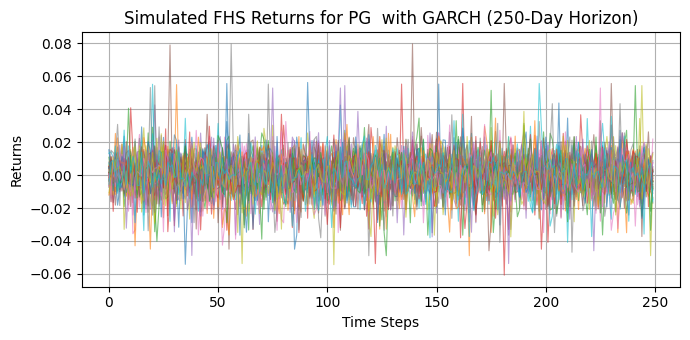

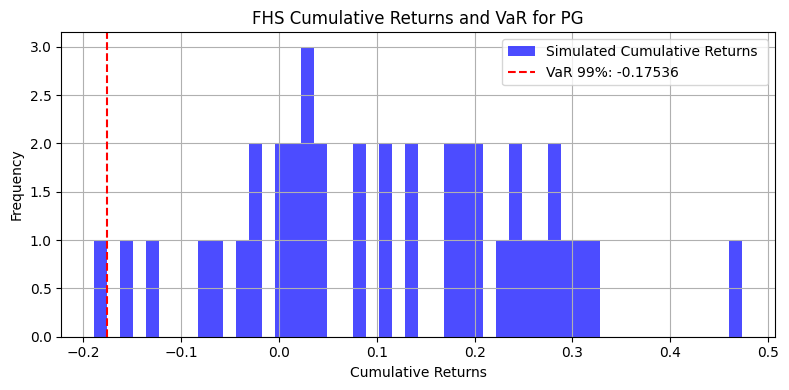


Simulating returns for ^GSPC...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001171. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


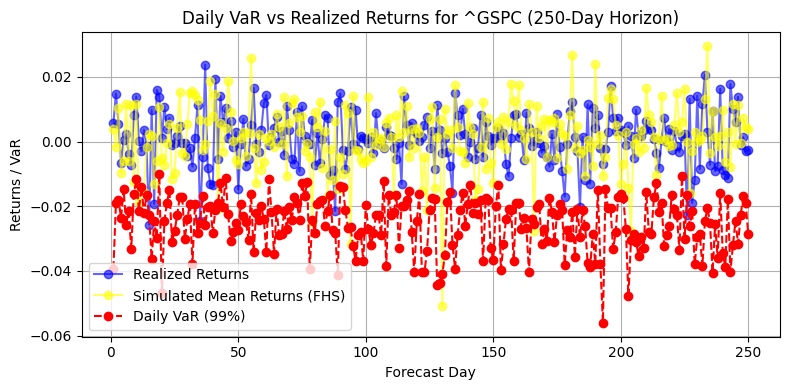

FHS VaR (99%) for ^GSPC: -0.24314


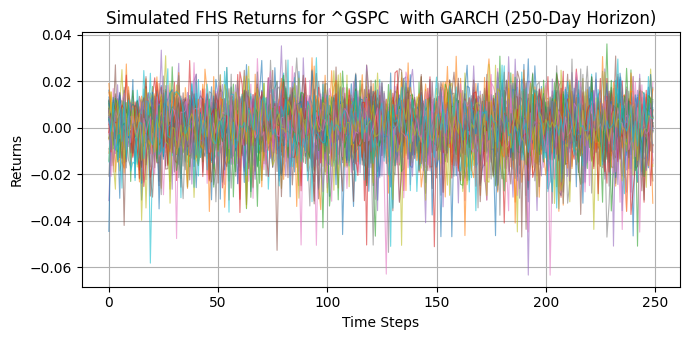

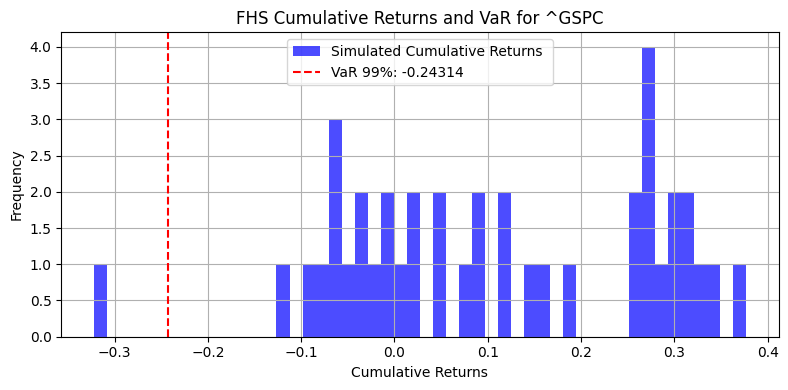


Simulating returns for ^IXIC...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001478. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


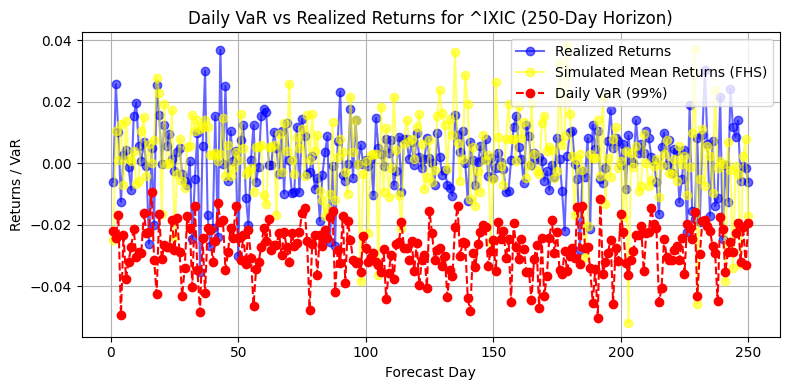

FHS VaR (99%) for ^IXIC: -0.13050


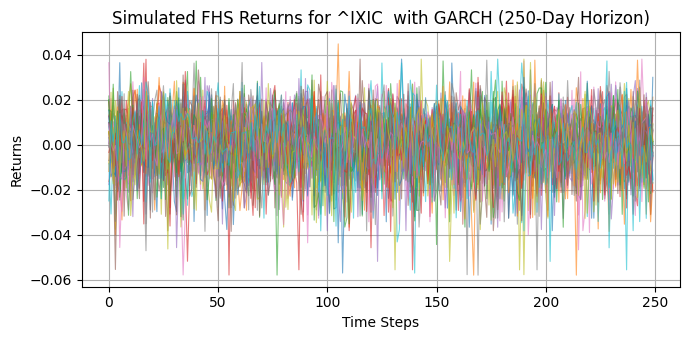

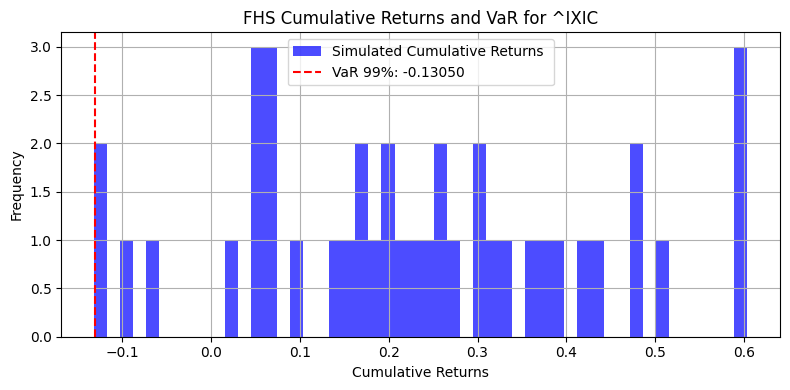


Simulating returns for AMZN with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004112. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


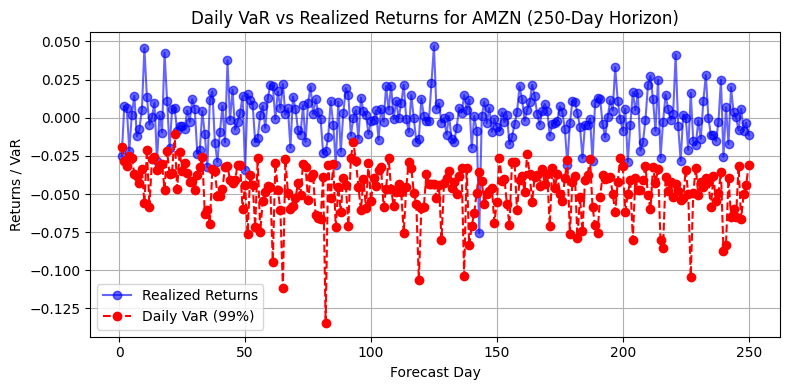

FHS VaR (99%) for AMZN: -0.13050
FHS VaR (99%) for AMZN: -0.01061


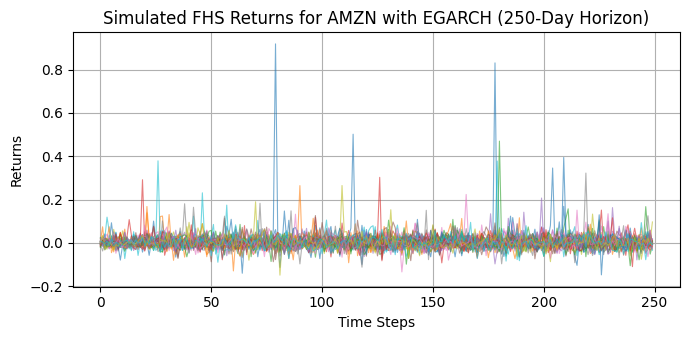

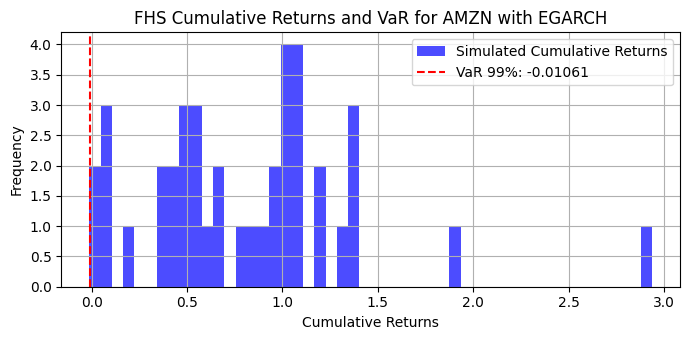


Simulating returns for DIS with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002492. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


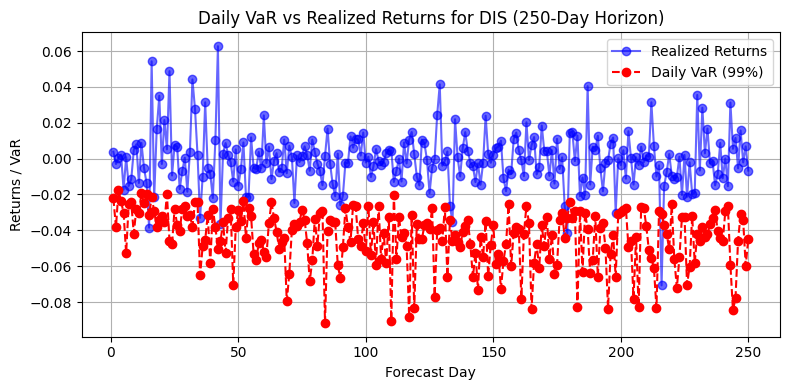

FHS VaR (99%) for DIS: -0.01061
FHS VaR (99%) for DIS: -0.09950


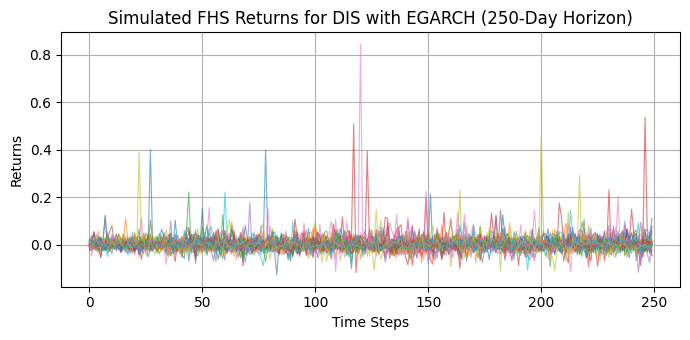

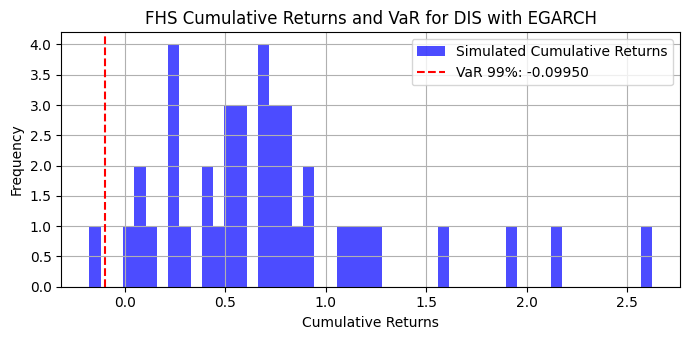


Simulating returns for AAPL with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003093. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


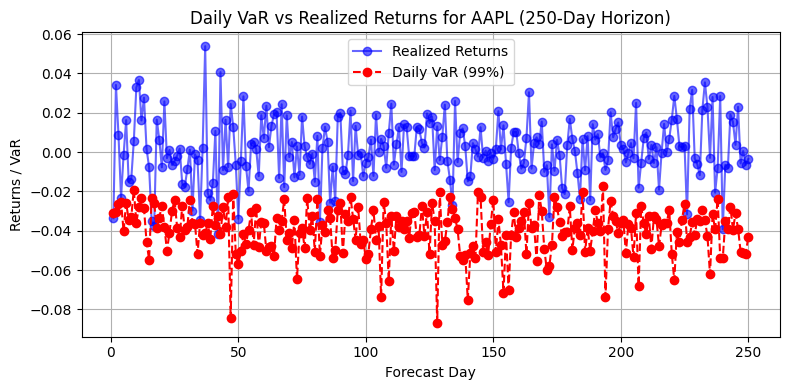

FHS VaR (99%) for AAPL: -0.09950
FHS VaR (99%) for AAPL: 0.36902


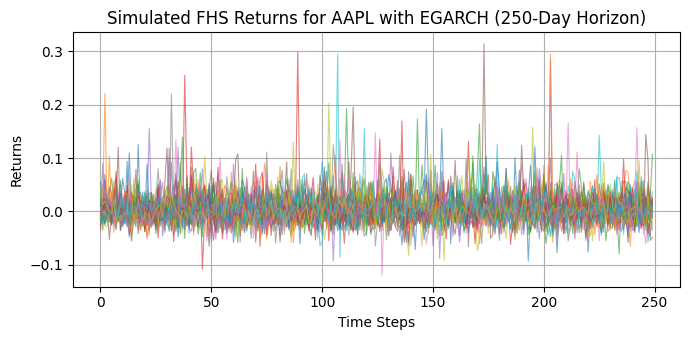

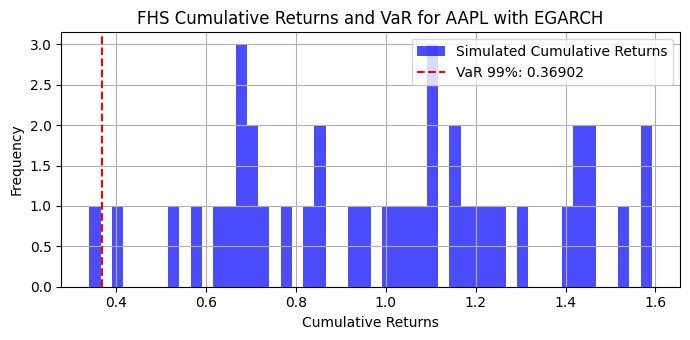


Simulating returns for MSFT with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002487. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


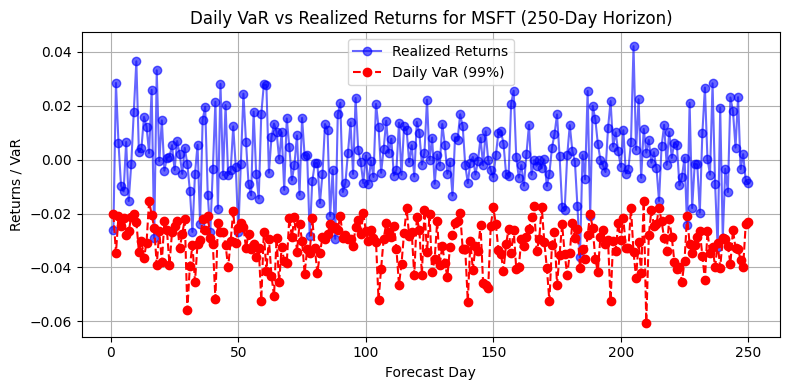

FHS VaR (99%) for MSFT: 0.36902
FHS VaR (99%) for MSFT: 0.20202


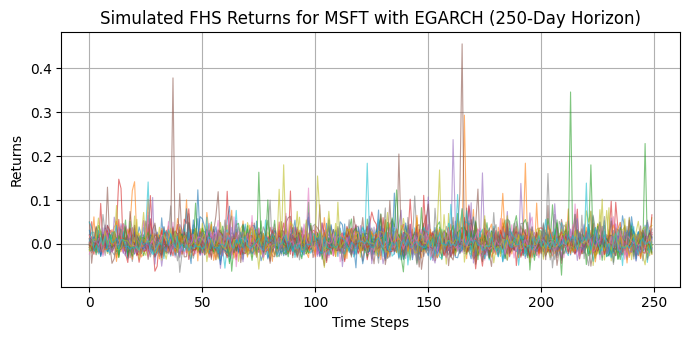

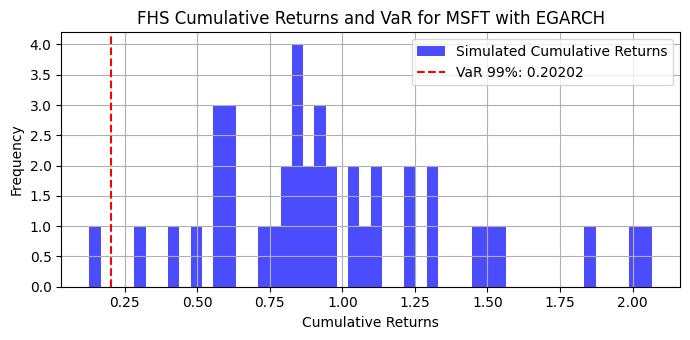


Simulating returns for JPM with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003282. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


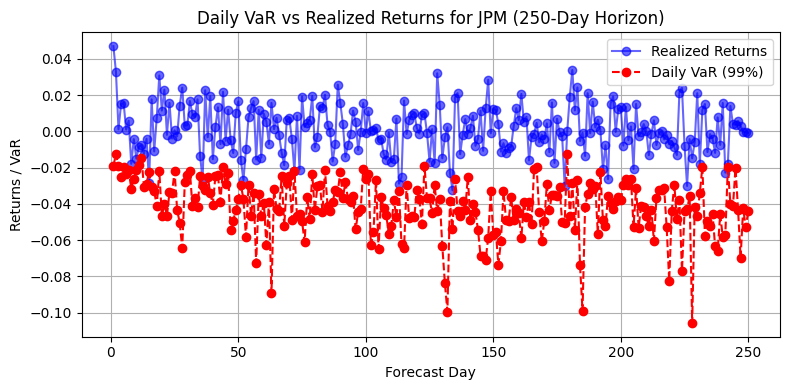

FHS VaR (99%) for JPM: 0.20202
FHS VaR (99%) for JPM: 0.04154


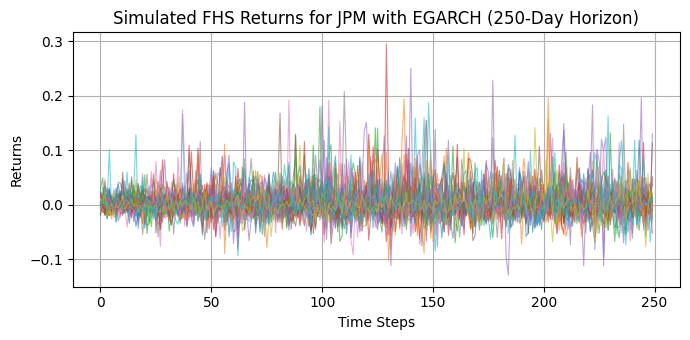

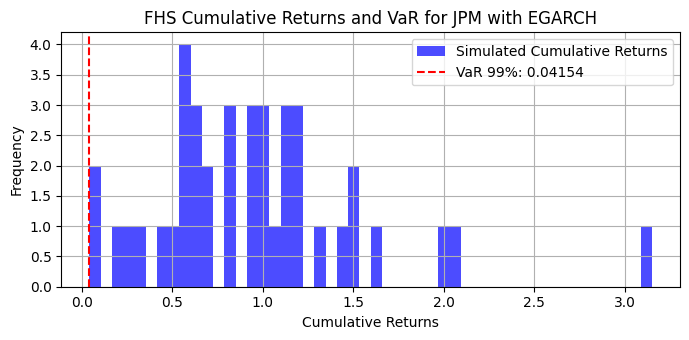


Simulating returns for F with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004342. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


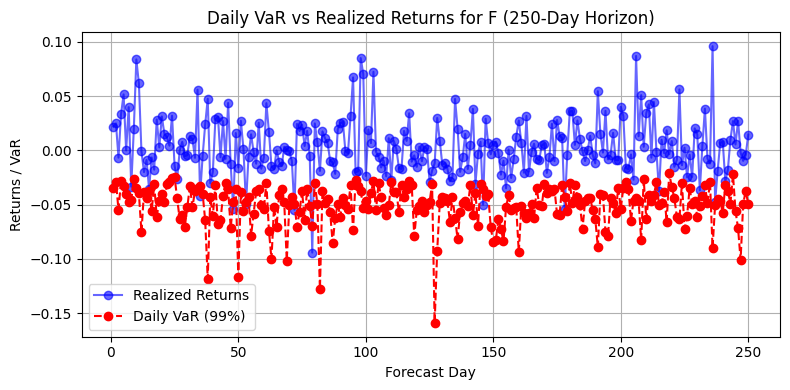

FHS VaR (99%) for F: 0.04154
FHS VaR (99%) for F: -0.17023


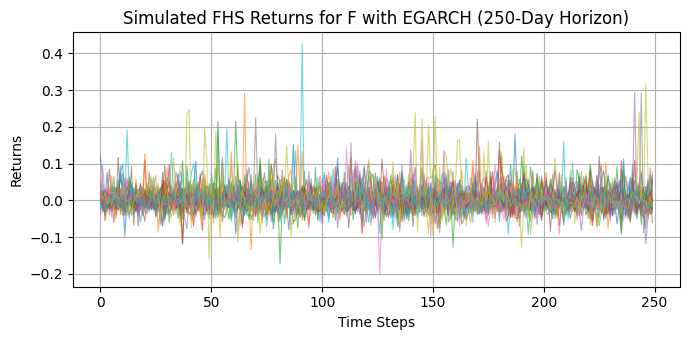

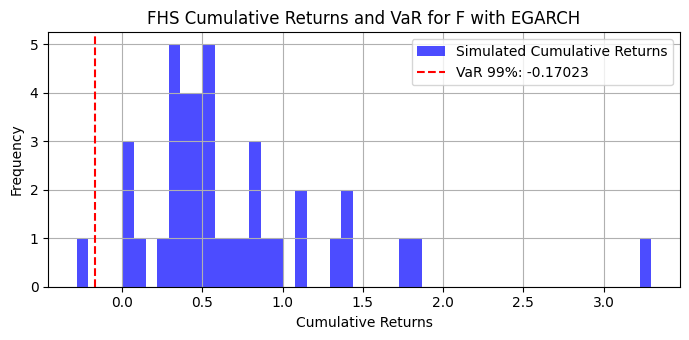


Simulating returns for PG with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001153. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


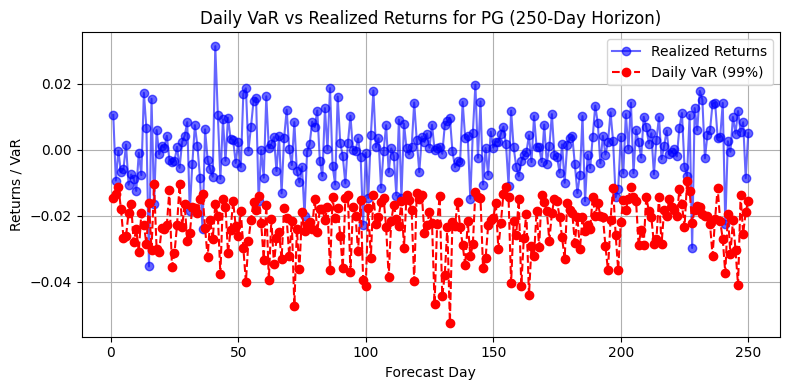

FHS VaR (99%) for PG: -0.17023
FHS VaR (99%) for PG: 0.18791


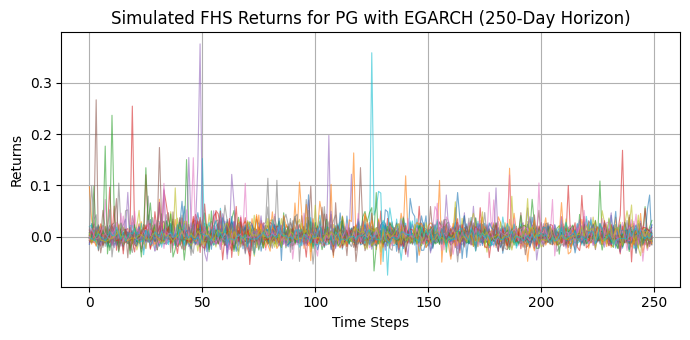

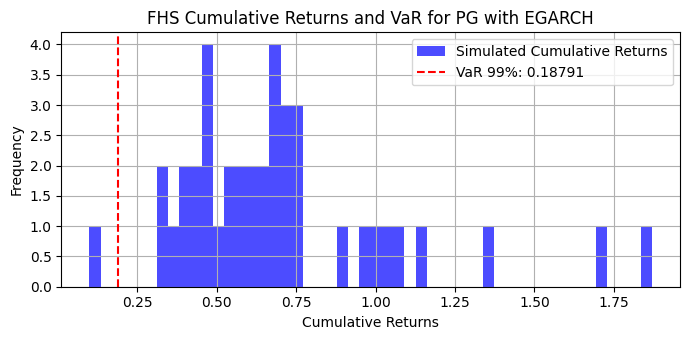


Simulating returns for ^GSPC with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001171. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


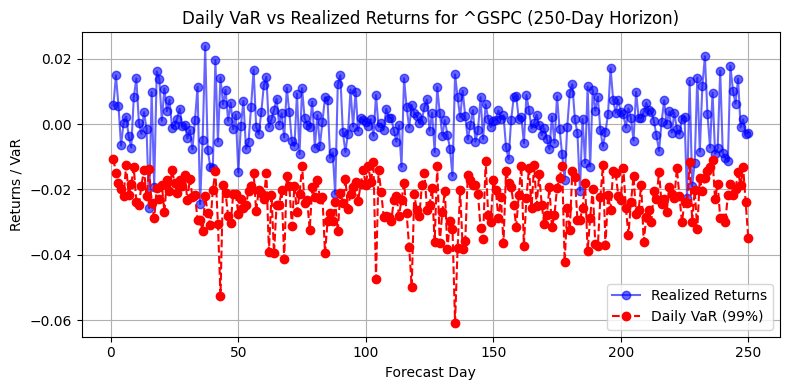

FHS VaR (99%) for ^GSPC: 0.18791
FHS VaR (99%) for ^GSPC: 0.22232


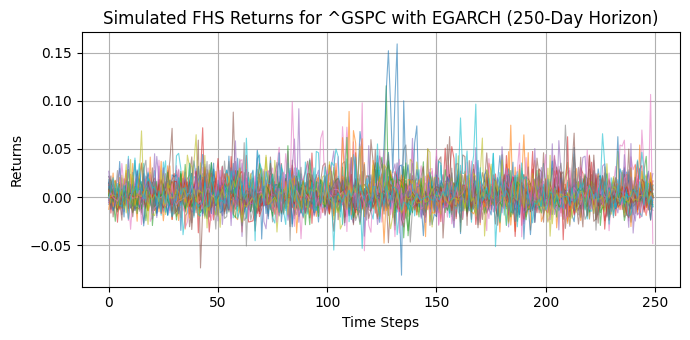

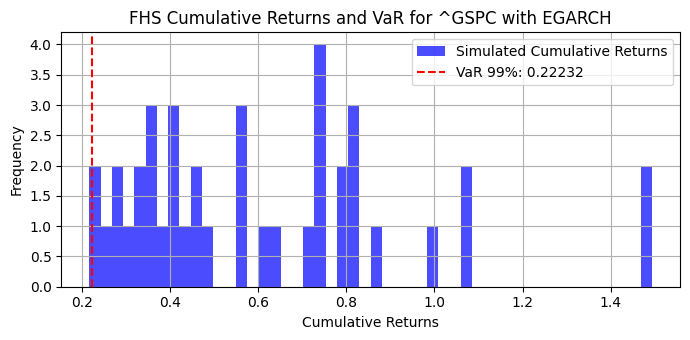


Simulating returns for ^IXIC with EGARCH...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001478. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


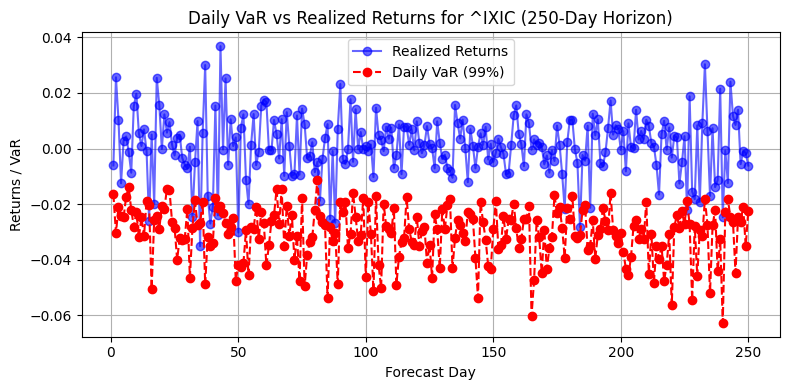

FHS VaR (99%) for ^IXIC: 0.22232
FHS VaR (99%) for ^IXIC: 0.29614


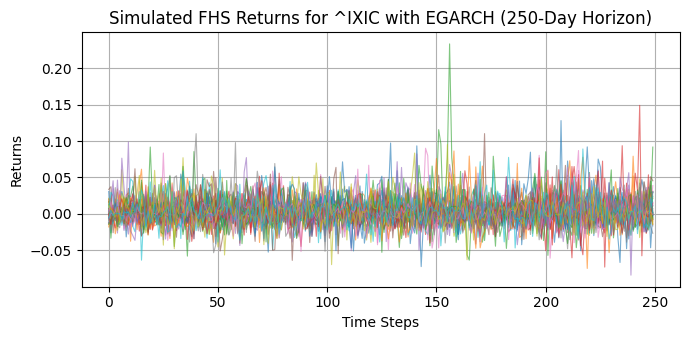

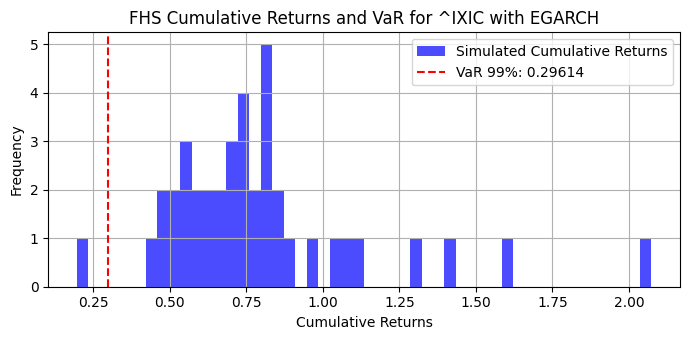

In [ ]:

n_simulations = 40  # Number of simulations
forecast_horizon = 250 # Time horizon
tickers = returns_df.columns
confidence_level = 0.99

for ticker in tickers:
    print(f"\nSimulating returns for {ticker}...")
    returns = returns_df[ticker].dropna()

    model = arch_model(returns, mean='Zero', vol='Garch', p=1, q=1)
    res = model.fit(disp='off')

    #  Extract standardized residuals and forecast volatility
    z = res.std_resid.dropna()
    forecasts = res.forecast(horizon=forecast_horizon, reindex=False)
    forecasted_variances = forecasts.variance.values[-1, :]  # Multi-step ahead variances
    forecasted_stds = np.sqrt(forecasted_variances)

    #  simulate future returns
    all_simulated_paths = np.zeros((forecast_horizon, n_simulations)) #matrix
    for sim in range(n_simulations):
        # Bootstrap from standardized residuals
        sampled_residuals = np.random.choice(z, size=forecast_horizon, replace=True)
        # scale residuals by forecasted volatility
        simulated_returns = sampled_residuals * forecasted_stds
        all_simulated_paths[:, sim] = simulated_returns #filling matrix with the  simulation (row)

    daily_VaRs = np.percentile(all_simulated_paths, (1 - confidence_level) * 100, axis=1)

    # Plot daily VaRs
    # plt.figure(figsize=(8, 4))
    # plt.plot(range(1, forecast_horizon + 1), daily_VaRs, marker='o', label='Daily VaR')
    # plt.title(f"Daily VaR Evolution for {ticker} ({forecast_horizon}-Day Horizon)")
    # plt.xlabel("Forecast Day")
    # plt.ylabel("Value-at-Risk")
    # plt.grid(True)
    # plt.legend()
    # plt.tight_layout()
    # plt.show()


    # Plot daily VaRs with realized returns
    plt.figure(figsize=(8, 4))
    realized_returns = returns_df[ticker].iloc[-forecast_horizon:].values
    plt.plot(range(1, forecast_horizon + 1), realized_returns, marker='o', linestyle='-', color='blue', alpha=0.6, label="Realized Returns")
    plt.plot(range(1, forecast_horizon + 1), simulated_returns, marker='o', linestyle='-', color='yellow', alpha=0.6, label="Simulated Mean Returns (FHS)")

    plt.plot(range(1, forecast_horizon + 1), daily_VaRs, marker='o', linestyle='--', color='red', label='Daily VaR (99%)')
    plt.title(f"Daily VaR vs Realized Returns for {ticker} ({forecast_horizon}-Day Horizon)")
    plt.xlabel("Forecast Day")
    plt.ylabel("Returns / VaR")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


   # print(f"FHS VaR ({int(confidence_level * 100)}%) for {ticker}: {daily_VaRs:.5f}")

    #  Compute VaR for the last forecast horizon
    cumulative_returns = all_simulated_paths.sum(axis=0)
    VaR = np.percentile(cumulative_returns, (1 - confidence_level) * 100)

    print(f"FHS VaR ({int(confidence_level * 100)}%) for {ticker}: {VaR:.5f}")

    # Plot simulated trajectories
    plt.figure(figsize=(7, 3.5))
    for sim in range(min(100, n_simulations)):  # Plot only up to 100 paths for clarity
        plt.plot(all_simulated_paths[:, sim], alpha=0.6, lw=0.8)
    plt.title(f"Simulated FHS Returns for {ticker}  with GARCH ({forecast_horizon}-Day Horizon)")
    plt.xlabel("Time Steps")
    plt.ylabel("Returns")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Plot histogram of cumulative returns and VaR
    plt.figure(figsize=(8, 4))
    plt.hist(cumulative_returns, bins=50, alpha=0.7, color='blue', label='Simulated Cumulative Returns ')
    plt.axvline(VaR, color='red', linestyle='--', label=f'VaR {int(confidence_level * 100)}%: {VaR:.5f}')
    plt.title(f"FHS Cumulative Returns and VaR for {ticker}")
    plt.xlabel("Cumulative Returns")
    plt.ylabel("Frequency")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()



###### ------------ FHS with EGARCH -------------------------#######
n_simulations = 40  # Number of simulations
forecast_horizon = 250  # Time horizon
tickers = returns_df.columns
confidence_level = 0.99

for ticker in tickers:
    print(f"\nSimulating returns for {ticker} with EGARCH...")
    returns = returns_df[ticker].dropna()

    # Initialize EGARCH model
    model = arch_model(returns, mean='Zero', vol='EGarch', p=1, q=1)
    res = model.fit(disp='off')

    #  Extract standardized residuals and initial volatility
    z = res.std_resid.dropna()  # Standardized residuals
    last_volatility = res.conditional_volatility.iloc[-1]

    # Simulate future returns and volatilities iteratively
    all_simulated_paths = np.zeros((forecast_horizon, n_simulations))
    for sim in range(n_simulations):
        simulated_path = []
        volatility_t = last_volatility

        for t in range(forecast_horizon):
            # Bootstrap a standardized residual
            z_t = np.random.choice(z)
            # Update volatility using EGARCH dynamics
            variance_t = (
                res.params['omega']
                + res.params['beta[1]'] * np.log(volatility_t**2)
                + res.params['alpha[1]'] * z_t
            )
            volatility_t = np.exp(variance_t / 2)
            # Simulate return
            simulated_return = z_t * volatility_t
            simulated_path.append(simulated_return)

        all_simulated_paths[:, sim] = simulated_path

    daily_VaRs = np.percentile(all_simulated_paths, (1 - confidence_level) * 100, axis=1)

    # # Plot daily VaRs
    # plt.figure(figsize=(8, 4))
    # plt.plot(range(1, forecast_horizon + 1), daily_VaRs, marker='o', label='Daily VaR')
    # plt.title(f"Daily VaR Evolution for {ticker} ({forecast_horizon}-Day Horizon)")
    # plt.xlabel("Forecast Day")
    # plt.ylabel("Value-at-Risk")
    # plt.grid(True)
    # plt.legend()
    # plt.tight_layout()
    # plt.show()

    # Plot daily VaRs with realized returns
    plt.figure(figsize=(8, 4))
    realized_returns = returns_df[ticker].iloc[-forecast_horizon:].values
    plt.plot(range(1, forecast_horizon + 1), realized_returns, marker='o', linestyle='-', color='blue', alpha=0.6, label="Realized Returns")
    #plt.plot(range(1, forecast_horizon + 1), simulated_mean_returns, marker='o', linestyle='-', color='yellow', alpha=0.6, label="Simulated Mean Returns (FHS)")
    plt.plot(range(1, forecast_horizon + 1), daily_VaRs, marker='o', linestyle='--', color='red', label='Daily VaR (99%)')
    plt.title(f"Daily VaR vs Realized Returns for {ticker} ({forecast_horizon}-Day Horizon)")
    plt.xlabel("Forecast Day")
    plt.ylabel("Returns / VaR")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


    print(f"FHS VaR ({int(confidence_level * 100)}%) for {ticker}: {VaR:.5f}")

    #  Compute VaR for the last forecast horizon
    cumulative_returns = all_simulated_paths.sum(axis=0)
    VaR = np.percentile(cumulative_returns, (1 - confidence_level) * 100)

    print(f"FHS VaR ({int(confidence_level * 100)}%) for {ticker}: {VaR:.5f}")

    # Plot simulated trajectories
    plt.figure(figsize=(7, 3.5))
    for sim in range(min(100, n_simulations)):  # Plot only up to 100 paths for clarity
        plt.plot(all_simulated_paths[:, sim], alpha=0.6, lw=0.8)
    plt.title(f"Simulated FHS Returns for {ticker} with EGARCH ({forecast_horizon}-Day Horizon)")
    plt.xlabel("Time Steps")
    plt.ylabel("Returns")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Plot histogram of cumulative returns and VaR
    plt.figure(figsize=(7, 3.5))
    plt.hist(cumulative_returns, bins=50, alpha=0.7, color='blue', label='Simulated Cumulative Returns')
    plt.axvline(VaR, color='red', linestyle='--', label=f'VaR {int(confidence_level * 100)}%: {VaR:.5f}')
    plt.title(f"FHS Cumulative Returns and VaR for {ticker} with EGARCH")
    plt.xlabel("Cumulative Returns")
    plt.ylabel("Frequency")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

## Dynamic quantile regression


Quantile Regression for AMZN...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:              0.01208
Model:                       QuantReg   Bandwidth:                    0.005775
Method:                 Least Squares   Sparsity:                        1.534
Date:                Sat, 15 Feb 2025   No. Observations:                 3161
Time:                        13:04:21   Df Residuals:                     3158
                                        Df Model:                            2
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0527      0.003    -18.878      0.000      -0.058      -0.047
lag_1         -0.1357      0.273     -0.497      0.619      -0.671       0.399
lag_2          0.0668      0.199      0.335      0.737      -0.323       0.457


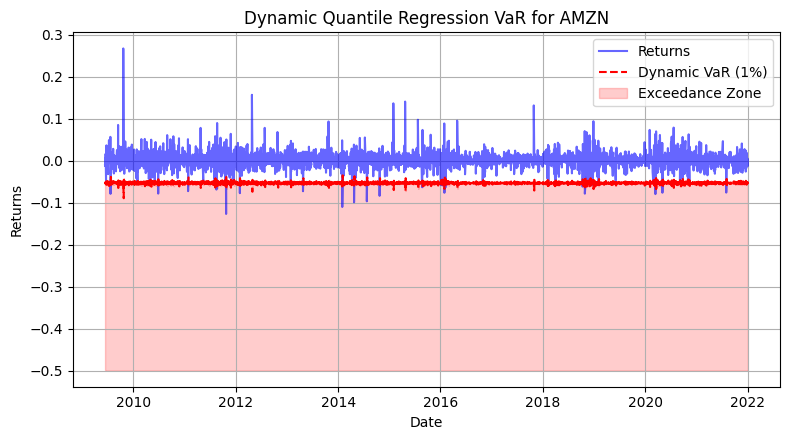

Quantile 0.1:
Intercept      -0.018302
lag1            0.015841
lag1_squared   -3.991660
dtype: float64
Quantile 0.15:
Intercept      -0.014360
lag1            0.020155
lag1_squared   -1.629050
dtype: float64
Quantile 0.2:
Intercept      -0.010814
lag1            0.030536
lag1_squared   -1.718850
dtype: float64
Quantile 0.25:
Intercept      -0.008382
lag1            0.043448
lag1_squared   -1.145195
dtype: float64
Quantile 0.3:
Intercept      -0.006129
lag1            0.007904
lag1_squared   -0.484812
dtype: float64
Quantile 0.35:
Intercept      -0.004157
lag1            0.007122
lag1_squared   -0.577974
dtype: float64
Quantile 0.4:
Intercept      -0.002619
lag1            0.009940
lag1_squared   -0.150067
dtype: float64
Quantile 0.45:
Intercept      -0.000781
lag1           -0.009517
lag1_squared    0.315914
dtype: float64
Quantile 0.5:
Intercept       0.000886
lag1           -0.031198
lag1_squared    0.617649
dtype: float64
Quantile 0.55:
Intercept       0.002653
lag1           -0.03

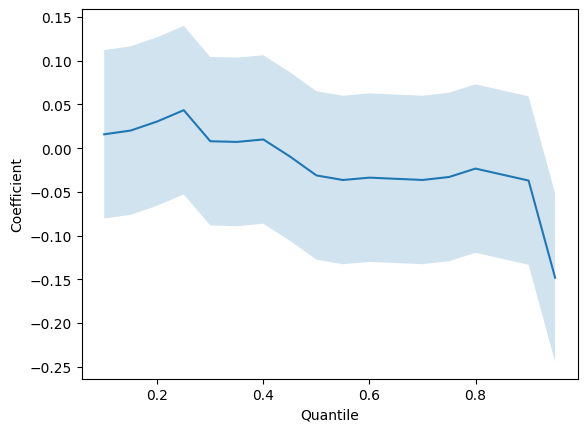

<Figure size 800x500 with 0 Axes>

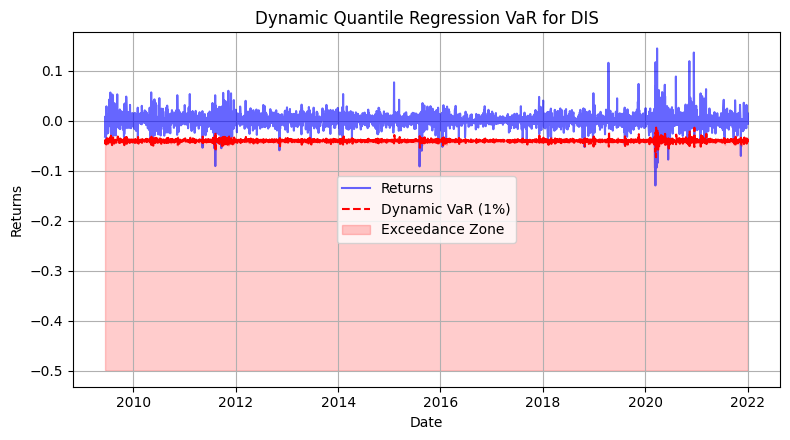

Quantile 0.1:
Intercept      -0.014234
lag1           -0.024553
lag1_squared   -5.303204
dtype: float64
Quantile 0.15:
Intercept      -0.010434
lag1            0.000190
lag1_squared   -3.962853
dtype: float64
Quantile 0.2:
Intercept      -0.008048
lag1           -0.024807
lag1_squared   -2.228589
dtype: float64
Quantile 0.25:
Intercept      -0.005922
lag1           -0.029680
lag1_squared   -2.204445
dtype: float64
Quantile 0.3:
Intercept      -0.004451
lag1           -0.025451
lag1_squared   -1.878086
dtype: float64
Quantile 0.35:
Intercept      -0.003211
lag1           -0.035324
lag1_squared   -1.543168
dtype: float64
Quantile 0.4:
Intercept      -0.001817
lag1           -0.037690
lag1_squared   -1.117383
dtype: float64
Quantile 0.45:
Intercept      -0.000634
lag1           -0.032634
lag1_squared   -0.121604
dtype: float64
Quantile 0.5:
Intercept       0.000563
lag1           -0.040480
lag1_squared    0.152141
dtype: float64
Quantile 0.55:
Intercept       0.001740
lag1           -0.04

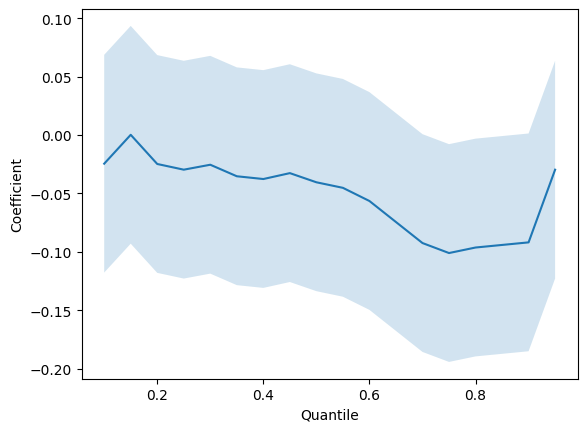

<Figure size 800x500 with 0 Axes>

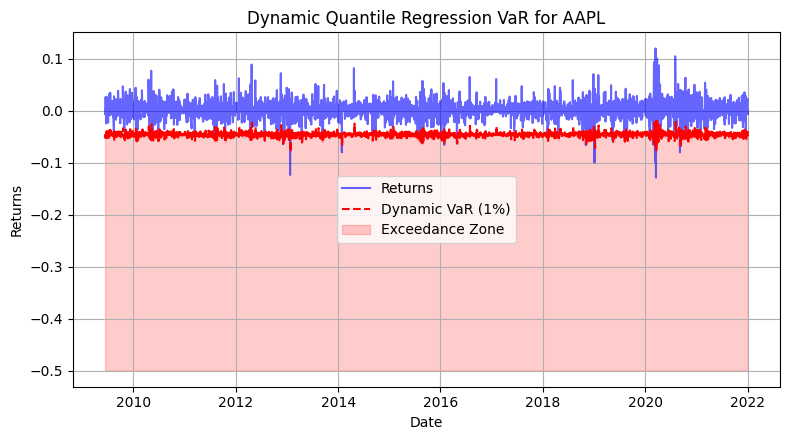

Quantile 0.1:
Intercept      -0.016347
lag1            0.147356
lag1_squared   -5.745010
dtype: float64
Quantile 0.15:
Intercept      -0.012323
lag1            0.126631
lag1_squared   -4.430726
dtype: float64
Quantile 0.2:
Intercept      -0.009021
lag1            0.088011
lag1_squared   -2.822520
dtype: float64
Quantile 0.25:
Intercept      -0.006701
lag1            0.034991
lag1_squared   -1.503343
dtype: float64
Quantile 0.3:
Intercept      -0.004999
lag1            0.017988
lag1_squared   -1.071119
dtype: float64
Quantile 0.35:
Intercept      -0.003294
lag1            0.009731
lag1_squared   -1.139855
dtype: float64
Quantile 0.4:
Intercept      -0.001886
lag1           -0.015999
lag1_squared   -0.701109
dtype: float64
Quantile 0.45:
Intercept      -0.000341
lag1           -0.027150
lag1_squared   -0.472434
dtype: float64
Quantile 0.5:
Intercept       0.001188
lag1           -0.034108
lag1_squared   -0.325265
dtype: float64
Quantile 0.55:
Intercept       0.002656
lag1           -0.05

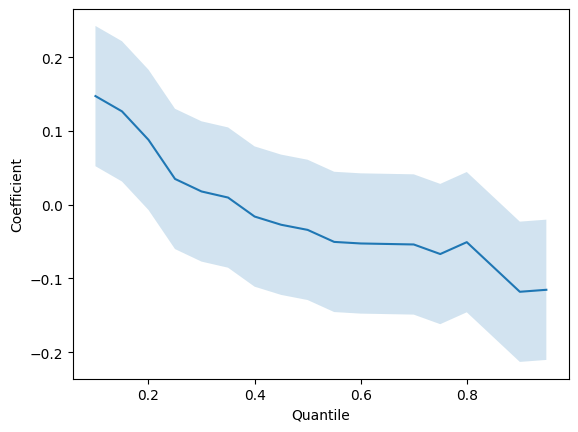

<Figure size 800x500 with 0 Axes>

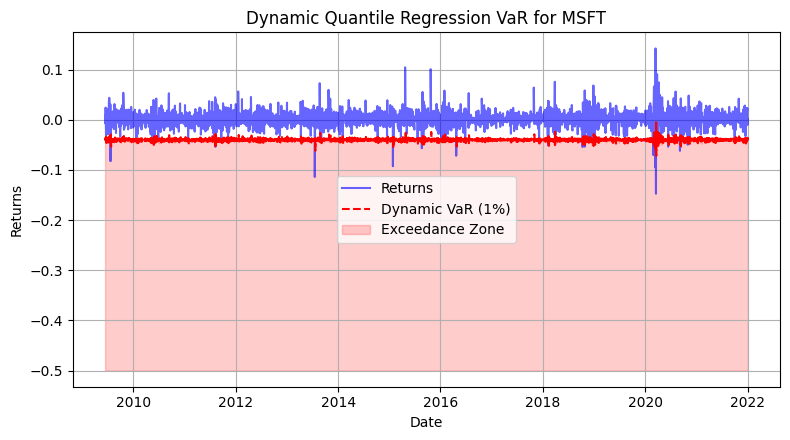

Quantile 0.1:
Intercept      -0.013843
lag1            0.049511
lag1_squared   -6.955581
dtype: float64
Quantile 0.15:
Intercept      -0.010364
lag1           -0.001747
lag1_squared   -6.006919
dtype: float64
Quantile 0.2:
Intercept      -0.007841
lag1           -0.010846
lag1_squared   -3.235406
dtype: float64
Quantile 0.25:
Intercept      -0.005930
lag1           -0.000050
lag1_squared   -2.869256
dtype: float64
Quantile 0.3:
Intercept      -0.004417
lag1           -0.009357
lag1_squared   -2.421028
dtype: float64
Quantile 0.35:
Intercept      -0.002649
lag1           -0.040166
lag1_squared   -2.202196
dtype: float64
Quantile 0.4:
Intercept      -0.001337
lag1           -0.061078
lag1_squared   -1.687645
dtype: float64
Quantile 0.45:
Intercept      -0.000135
lag1           -0.065680
lag1_squared   -0.419744
dtype: float64
Quantile 0.5:
Intercept       0.000895
lag1           -0.081571
lag1_squared    0.081401
dtype: float64
Quantile 0.55:
Intercept       0.002126
lag1           -0.09

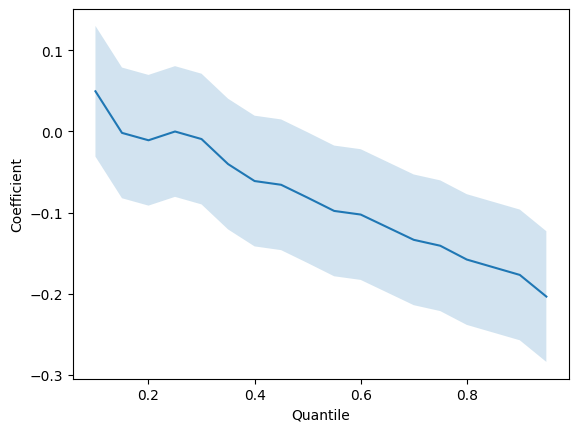

<Figure size 800x500 with 0 Axes>

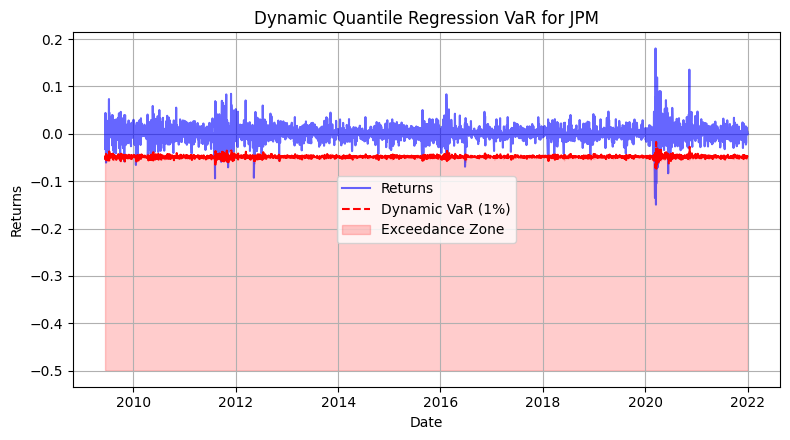

Quantile 0.1:
Intercept      -0.016352
lag1            0.061327
lag1_squared   -7.836991
dtype: float64
Quantile 0.15:
Intercept      -0.011988
lag1            0.069551
lag1_squared   -6.226015
dtype: float64
Quantile 0.2:
Intercept      -0.009031
lag1            0.014650
lag1_squared   -4.566662
dtype: float64
Quantile 0.25:
Intercept      -0.006845
lag1           -0.022055
lag1_squared   -4.278932
dtype: float64
Quantile 0.3:
Intercept      -0.004751
lag1           -0.033681
lag1_squared   -3.488383
dtype: float64
Quantile 0.35:
Intercept      -0.003307
lag1           -0.062635
lag1_squared   -2.073594
dtype: float64
Quantile 0.4:
Intercept      -0.002156
lag1           -0.065309
lag1_squared   -0.989010
dtype: float64
Quantile 0.45:
Intercept      -0.000869
lag1           -0.071087
lag1_squared    0.395042
dtype: float64
Quantile 0.5:
Intercept       0.000589
lag1           -0.090211
lag1_squared    0.606581
dtype: float64
Quantile 0.55:
Intercept       0.001971
lag1           -0.10

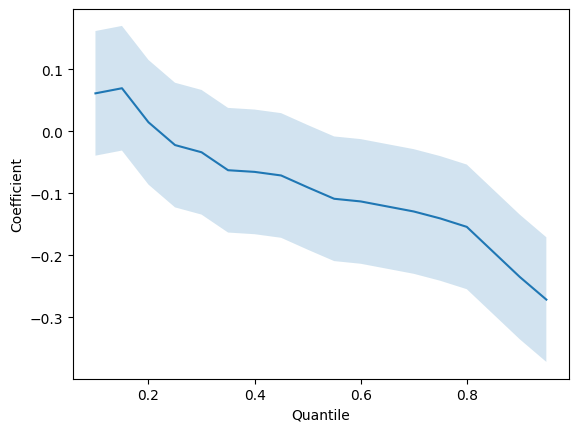

<Figure size 800x500 with 0 Axes>

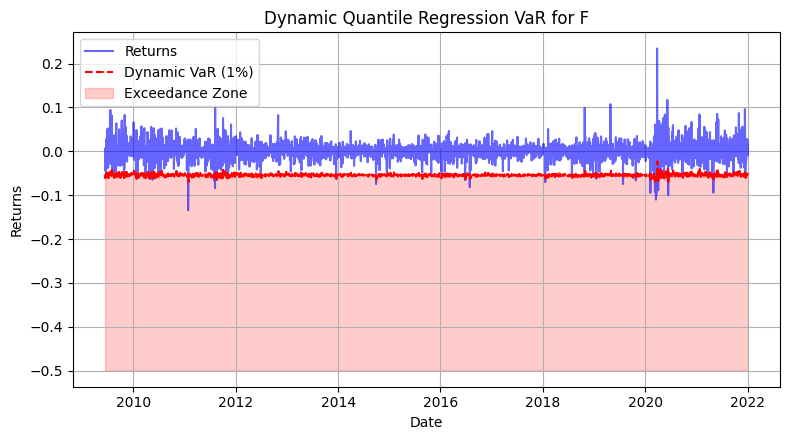

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/quantile_regression.py:191: IterationLimitWarning: Maximum number of iterations (1000) reached.
  warnings.warn("Maximum number of iterations (" + str(max_iter) +


Quantile 0.1:
Intercept      -0.019380
lag1            0.090099
lag1_squared   -3.990663
dtype: float64
Quantile 0.15:
Intercept      -0.014824
lag1            0.038336
lag1_squared   -2.646204
dtype: float64
Quantile 0.2:
Intercept      -0.011528
lag1            0.034386
lag1_squared   -2.296668
dtype: float64
Quantile 0.25:
Intercept      -0.009083
lag1            0.027166
lag1_squared   -1.695305
dtype: float64
Quantile 0.3:
Intercept      -0.006903
lag1            0.032984
lag1_squared   -0.462039
dtype: float64
Quantile 0.35:
Intercept      -0.004790
lag1            0.020516
lag1_squared   -0.312285
dtype: float64
Quantile 0.4:
Intercept      -0.002861
lag1            0.027388
lag1_squared   -0.098243
dtype: float64
Quantile 0.45:
Intercept      -0.001395
lag1            0.019407
lag1_squared   -0.143243
dtype: float64
Quantile 0.5:
Intercept       0.000180
lag1            0.024953
lag1_squared    0.490672
dtype: float64
Quantile 0.55:
Intercept       0.001653
lag1            0.01

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/quantile_regression.py:191: IterationLimitWarning: Maximum number of iterations (1000) reached.
  warnings.warn("Maximum number of iterations (" + str(max_iter) +



Quantile Regression for PG...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:             0.009231
Model:                       QuantReg   Bandwidth:                    0.002974
Method:                 Least Squares   Sparsity:                        1.021
Date:                Sat, 15 Feb 2025   No. Observations:                 3161
Time:                        13:04:42   Df Residuals:                     3158
                                        Df Model:                            2
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0298      0.002    -15.778      0.000      -0.033      -0.026
lag_1          0.0932      0.539      0.173      0.863      -0.964       1.151
lag_2          0.1657      0.453      0.366      0.715      -0.722       1.054


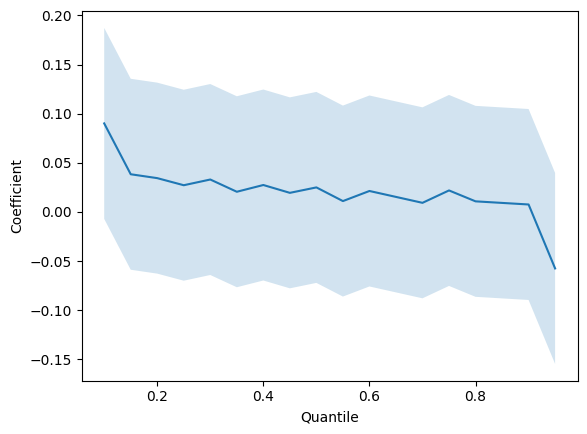

<Figure size 800x500 with 0 Axes>

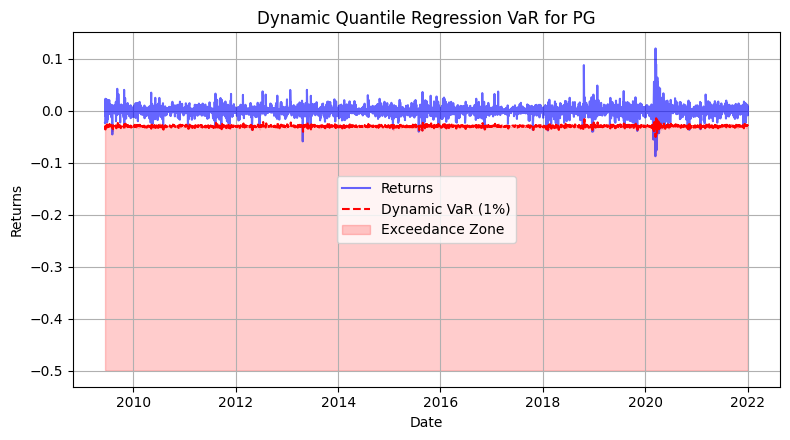

Quantile 0.1:
Intercept      -0.009137
lag1           -0.044601
lag1_squared   -8.235644
dtype: float64
Quantile 0.15:
Intercept      -0.006951
lag1           -0.034421
lag1_squared   -7.282692
dtype: float64
Quantile 0.2:
Intercept      -0.005252
lag1           -0.007117
lag1_squared   -5.260813
dtype: float64
Quantile 0.25:
Intercept      -0.003928
lag1           -0.039695
lag1_squared   -4.566507
dtype: float64
Quantile 0.3:
Intercept      -0.003038
lag1           -0.045750
lag1_squared   -2.794257
dtype: float64
Quantile 0.35:
Intercept      -0.002079
lag1           -0.048801
lag1_squared   -2.835304
dtype: float64
Quantile 0.4:
Intercept      -0.001103
lag1           -0.053615
lag1_squared   -2.618155
dtype: float64
Quantile 0.45:
Intercept      -0.000147
lag1           -0.046916
lag1_squared   -2.780174
dtype: float64
Quantile 0.5:
Intercept       0.000708
lag1           -0.043889
lag1_squared   -1.802445
dtype: float64
Quantile 0.55:
Intercept       0.001543
lag1           -0.04

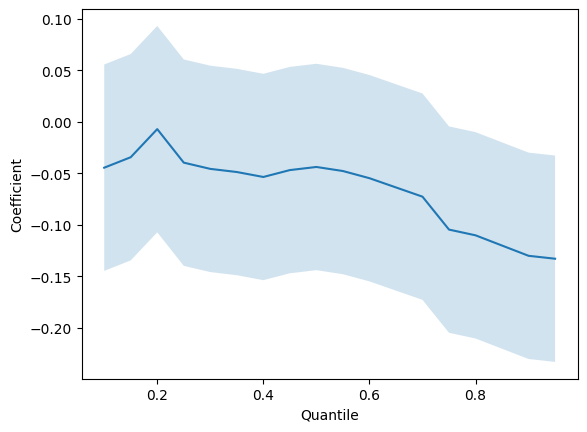

<Figure size 800x500 with 0 Axes>

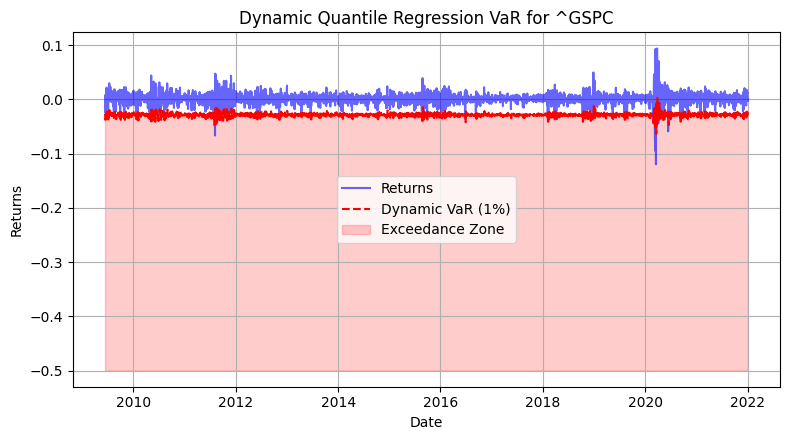

Quantile 0.1:
Intercept       -0.008957
lag1             0.100399
lag1_squared   -14.976273
dtype: float64
Quantile 0.15:
Intercept       -0.006226
lag1             0.017620
lag1_squared   -12.980784
dtype: float64
Quantile 0.2:
Intercept       -0.004308
lag1             0.011053
lag1_squared   -10.749946
dtype: float64
Quantile 0.25:
Intercept      -0.003023
lag1           -0.031513
lag1_squared   -7.557834
dtype: float64
Quantile 0.3:
Intercept      -0.001939
lag1           -0.045325
lag1_squared   -5.897886
dtype: float64
Quantile 0.35:
Intercept      -0.001358
lag1           -0.027992
lag1_squared   -0.972691
dtype: float64
Quantile 0.4:
Intercept      -0.000591
lag1           -0.053132
lag1_squared    0.550832
dtype: float64
Quantile 0.45:
Intercept       0.000062
lag1           -0.055757
lag1_squared    1.035725
dtype: float64
Quantile 0.5:
Intercept       0.000712
lag1           -0.081616
lag1_squared    2.099218
dtype: float64
Quantile 0.55:
Intercept       0.001539
lag1       

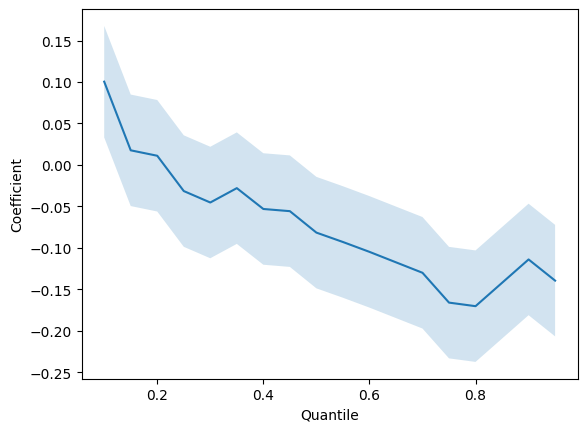

<Figure size 800x500 with 0 Axes>

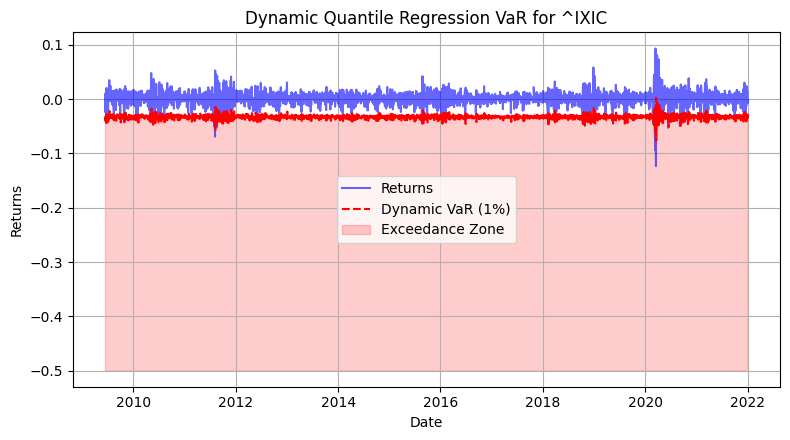

Quantile 0.1:
Intercept       -0.011012
lag1             0.056558
lag1_squared   -11.720758
dtype: float64
Quantile 0.15:
Intercept       -0.007863
lag1             0.028931
lag1_squared   -10.553438
dtype: float64
Quantile 0.2:
Intercept      -0.005371
lag1            0.041630
lag1_squared   -8.623540
dtype: float64
Quantile 0.25:
Intercept      -0.003762
lag1            0.012038
lag1_squared   -4.962749
dtype: float64
Quantile 0.3:
Intercept      -0.002422
lag1            0.000178
lag1_squared   -4.083561
dtype: float64
Quantile 0.35:
Intercept      -0.001468
lag1           -0.016501
lag1_squared   -2.416719
dtype: float64
Quantile 0.4:
Intercept      -0.000601
lag1           -0.008000
lag1_squared   -0.496377
dtype: float64
Quantile 0.45:
Intercept       0.000433
lag1           -0.032766
lag1_squared   -0.245328
dtype: float64
Quantile 0.5:
Intercept       0.001284
lag1           -0.066062
lag1_squared    0.681250
dtype: float64
Quantile 0.55:
Intercept       0.002140
lag1          

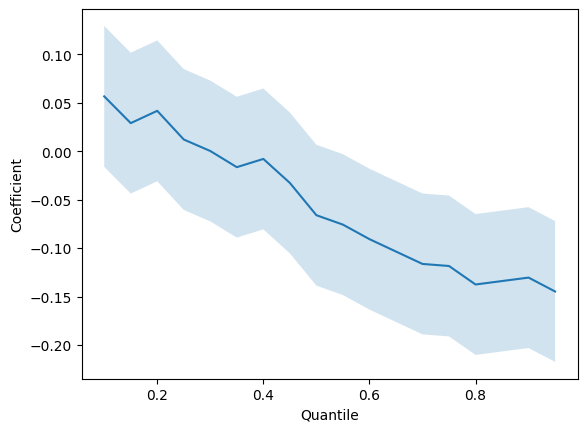

<Figure size 800x500 with 0 Axes>

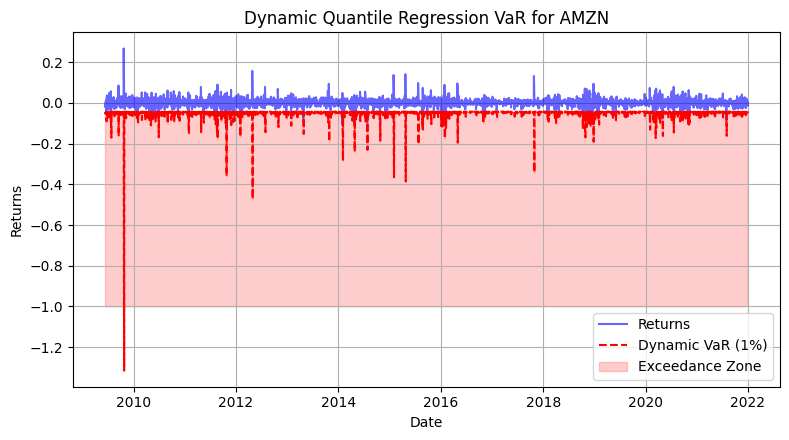

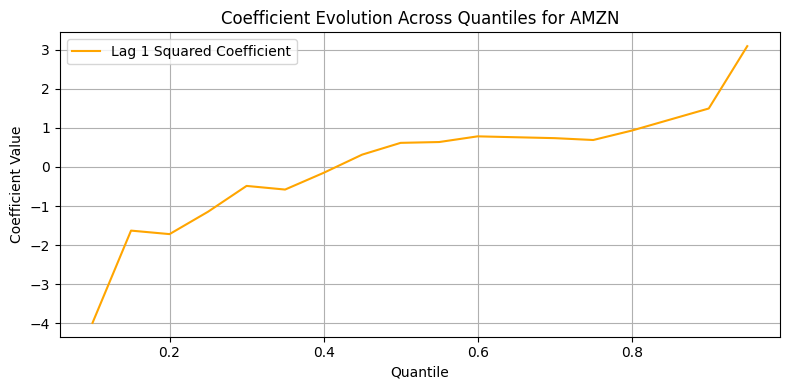


Quantile Regression with lag and squared lag for DIS...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/quantile_regression.py:191: IterationLimitWarning: Maximum number of iterations (1000) reached.
  warnings.warn("Maximum number of iterations (" + str(max_iter) +


                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:               0.1054
Model:                       QuantReg   Bandwidth:                    0.004557
Method:                 Least Squares   Sparsity:                       0.8310
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:04:53   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0341      0.002    -22.674      0.000      -0.037      -0.031
lag_1             0.0182      0.097      0.187      0.851      -0.172       0.208
lag_1_squared   -22.8606      1.127    -20.290      0.000     -25.070     -20.652

The condition number is large, 1.1e+

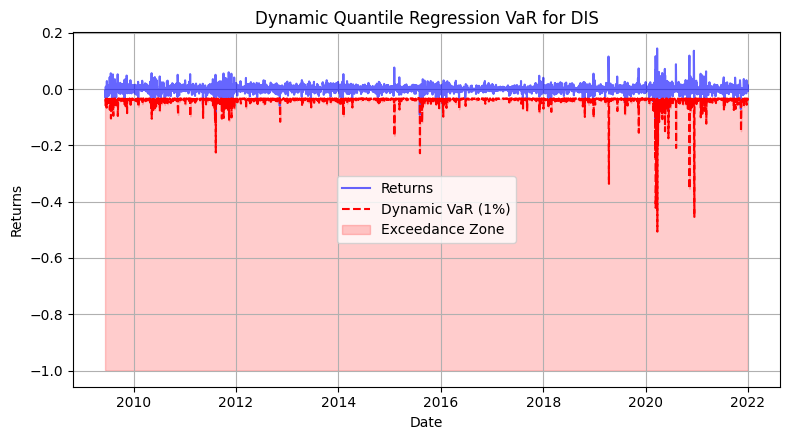

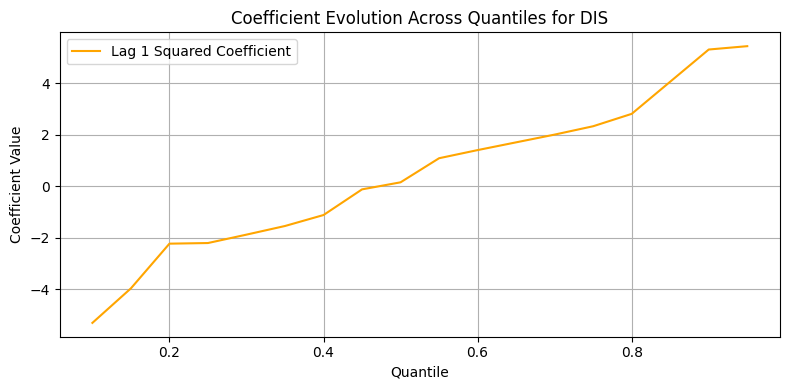


Quantile Regression with lag and squared lag for AAPL...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:              0.04582
Model:                       QuantReg   Bandwidth:                    0.005436
Method:                 Least Squares   Sparsity:                        1.107
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:04:54   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0435      0.003    -15.596      0.000      -0.049      -0.038
lag_1             0.2207      0.166      1.332      0.183      -0.104       0.546
lag_1_squared    -7.7743      6.684     -1.163      0.245    

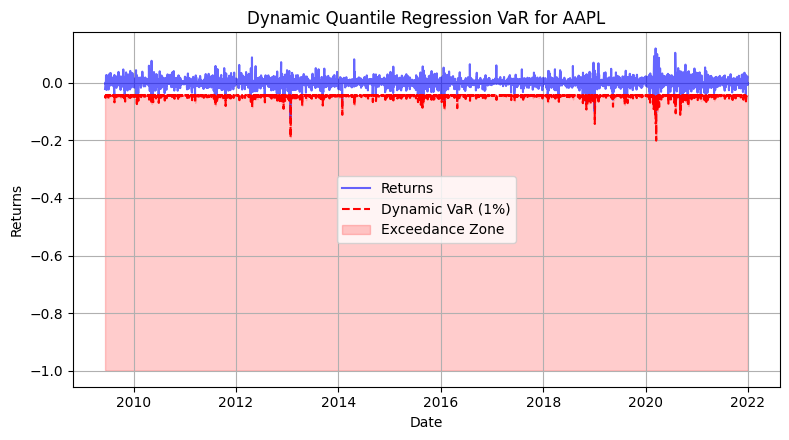

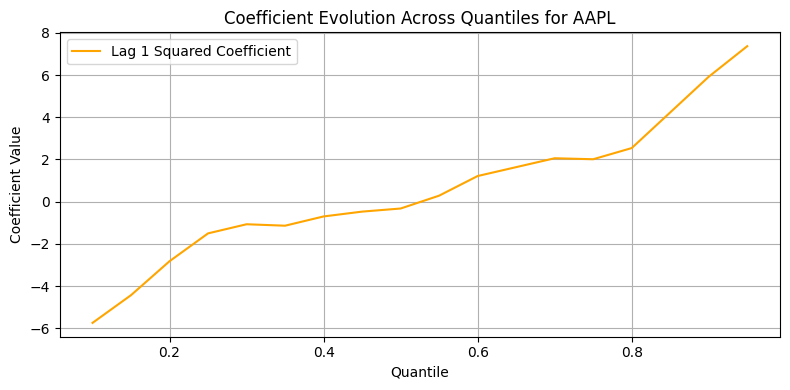


Quantile Regression with lag and squared lag for MSFT...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:               0.1055
Model:                       QuantReg   Bandwidth:                    0.005085
Method:                 Least Squares   Sparsity:                        1.031
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:04:57   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0343      0.002    -18.336      0.000      -0.038      -0.031
lag_1             0.2686      0.121      2.212      0.027       0.031       0.507
lag_1_squared   -23.5500      1.060    -22.214      0.000    

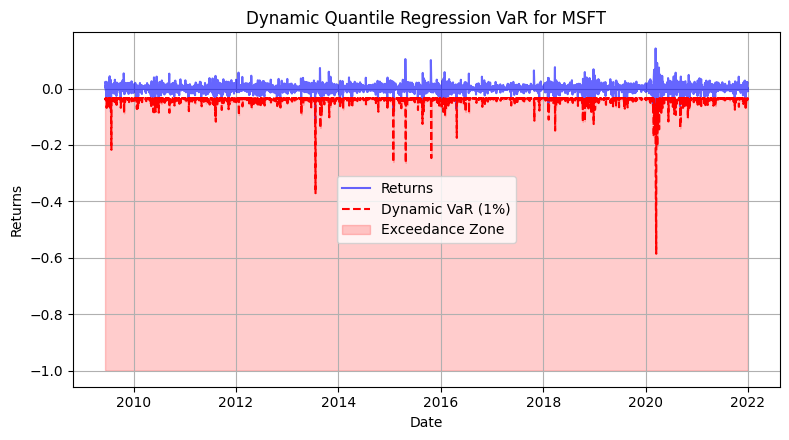

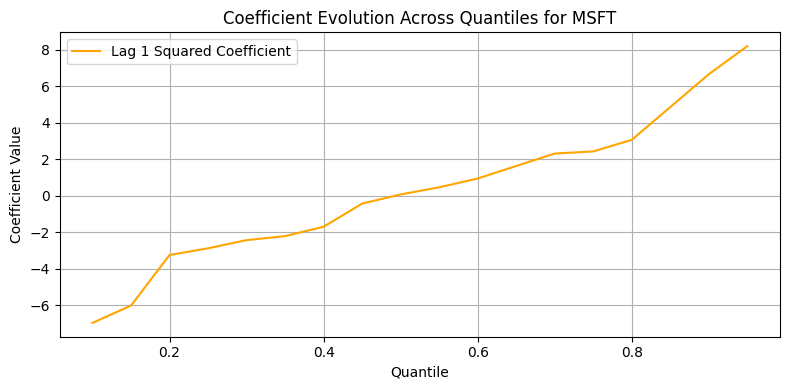


Quantile Regression with lag and squared lag for JPM...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:               0.1563
Model:                       QuantReg   Bandwidth:                    0.005461
Method:                 Least Squares   Sparsity:                       0.9153
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:05:00   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0392      0.002    -23.228      0.000      -0.042      -0.036
lag_1             0.1622      0.101      1.609      0.108      -0.035       0.360
lag_1_squared   -20.3475      1.062    -19.157      0.000     

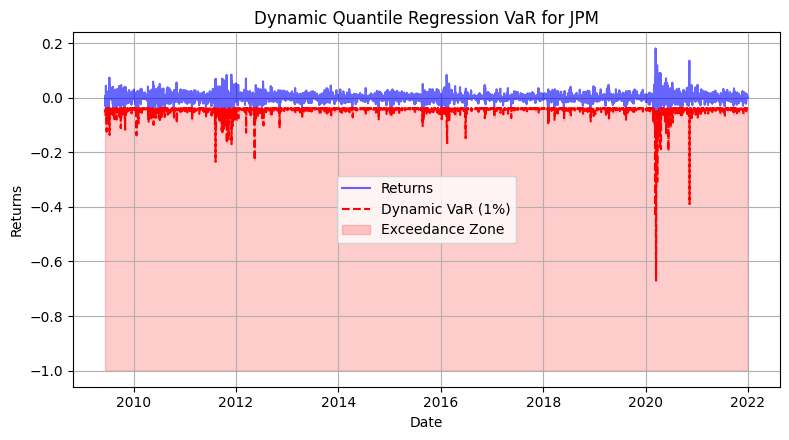

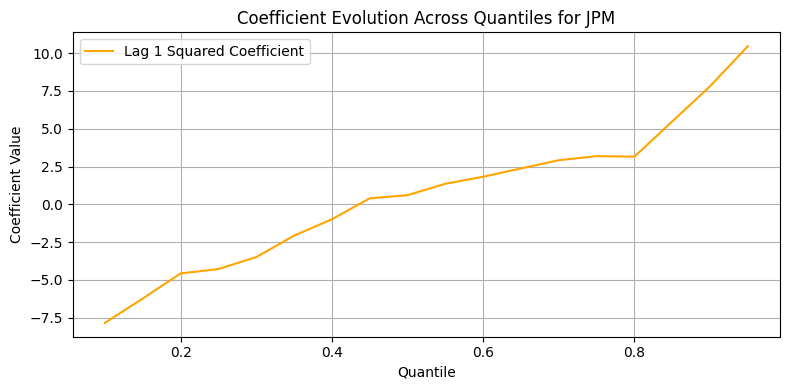


Quantile Regression with lag and squared lag for F...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:              0.03785
Model:                       QuantReg   Bandwidth:                    0.006245
Method:                 Least Squares   Sparsity:                        1.288
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:05:02   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0507      0.002    -21.549      0.000      -0.055      -0.046
lag_1             0.3056      0.121      2.522      0.012       0.068       0.543
lag_1_squared    -8.8015      1.041     -8.456      0.000     -1

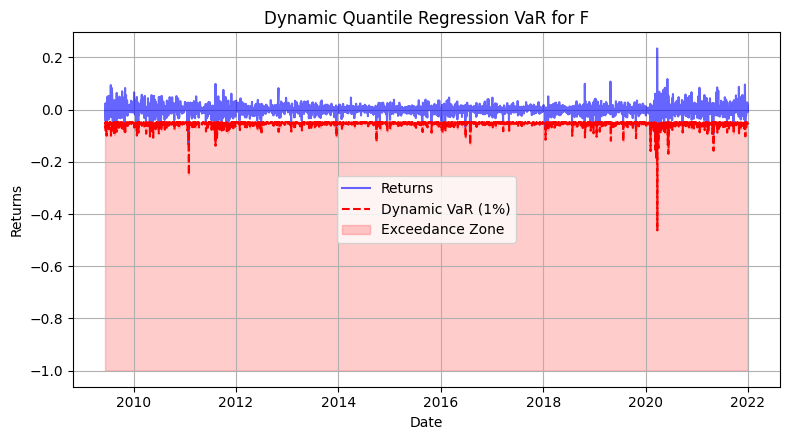

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/quantile_regression.py:191: IterationLimitWarning: Maximum number of iterations (1000) reached.
  warnings.warn("Maximum number of iterations (" + str(max_iter) +


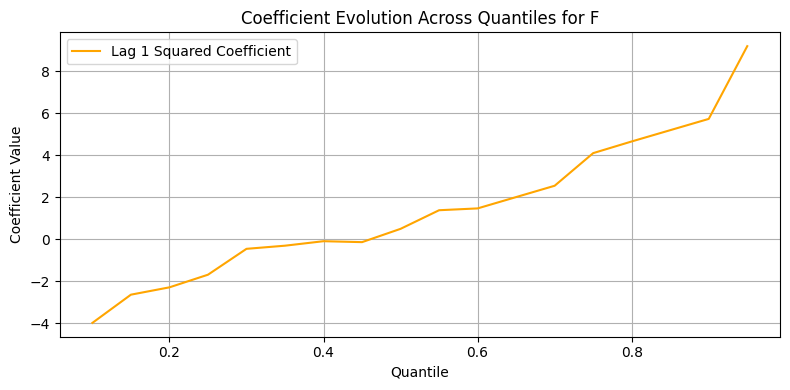


Quantile Regression with lag and squared lag for PG...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:               0.1475
Model:                       QuantReg   Bandwidth:                    0.003171
Method:                 Least Squares   Sparsity:                       0.8331
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:05:04   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0255      0.002    -16.872      0.000      -0.029      -0.023
lag_1            -0.0921      0.150     -0.613      0.540      -0.387       0.202
lag_1_squared   -28.7692      2.015    -14.278      0.000     -

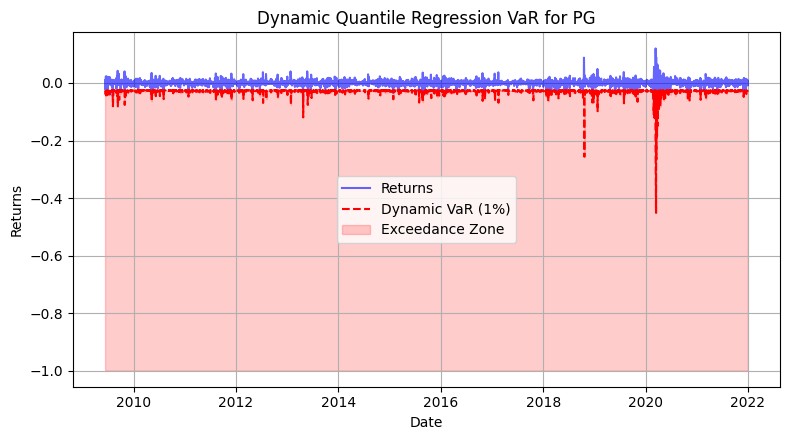

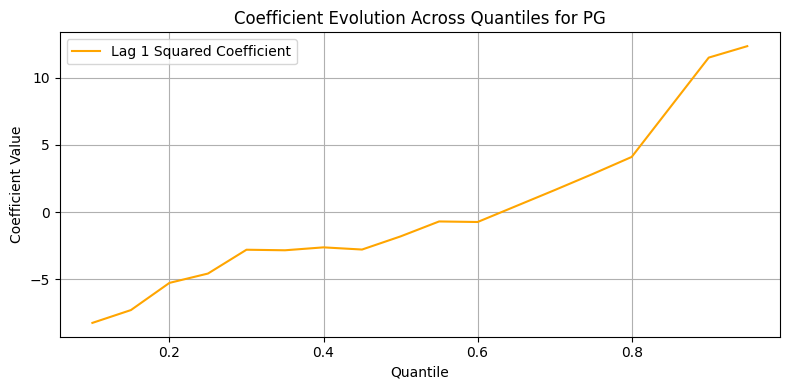


Quantile Regression with lag and squared lag for ^GSPC...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:               0.1563
Model:                       QuantReg   Bandwidth:                    0.003110
Method:                 Least Squares   Sparsity:                       0.5210
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:05:06   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0262      0.001    -27.784      0.000      -0.028      -0.024
lag_1             0.3878      0.095      4.063      0.000       0.201       0.575
lag_1_squared   -20.9270      1.618    -12.934      0.000   

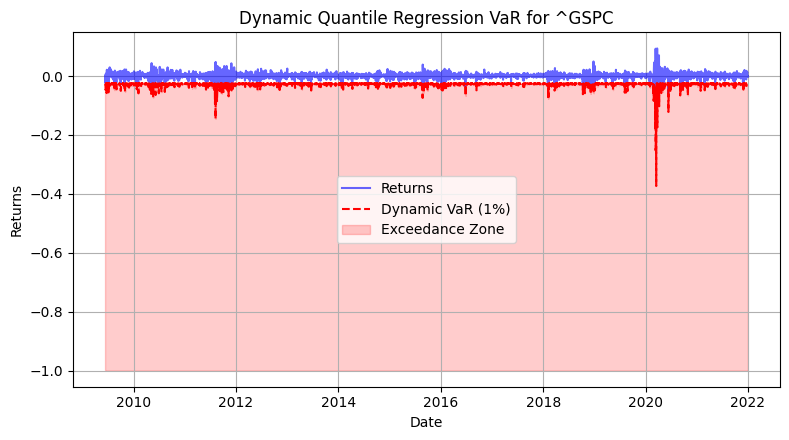

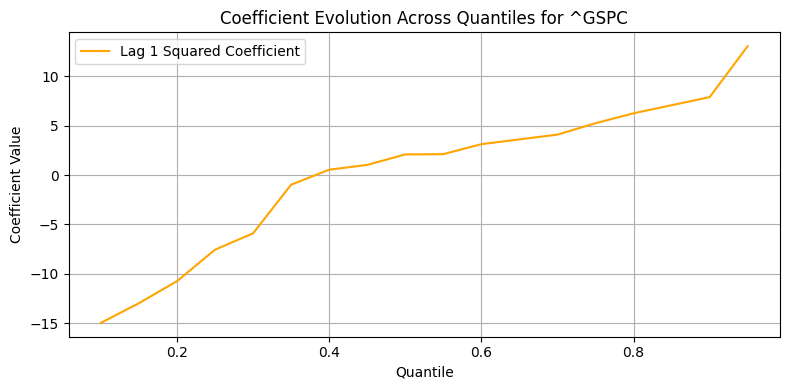


Quantile Regression with lag and squared lag for ^IXIC...
                         QuantReg Regression Results                          
Dep. Variable:                returns   Pseudo R-squared:               0.1075
Model:                       QuantReg   Bandwidth:                    0.003560
Method:                 Least Squares   Sparsity:                       0.9617
Date:                Sat, 15 Feb 2025   No. Observations:                 3162
Time:                        13:05:07   Df Residuals:                     3159
                                        Df Model:                            2
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0304      0.002    -17.486      0.000      -0.034      -0.027
lag_1             0.2279      0.139      1.646      0.100      -0.044       0.500
lag_1_squared   -24.0915      2.570     -9.374      0.000   

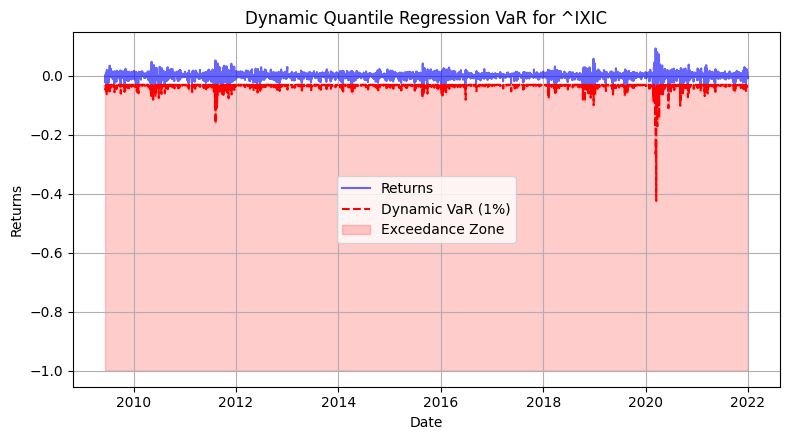

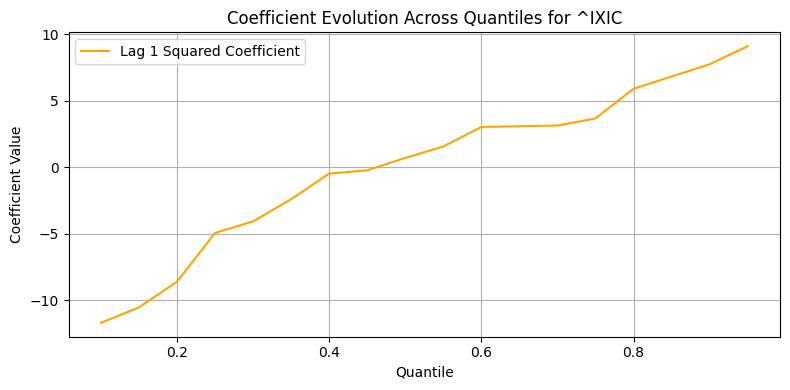


Quantile Regression Coefficients for AMZN...


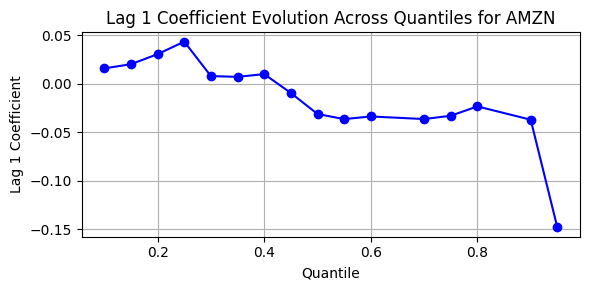


Quantile Regression Coefficients for DIS...


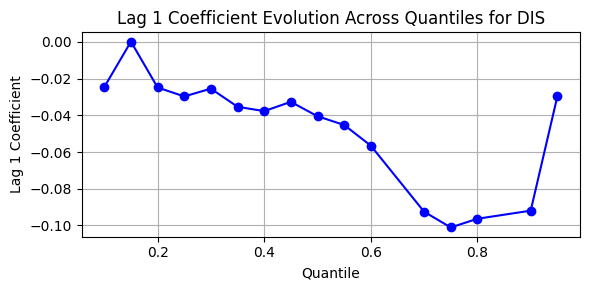


Quantile Regression Coefficients for AAPL...


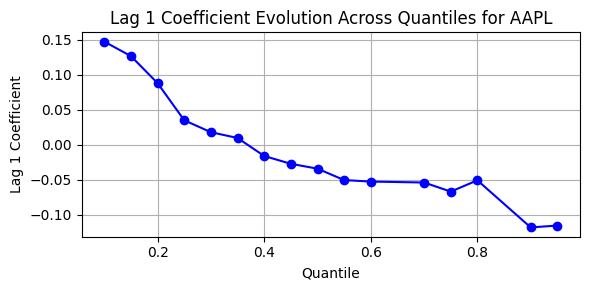


Quantile Regression Coefficients for MSFT...


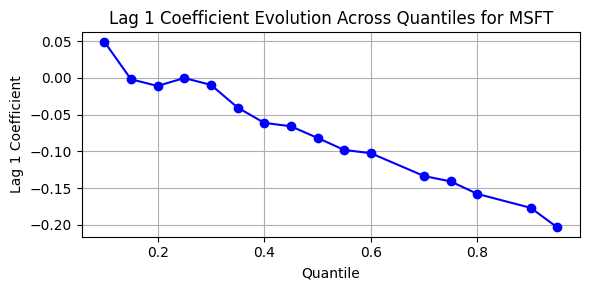


Quantile Regression Coefficients for JPM...


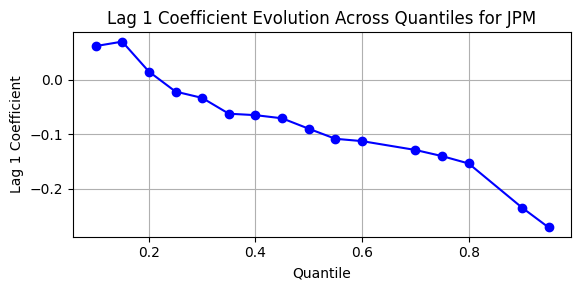


Quantile Regression Coefficients for F...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/quantile_regression.py:191: IterationLimitWarning: Maximum number of iterations (1000) reached.
  warnings.warn("Maximum number of iterations (" + str(max_iter) +


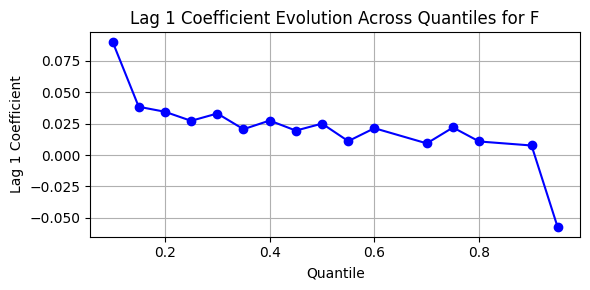


Quantile Regression Coefficients for PG...


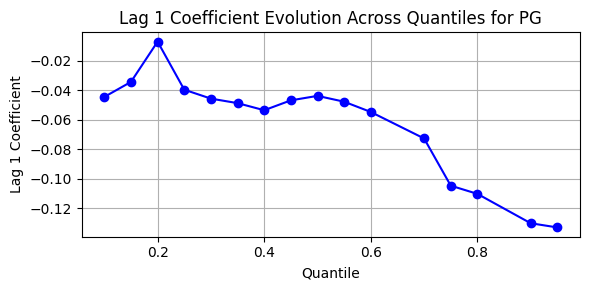


Quantile Regression Coefficients for ^GSPC...


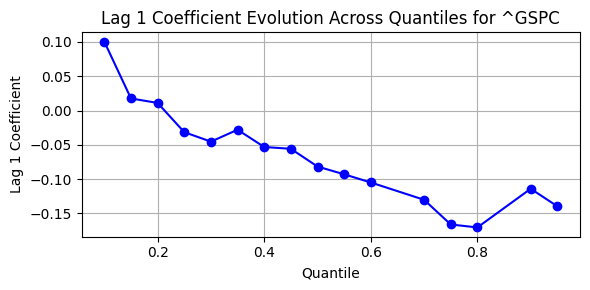


Quantile Regression Coefficients for ^IXIC...


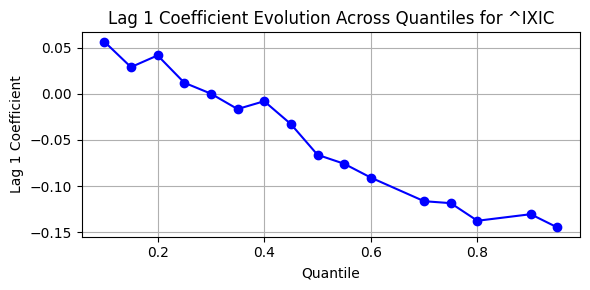

In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt

returns = (prices.values[1:] / prices.values[:-1]) - 1
returns_df = pd.DataFrame(returns, columns=prices.columns, index=prices.index[1:])

# Functions to add lags to data ----------
def add_lags(data, lags=2):
    lagged_data = data.copy()
    for lag in range(1, lags + 1):
        lagged_data[f'lag_{lag}'] = lagged_data['returns'].shift(lag)
    return lagged_data.dropna()

def add_lags_and_squared(data, lags=1):
    lagged_data = data.copy()
    for lag in range(1, lags + 1):
        lagged_data[f'lag_{lag}'] = lagged_data['returns'].shift(lag)
        lagged_data[f'lag_{lag}_squared'] = lagged_data[f'lag_{lag}'] ** 2
    return lagged_data.dropna()


def add_squared(data, lags=1):
    lagged_data = data.copy()
    for lag in range(1, lags + 1):

        lagged_data[f'lag_{lag}_squared'] = lagged_data['returns'].shift(lag) ** 2

    return lagged_data.dropna()  # Drop NaN values caused by shifting


alpha = 0.01  # confidence level of 99% (quantile 1%)
lags = 2

for ticker in returns_df.columns:
    print(f"\nQuantile Regression for {ticker}...")

    returns_ticker = returns_df[[ticker]].rename(columns={ticker: 'returns'})
    lagged_data = add_lags(returns_ticker, lags=lags)

    # prepare dependent and independent variables
    y = lagged_data['returns']
    X = lagged_data.drop(columns=['returns'])
    X = sm.add_constant(X)  # add intercept

    # Quantile Regression
    model = sm.QuantReg(y, X)
    quantile_model = model.fit(q=alpha)  # estimate
    print(quantile_model.summary())

    # var computation
    VaR_dynamic = quantile_model.predict(X)
    VaR_dynamic = pd.Series(VaR_dynamic, index=lagged_data.index, name='VaR_dynamic')

    #
    plt.figure(figsize=(8, 4.5))
    plt.plot(lagged_data.index, y, label="Returns", color="blue", alpha=0.6)
    plt.plot(VaR_dynamic.index, VaR_dynamic, label=f"Dynamic VaR ({int(alpha*100)}%)", color="red", linestyle="--")
    plt.fill_between(VaR_dynamic.index, VaR_dynamic, -0.5, color="red", alpha=0.2, label="Exceedance Zone")
    plt.title(f"Dynamic Quantile Regression VaR for {ticker}")
    plt.xlabel("Date")
    plt.ylabel("Returns")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


    #Estimate Quantile Regressions at Multiple Quantiles (not just at the 1% level) to see what changes

    # Fit QR for different quantiles
    quantiles = [0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.7, 0.75, 0.8, 0.9, 0.95]  # choose
    models = []

    example_data = returns_df[[ticker]].rename(columns={ticker: 'returns'})
    example_data['lag1'] = example_data['returns'].shift(1)
    example_data['lag1_squared'] = example_data['lag1'] ** 2
    example_data = example_data.dropna()

    # regression for every quantile
    for tau in quantiles:
        model = smf.quantreg('returns ~ lag1 + lag1_squared', example_data).fit(q=tau)
        models.append(model)

    # extract  coefficients
    for i, tau in enumerate(quantiles):
        print(f"Quantile {tau}:")
        print(models[i].params)

    # plot evolution of  coefficients
    taus = np.linspace(0.05, 0.95, 19)
    coefficients = []

    for tau in quantiles:
        model = smf.quantreg('returns ~ lag1 + lag1_squared', example_data).fit(q=tau)
        coefficients.append(model.params)

    coefficients = pd.DataFrame(coefficients, index=quantiles)
    plt.plot(quantiles, coefficients['lag1'], label='Lag 1 Coefficient')
    plt.fill_between(quantiles,
                    coefficients['lag1'] - 1.96 * model.bse['lag1'],
                    coefficients['lag1'] + 1.96 * model.bse['lag1'],
                    alpha=0.2)
    plt.xlabel('Quantile')
    plt.ylabel('Coefficient')

    plt.figure(figsize=(8, 5))


lags = 1  # Number of lags to include
# ----this time  add lags and lags squared ----
for ticker in returns_df.columns:
    print(f"\nQuantile Regression with lag and squared lag for {ticker}...")

    returns_ticker = returns_df[[ticker]].rename(columns={ticker: 'returns'})
    lagged_data = add_lags_and_squared(returns_ticker, lags=lags)

    # keep copy of original index
    lagged_data = lagged_data.dropna()
    y = lagged_data['returns']
    X = lagged_data.drop(columns=['returns'])
    X = sm.add_constant(X)  # add  intercept

    # Quantile Regression
    model = sm.QuantReg(y, X)
    quantile_model = model.fit(q=alpha)  # estimate
    print(quantile_model.summary())

    #  VaR dynamic
    VaR_dynamic = quantile_model.predict(X)
    VaR_dynamic = pd.Series(VaR_dynamic, index=lagged_data.index, name='VaR_dynamic')

    #
    plt.figure(figsize=(8, 4.5))
    plt.plot(lagged_data.index, y, label="Returns", color="blue", alpha=0.6)
    plt.plot(VaR_dynamic.index, VaR_dynamic, label=f"Dynamic VaR ({int(alpha*100)}%)", color="red", linestyle="--")
    plt.fill_between(VaR_dynamic.index, VaR_dynamic, -1, color="red", alpha=0.2, label="Exceedance Zone")
    plt.title(f"Dynamic Quantile Regression VaR for {ticker}")
    plt.xlabel("Date")
    plt.ylabel("Returns")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


    #quantiles = np.linspace(0.01, 0.99, 12)  # Quantili da analizzare
    coefficients = []
    errors = []  # Per memorizzare gli errori standard

    for q in quantiles:
        quantile_model = model.fit(q=q)
        coefficients.append(quantile_model.params)
        errors.append(quantile_model.bse)

    coefficients_df = pd.DataFrame(coefficients, index=quantiles)
    errors_df = pd.DataFrame(errors, index=quantiles)  # Errori standard

    # effects of quantiles on coefficients
    plt.figure(figsize=(8, 4))
    plt.plot(coefficients_df.index, coefficients_df['lag_1_squared'], label='Lag 1 Squared Coefficient', color='orange')

    plt.xlabel('Quantile')
    plt.ylabel('Coefficient Value')
    plt.title(f'Coefficient Evolution Across Quantiles for {ticker}')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


for ticker in returns_df.columns:
    print(f"\nQuantile Regression Coefficients for {ticker}...")

    returns_ticker = returns_df[[ticker]].rename(columns={ticker: 'returns'})
    data = add_lags_and_squared(returns_ticker, lags=lags)
    data = data.dropna()

    y = data['returns']
    X = data.drop(columns=['returns'])
    X = sm.add_constant(X)

    # list to save lag_1 coefficients
    lag_1_coefficients = []

    # quantile regression for each quantile
    for q in quantiles:
        model = sm.QuantReg(y, X)
        result = model.fit(q=q)
        lag_1_coefficients.append(result.params['lag_1'])  # Salva il coefficiente di lag_1

    # Plot  coefficients vs quantiles
    plt.figure(figsize=(6, 3))
    plt.plot(quantiles, lag_1_coefficients, marker='o', linestyle='-', color='blue')
    plt.title(f'Lag 1 Coefficient Evolution Across Quantiles for {ticker}')
    plt.xlabel('Quantile')
    plt.ylabel('Lag 1 Coefficient')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

## EVT and GARCH (with gev)


Processing GEV for standardized residuals of AMZN...
GEV Parameters for AMZN: Shape=-0.4255, Loc=2.1295, Scale=0.8737


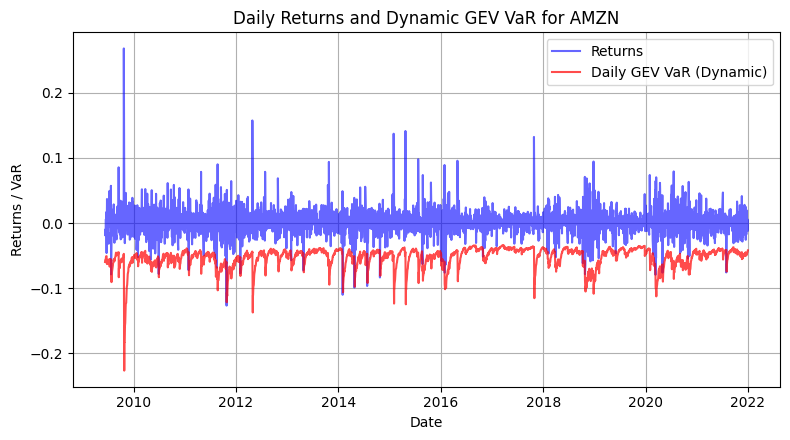

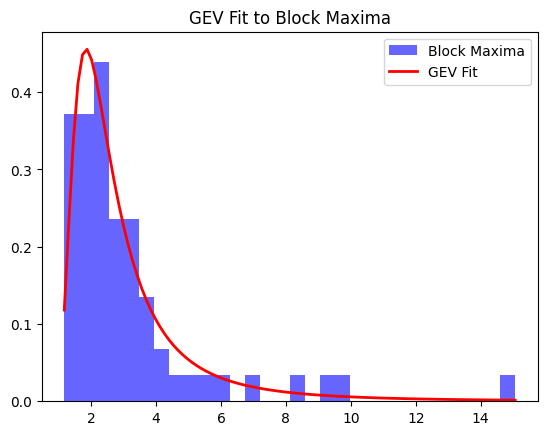


Processing GEV for standardized residuals of DIS...
GEV Parameters for DIS: Shape=-0.2839, Loc=2.1331, Scale=0.6765


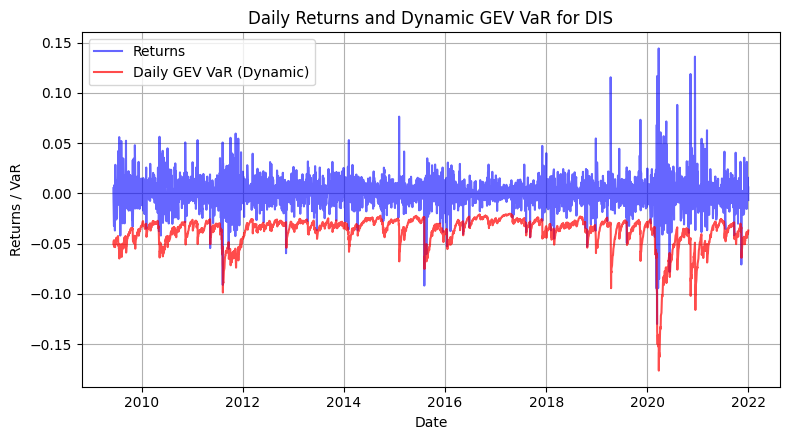

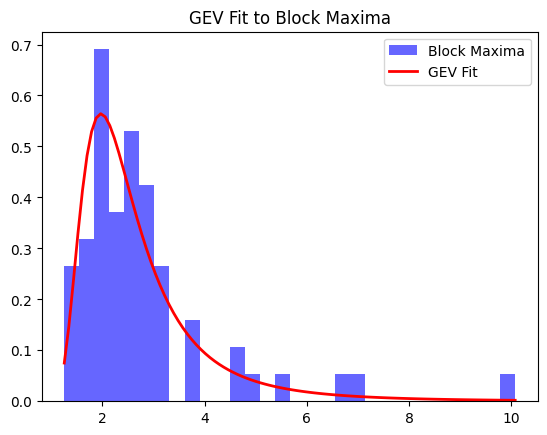


Processing GEV for standardized residuals of AAPL...
GEV Parameters for AAPL: Shape=-0.3210, Loc=2.1895, Scale=0.6267


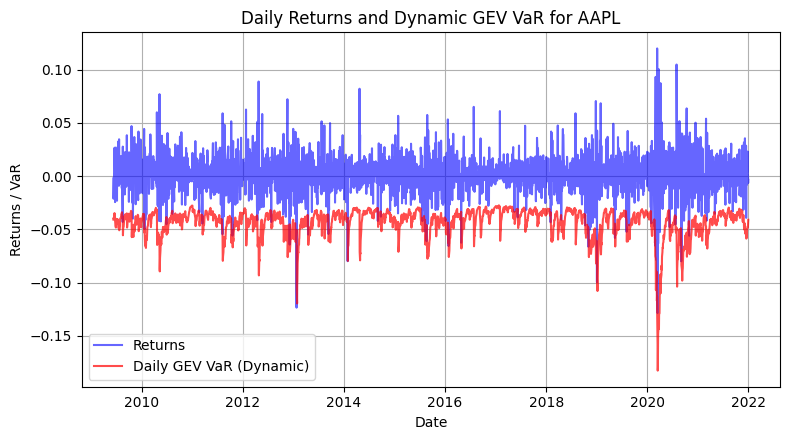

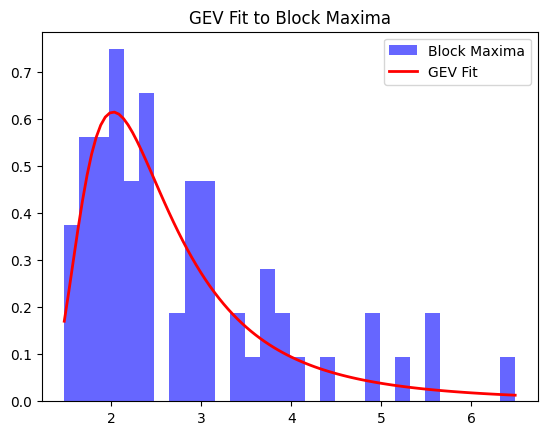


Processing GEV for standardized residuals of MSFT...
GEV Parameters for MSFT: Shape=-0.3200, Loc=2.1865, Scale=0.6920


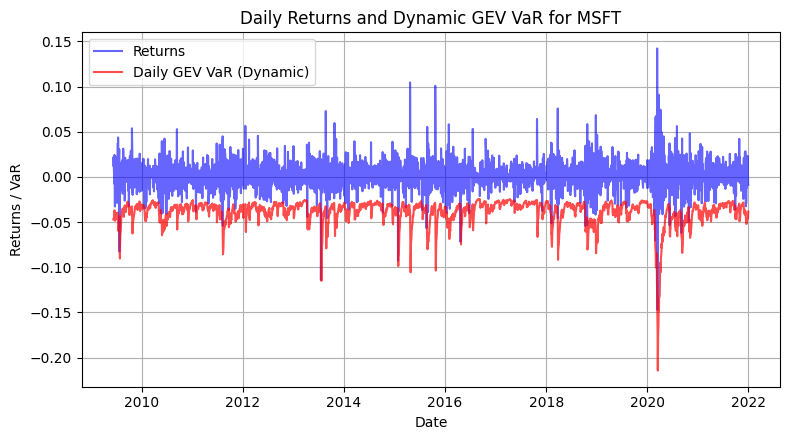

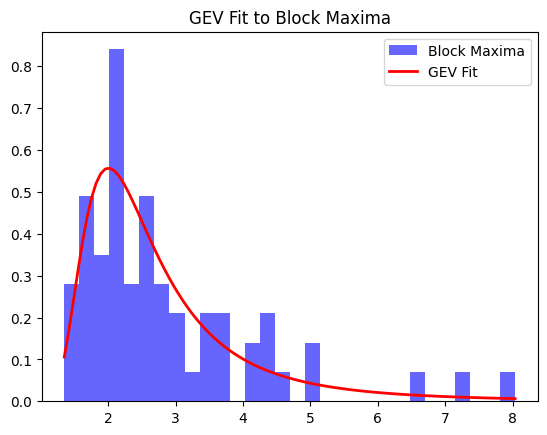


Processing GEV for standardized residuals of JPM...
GEV Parameters for JPM: Shape=-0.0599, Loc=2.1578, Scale=0.6144


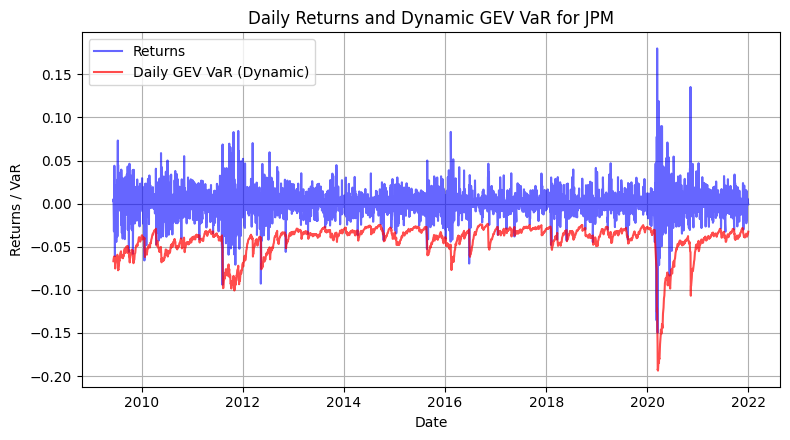

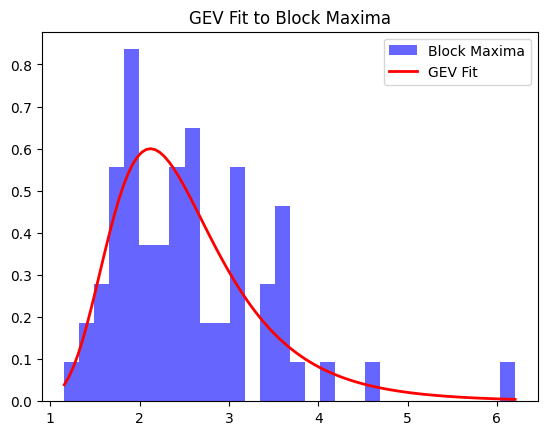


Processing GEV for standardized residuals of F...
GEV Parameters for F: Shape=-0.1023, Loc=2.0616, Scale=0.7120


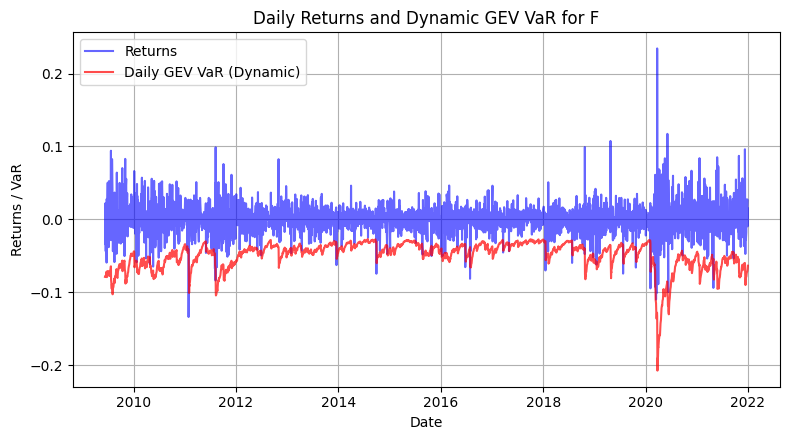

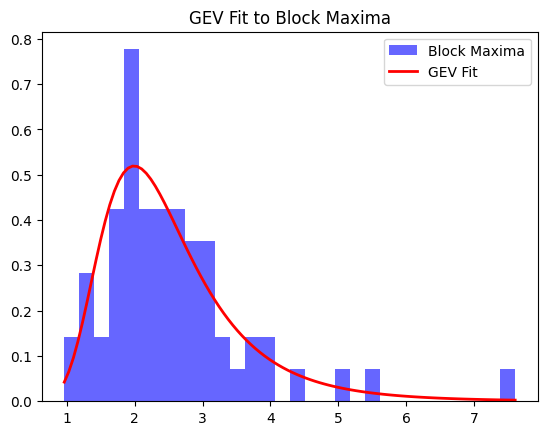


Processing GEV for standardized residuals of PG...
GEV Parameters for PG: Shape=-0.3580, Loc=2.0064, Scale=0.5445


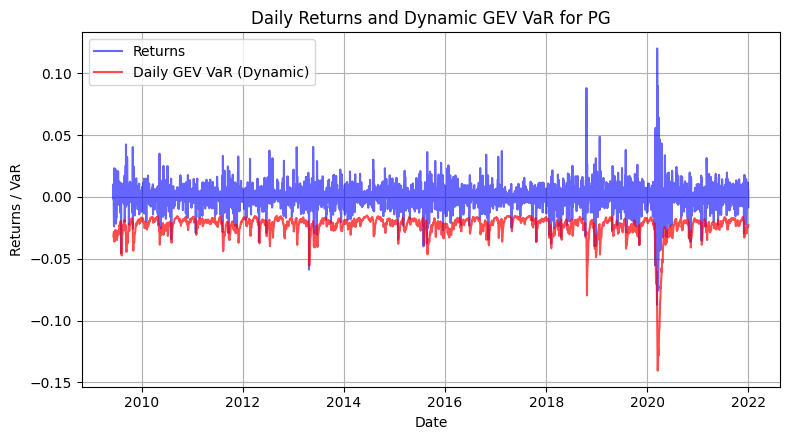

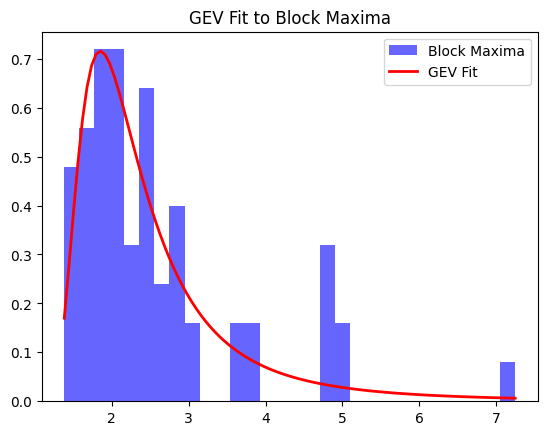


Processing GEV for standardized residuals of ^GSPC...
GEV Parameters for ^GSPC: Shape=-0.1017, Loc=1.9969, Scale=0.3349


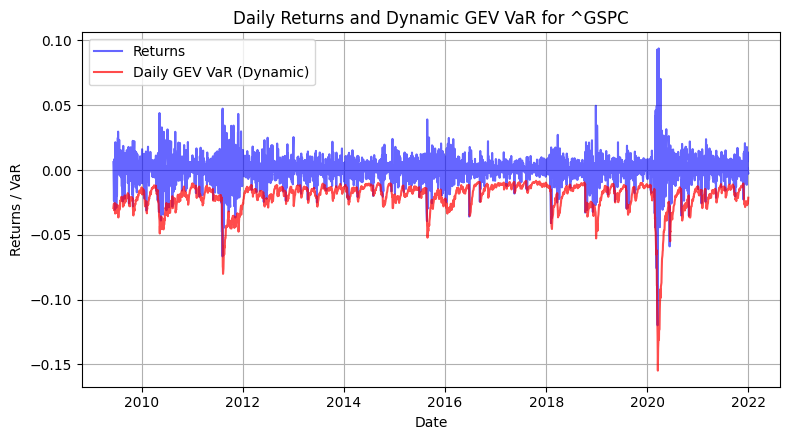

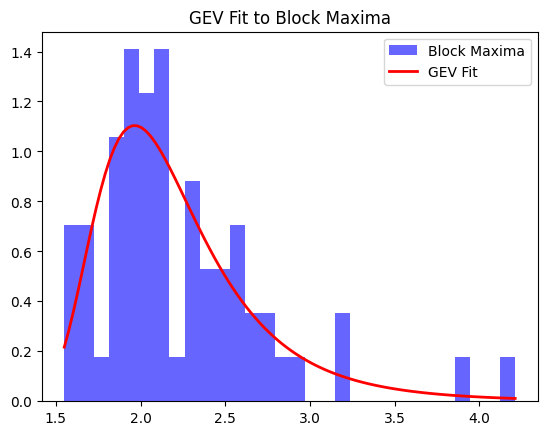


Processing GEV for standardized residuals of ^IXIC...
GEV Parameters for ^IXIC: Shape=0.1277, Loc=1.8786, Scale=0.3520


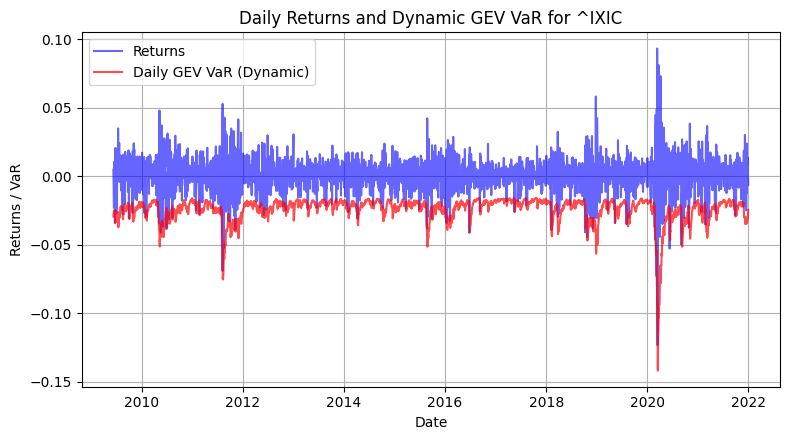

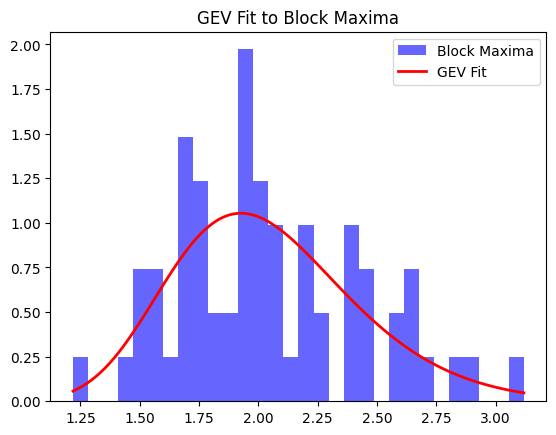

In [ ]:
from scipy.stats import genextreme

block_size = 50
confidence_level = 0.99
gev_params_residuals = {}
var_gev_residuals = {}

for ticker, res in garch_models.items():
    print(f"\nProcessing GEV for standardized residuals of {ticker}...")

    # Extract standardized residuals from GARCH model
    standardized_residuals = res.std_resid

    block_maxima = [max(standardized_residuals[i:i + block_size])
                    for i in range(0, len(standardized_residuals), block_size)]
    block_maxima = np.array(block_maxima)

    #fit GEV to block maxima
    params = genextreme.fit(block_maxima)  # Fit the GEV distribution
    shape, loc, scale = params
    gev_params_residuals[ticker] = params
    print(f"GEV Parameters for {ticker}: Shape={shape:.4f}, Loc={loc:.4f}, Scale={scale:.4f}")

    # calculate GEV-based VaR for standardized residuals dynamically
    conditional_volatility = res.conditional_volatility
    quantile = loc - (scale / shape) * (1 - (-block_size * np.log(1 - alpha)) ** (-shape))
    daily_gev_var = conditional_volatility * quantile

    #daily_gev_var = conditional_volatility * genextreme.ppf(confidence_level, shape, loc=loc, scale=scale)

    # align with time index
    daily_gev_var_series = pd.Series(daily_gev_var, index=conditional_volatility.index)

    # plot returns and GEV-based VaR
    plt.figure(figsize=(8, 4.5))
    plt.plot(returns_df.index, returns_df[ticker], label='Returns', color='blue', alpha=0.6)
    plt.plot(daily_gev_var_series.index, -daily_gev_var_series, label='Daily GEV VaR (Dynamic)', color='red', alpha=0.7)

    plt.title(f"Daily Returns and Dynamic GEV VaR for {ticker}")
    plt.xlabel("Date")
    plt.ylabel("Returns / VaR")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    plt.hist(block_maxima, bins=30, density=True, alpha=0.6, color='blue', label='Block Maxima')
    x = np.linspace(min(block_maxima), max(block_maxima), 100)
    pdf = genextreme.pdf(x, shape, loc=loc, scale=scale)
    plt.plot(x, pdf, 'r-', lw=2, label='GEV Fit')
    plt.legend()
    plt.title("GEV Fit to Block Maxima")
    plt.show()

## Backtesting

In [ ]:
from arch import arch_model
from tqdm import tqdm
from typing import Union, List, Dict
from scipy.stats import chi2
from scipy import stats, optimize
import time

alpha=0.01

# function from vartests library

# Definisce la funzione objective()
#che calcola la log-likelihood per vedere quanto i rendimenti standardizzati assomigliano a una normale standard N
#Confronta la log-likelihood ottimale con quella dell’ipotesi nulla N

def berkowitz_tail_test(
    pnl: pd.DataFrame,
    volatility_window: int = 252,
    var_conf_level: float = 0.99,
    conf_level: float = 0.99,
    random_seed: int = 443,
) -> dict:
    """ verify if conditional distributions of returns
        used in the VaR model is adherent to the data.
            pnl (dataframe):         pnl (distribution of profit and loss) or return
            volatility_window (int): window to calibrate volatility GARCH model
            random_seed (int):       integer value to set seed to random values of the optimizer
        Returns:
            answer (dict):           statistics and decision of the test
    """
    if not isinstance(pnl, pd.DataFrame):
        raise ValueError("Input must be dataframe.")

    print("Normalizing returns...")
    conditional_vol, conditional_mean = pd.DataFrame(), pd.DataFrame()
    for t in tqdm(range(pnl.shape[0] - volatility_window)):
        am = arch_model(
            pnl[t: volatility_window + t],
            vol="GARCH",
            dist="normal",
            rescale=False,
        ).fit(disp="off")
        cond_vol = am.forecast(horizon=1, reindex=False).variance.apply(np.sqrt)
        cond_mean = am.forecast(horizon=1, reindex=False).mean
        conditional_vol = pd.concat([conditional_vol, cond_vol])
        conditional_mean = pd.concat([conditional_mean, cond_mean])

    # standardized returns with unconditional mean and forecasted conditional volatility
    ret_padr = (pnl[volatility_window:].values.flatten() - pnl[volatility_window:].mean().values[0]) / conditional_vol.values.flatten()

    zeta = stats.norm.ppf(stats.norm.cdf(ret_padr))
    zeta[np.isinf(zeta)] = 0

    alpha = 1 - var_conf_level
    significance = 1 - conf_level

    # def objective(x):
    #     p1 = zeta[zeta < stats.norm.ppf(alpha)]
    #     p2 = zeta[zeta >= stats.norm.ppf(alpha)] * 0 + stats.norm.ppf(alpha)
    #     return -(
    #         np.sum(np.log(stats.norm.pdf((p1 - x[0]) / x[1] + epsilon) / x[1] + epsilon)) +
    #         np.sum(np.log(1 - stats.norm.cdf((p2 - x[0]) / x[1] + epsilon)))
    #     )

    def objective(x):
        epsilon = 1e-10  # Small value to prevent log(0)
        p1 = zeta[zeta < stats.norm.ppf(alpha)]
        p2 = zeta[zeta >= stats.norm.ppf(alpha)] * 0 + stats.norm.ppf(alpha)

        term1 = np.maximum(stats.norm.pdf((p1 - x[0]) / x[1]) / x[1], epsilon)
        term2 = np.maximum(1 - stats.norm.cdf((p2 - x[0]) / x[1]), epsilon)

        return -(
            np.sum(np.log(term1)) +
            np.sum(np.log(term2))
    )

    print("Optimizing...")
    start = time.time()

    np.random.seed(random_seed)
    bounds = [(-10, 10), (0.01, 3)]
    initial_guess = np.random.uniform(low=[-10, 0.01], high=[10, 3])

    result = optimize.minimize(
        fun=objective,
        x0=initial_guess,
        bounds=bounds,
        method='L-BFGS-B',
        options={'maxiter': 100, 'disp': False}
    )

    print(f"Elapsed time: {time.time() - start} s")

    best_solution = result.x
    uLL = -result.fun
    rLL = -objective([0, 1])
    LR = 2 * (uLL - rLL)
    chid = 1 - stats.chi2.cdf(LR, 2)

    decision = "Reject H0" if chid < significance else "Fail to Reject H0"
    H0 = "Distribution is Normal(0,1)"

    answer = {
        "solution": best_solution,
        "ull": uLL,
        "rll": rLL,
        "LR": LR,
        "chi square test": chid,
        "null hypothesis": H0,
        "decision": decision,
    }

    return answer


def tuff_test(violations, alpha):
    """
    TUFF Test Implementation: Time Until First Failure.
    - violations (array-like): Binary sequence of violations (1 = violation, 0 = no violation).
    - alpha (float): Confidence level for VaR (e.g., 0.01 for 99%).
    """
    pVaR = alpha  # Failure probability  # woul be  1- varlevel in  matlab
    if 1 not in violations.values:
        n = len(violations) + 1
        LRatioTUFF = -2 * (np.log(pVaR) + (n - 1) * np.log(1 - pVaR) + n * np.log(n) - (n - 1) * np.log(n - 1))
        p_value = 1 - chi2.cdf(LRatioTUFF, df=1)
        return {
            "time_to_failure": n,  # include 'time_to_failure' for consistency
            "likelihood_ratio": LRatioTUFF,
            "p_value": p_value,
            "decision": "Reject"
        }
    # time to first failure
    n = np.argmax(violations.values) + 1
    if n == 1:
        LRatioTUFF = -2 * np.log(pVaR)
    else:
        LRatioTUFF = -2 * (np.log(pVaR) + (n - 1) * np.log(1 - pVaR) + n * np.log(n) - (n - 1) * np.log(n - 1))

    # p-value based on chi-squared distribution
    p_value = 1 - chi2.cdf(LRatioTUFF, df=1)

    # decision
    decision = "Reject" if p_value < 0.05 else "Accept"

    return {
        "time_to_failure": n,
        "likelihood_ratio": LRatioTUFF,
        "p_value": p_value,
        "decision": decision
    }


def engle_manganelli_test(returns, var, alpha, lags=1):
    """
    - lags: Number of lags to include in the test.
    - dict: Contains test statistic and p-value.
    """
    # compute the vector Hit_t - alpha
    hits = ((returns < -var).astype(int) - alpha)

    # matrix of data with lags
    data = pd.DataFrame({"Hit": hits, "VaR": var})
    for i in range(1, lags + 1):
        data[f"Hit_lag_{i}"] = data["Hit"].shift(i)
        #data[f"VaR_lag_{i}"] = data["VaR"].shift(i)

    data = data.dropna()

    # matrix  Z and vector y
    Z = data[[f"Hit_lag_{i}" for i in range(1, lags + 1)] ].values
             #+ [f"VaR_lag_{i}" for i in range(1, lags + 1)]].values
    y = data["Hit"].values


    print(f"Matrix Z for ticker:")
    print(pd.DataFrame(Z, columns=[f"Hit_lag_{i}" for i in range(1, lags + 1)] ))
                                     #+ [f"VaR_lag_{i}" for i in range(1, lags + 1)]))
    print(f"Rank of Z: {np.linalg.matrix_rank(Z)}, Number of columns : {Z.shape[1]}")

    if np.linalg.matrix_rank(Z) < Z.shape[1]:   # control to see if the matrix is singular then there is multicollinearity
        print("Warning: Matrix Z is singular or poorly conditioned.")
        return {"test_statistic": np.nan, "p_value": np.nan}

    # Standardization of   Z
    Z = (Z - Z.mean(axis=0)) / Z.std(axis=0)

    # estimate of coefficients
    try:
        beta_hat = np.linalg.inv(Z.T @ Z) @ (Z.T @ y)
    except np.linalg.LinAlgError:
        print("Error: Singular matrix encountered during inversion.")
        return {"test_statistic": np.nan, "p_value": np.nan}

    residuals = y - Z @ beta_hat
    sigma2 = residuals.var()

    # test statistic
    DQ_statistic = beta_hat.T @ Z.T @ Z @ beta_hat / (alpha * (1 - alpha))
    p_value = 1 - chi2.cdf(DQ_statistic, df=Z.shape[1])

    return {"test_statistic": DQ_statistic, "p_value": p_value}


def christoffersen_test(tot_returns_out, violations, confidence_level=0.99):
    n = len(tot_returns_out)
    confidence_level = 0.99
    # Check for insufficient data
    if n == 0 or np.sum(violations) == 0 or np.sum(violations) == n:
        return {
            "Unconditional Coverage": {"LR Statistic": np.nan, "p-value": np.nan, "Decision": "Insufficient Violations"},
            "Independence": {"LR Statistic": np.nan, "p-value": np.nan, "Decision": "Insufficient Violations"},
            "Conditional Coverage": {"LR Statistic": np.nan, "p-value": np.nan, "Decision": "Insufficient Violations"}}
    # Total number of violations
    num_violations = np.sum(violations)
    p_var = 1 - confidence_level
    epsilon = 1e-8

    # Unconditional Coverage Test (Kupiec)
    pi_hat = num_violations / n
    #L_unconditional = (p_var ** num_violations) * ((1 - p_var) ** (n - num_violations))    # this formulation did not work
    #L_restricted = (pi_hat ** num_violations) * ((1 - pi_hat) ** (n - num_violations))
    #lr_uc = -2 * (np.log(L_unconditional) + 2*np.log(L_restricted))
    # Debug Print intermediate results
    lr_uc = -2 *(num_violations * np.log(p_var ) + (n- num_violations)* np.log(1 - p_var) ) +2*( (n - num_violations)* np.log((1 - pi_hat))
    + num_violations * np.log(pi_hat ))
    print(f"Unconditional Coverage:  lr_uc={lr_uc}")
    p_value_uc = 1 - chi2.cdf(lr_uc, df=1)

    # Transition Counts for Independence Test
    n00, n01, n10, n11 = 0, 0, 0, 0

    # Iterate over the violations vector
    for i in range(1, len(violations)):
        if violations.iloc[i - 1] == 0 and violations.iloc[i] == 0:
            n00 += 1
        elif violations.iloc[i - 1] == 0 and violations.iloc[i] == 1:
            n01 += 1
        elif violations.iloc[i - 1] == 1 and violations.iloc[i] == 0:
            n10 += 1
        elif violations.iloc[i - 1] == 1 and violations.iloc[i] == 1:
            n11 += 1

    # Add epsilon for numerical stability
    n00 += epsilon
    n01 += epsilon
    n10 += epsilon
    n11 += epsilon
    #  Print transition counts
    print(f"Transitions: n00={n00}, n01={n01}, n10={n10}, n11={n11}")
    # Probabilities of Transitions
    p_01 = (n01 +epsilon) / (n00 + n01 + epsilon)
    p_11 = (n11 +epsilon)/ (n10 + n11 + epsilon)
    p = num_violations / n

    # Likelihoods for Independence Test
    L_m = ((1 - p_01 +epsilon ) ** n00) * ((p_01+epsilon ) ** n01) * ((1 - p_11+epsilon ) ** n10) * ((p_11 +epsilon ) ** n11)
    L_b =( (1 - p +epsilon  ) ** (n00 + n10) ) * ((p +epsilon ) ** (n01 + n11))

    print(f"Likelihoods: L_m={L_m}, L_b={L_b}")
    # Log-Likelihood Ratio for Independence Test
    lr_ind =  (2*np.log(L_m) - 2* np.log(L_b)) if L_m > 0 and L_b > 0 else np.nan
    # Conditional Coverage Test
    lr_cc = lr_uc + (lr_ind if not np.isnan(lr_ind) else 0)

    # P-Values
    p_value_uc = 1 - chi2.cdf(lr_uc, df=1)
    p_value_ind = 1 - chi2.cdf(lr_ind, df=1) if not np.isnan(lr_ind) else np.nan
    p_value_cc = 1 - chi2.cdf(lr_cc, df=2) if not np.isnan(lr_ind) else np.nan

    return {
        "Unconditional Coverage": {
            "LR Statistic": lr_uc,
            "p-value": p_value_uc,
            "Decision": "Reject H0" if p_value_uc < 0.05 else "Fail to Reject H0"
        },
        "Independence": {
            "LR Statistic": lr_ind,
            "p-value": p_value_ind,
            "Decision": "Reject H0" if p_value_ind < 0.05 else "Fail to Reject H0"
        },
        "Conditional Coverage": {
            "LR Statistic": lr_cc,
            "p-value": p_value_cc,
            "Decision": "Reject H0" if p_value_cc < 0.05 else "Fail to Reject H0"
        }
    }


def kupiec_test(violations_series, confidence_level=0.99):
    """
    Parameters:
    - violations_series (pd.Series): Series containing 0 (no violation) and 1 (violation).
    - confidence_level (float): Expected confidence level of the VaR model (default: 0.99).

    Returns:
    - dict: A dictionary containing the test statistic, p-value, and test decision.
    """

    num_violations = violations_series.sum()
    # Total number of observations
    n = len(violations_series)

    # Check for insufficient data
    if n == 0 or num_violations == 0 or num_violations == n:
        return {
            "LR Statistic": np.nan,
            "p-value": np.nan,
            "Decision": "Insufficient Violations"
        }

    # Expected violation probability
    p_var = 1 - confidence_level
    # Estimated violation probability from the sample
    pi_hat = num_violations / n

    # Log-likelihood calculations
    L_unrestricted = (pi_hat ** num_violations) * ((1 - pi_hat) ** (n - num_violations))
    L_restricted = (p_var ** num_violations) * ((1 - p_var) ** (n - num_violations))

    # Kupiec Likelihood Ratio test statistic
    lr_stat = -2 * (np.log(L_restricted) - np.log(L_unrestricted))

    # Compute p-value for the test (chi-squared distribution with 1 degree of freedom)
    p_value = 1 - chi2.cdf(lr_stat, df=1)

    # Decision based on a 5% significance level
    decision = "Reject H0" if p_value < 0.05 else "Fail to Reject H0"

    return {
        "LR Statistic": lr_stat,
        "p-value": p_value,
        "Decision": decision
    }

def failure_rate_fun(violations: Union[List[int], pd.Series, pd.DataFrame]) -> Dict:
    if isinstance(violations, pd.core.series.Series) or isinstance(
        violations, pd.core.frame.DataFrame
    ):
        N = violations.sum()
    elif isinstance(violations, List) or isinstance(violations, np.ndarray):
        N = sum(violations)
    else:
        raise ValueError("Input must be list, array, series or dataframe.")
    TN = len(violations)

    answer = {"failure rate": N / TN}
    print(f"Failure rate of {round((N/TN)*100,2)}%")
    return answer


## backtesting historical

In [ ]:
# Dictionary
garch_models = {}

for ticker in returns_df.columns:
    # print(f"Adattamento del modello GARCH per {ticker}...")
    returns = returns_df[ticker].dropna().iloc[:-300]
    # model = arch_model(returns, mean='Zero', vol='Garch', p=2, q=2, dist='t')
    model = arch_model(returns, mean='Zero', vol='EGarch', p=1, q=1, dist='t', rescale=False)
    res = model.fit(update_freq=5, disp='off')
    garch_models[ticker] = res
    # print(res.summary())

from scipy.stats import genextreme

block_size = 50
confidence_level = 0.99
gev_params_residuals = {}
var_gev_residuals = {}

for ticker, res in garch_models.items():
    print(f"\nProcessing GEV for standardized residuals of {ticker}...")

    # Extract standardized residuals from GARCH model
    standardized_residuals = res.std_resid
    print(len(standardized_residuals))
    num_blocks = len(standardized_residuals) // block_size
    block_maxima = [max(standardized_residuals[i * block_size:(i + 1) * block_size])
                    for i in range(num_blocks)]
    block_maxima = np.array(block_maxima)

    # Validate block maxima length
    if len(block_maxima) < 10:
        print(f"Warning: Too few block maxima ({len(block_maxima)}) for reliable GEV fitting.")
        continue

    # Fit GEV to block maxima
    try:
        params = genextreme.fit(block_maxima)
    except RuntimeError as e:
        print(f"GEV fitting failed for {ticker}: {e}")
        continue

    shape, loc, scale = params
    gev_params_residuals[ticker] = params
    print(f"GEV Parameters for {ticker}: Shape={shape:.4f}, Loc={loc:.4f}, Scale={scale:.4f}")

    # Calculate GEV-based VaR for standardized residuals dynamically
    conditional_volatility = res.conditional_volatility
    if abs(shape) < 1e-4:
        print("Warning: Shape parameter is close to zero. Using alternative formula.")
        # quantile = loc - scale * np.log(-block_size * np.log(1 - confidence_level))
        quantile = loc - scale * np.log(-block_size * np.log(1 - alpha))
    else:
        quantile = loc - (scale / shape) * (1 - (-block_size * np.log(1 - alpha)) ** (-shape))

    print(quantile)
    daily_gev_var = conditional_volatility * quantile


    # Align with time index
    daily_gev_var_series = pd.Series(daily_gev_var, index=conditional_volatility.index).reindex(returns_df[ticker].iloc[:-300].index, method='ffill')
    # print(len(daily_gev_var))
    # Plot results
    # plt.figure(figsize=(8, 4.5))
    # plt.plot(returns_df.iloc[:-300].index, returns_df[ticker].iloc[:-300], label='Returns', color='blue', alpha=0.6)
    # plt.plot(daily_gev_var_series.index, -daily_gev_var_series, label='Daily GEV VaR (Dynamic)', color='red', alpha=0.7)
    # plt.title(f"Daily Returns and Dynamic GEV VaR for {ticker}")
    # plt.xlabel("Date")
    # plt.ylabel("Returns / VaR")
    # plt.legend()
    # plt.grid(True)
    # plt.tight_layout()
    # plt.show()



Processing GEV for standardized residuals of AMZN...
2863
GEV Parameters for AMZN: Shape=-0.4214, Loc=2.1795, Scale=0.8888
2.710402909235314

Processing GEV for standardized residuals of DIS...
2863
GEV Parameters for DIS: Shape=-0.3328, Loc=2.1077, Scale=0.6123
2.4843277209302044

Processing GEV for standardized residuals of AAPL...
2863
GEV Parameters for AAPL: Shape=-0.2984, Loc=2.2263, Scale=0.6617
2.6379032583603523

Processing GEV for standardized residuals of MSFT...
2863
GEV Parameters for MSFT: Shape=-0.3259, Loc=2.2201, Scale=0.7316
2.6710974219691463

Processing GEV for standardized residuals of JPM...
2863
GEV Parameters for JPM: Shape=-0.0486, Loc=2.2118, Scale=0.5952
2.6145866516677088

Processing GEV for standardized residuals of F...
2863
GEV Parameters for F: Shape=-0.1567, Loc=2.0240, Scale=0.6352
2.438386489610986

Processing GEV for standardized residuals of PG...
2863
GEV Parameters for PG: Shape=-0.2934, Loc=2.0955, Scale=0.5909
2.4636839392953145

Processing GEV

## Backtesting historical VaR


Running Rolling Window Historical VaR for AMZN...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 38.45it/s]


Optimizing...
Elapsed time: 0.041745901107788086 s
Unconditional Coverage:  lr_uc=7.89705790666342
Transitions: n00=281.00000001, n01=9.00000001, n10=9.00000001, n11=1e-08
Likelihoods: L_m=3.7952600812508155e-18, L_b=2.8700984904061123e-18
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


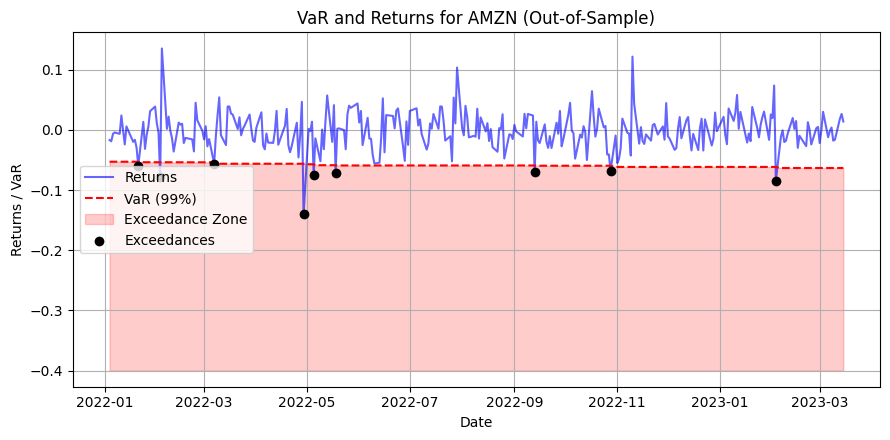


Running Rolling Window Historical VaR for DIS...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.13it/s]


Optimizing...
Elapsed time: 0.04424619674682617 s
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=291.00000001, n01=4.00000001, n10=4.00000001, n11=1e-08
Likelihoods: L_m=6.362202979374106e-10, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


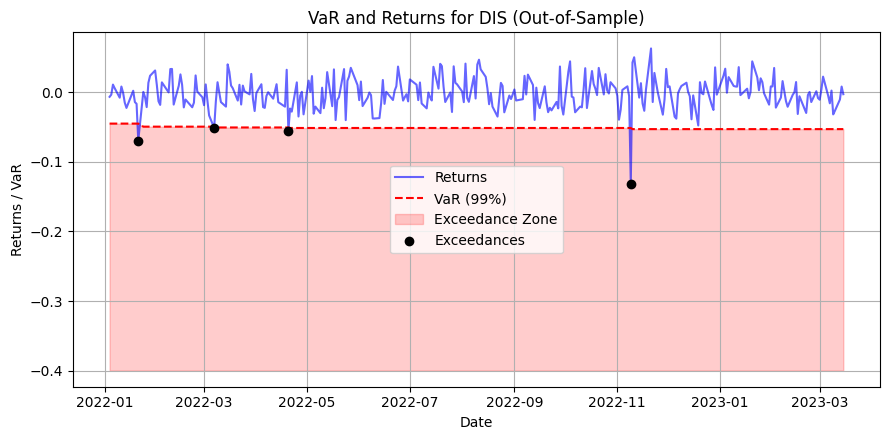


Running Rolling Window Historical VaR for AAPL...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 39.33it/s]


Optimizing...
Elapsed time: 0.036069631576538086 s
Unconditional Coverage:  lr_uc=0.0
Transitions: n00=293.00000001, n01=3.00000001, n10=3.00000001, n11=1e-08
Likelihoods: L_m=5.2629898452856685e-08, L_b=5.1052870077377365e-08
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


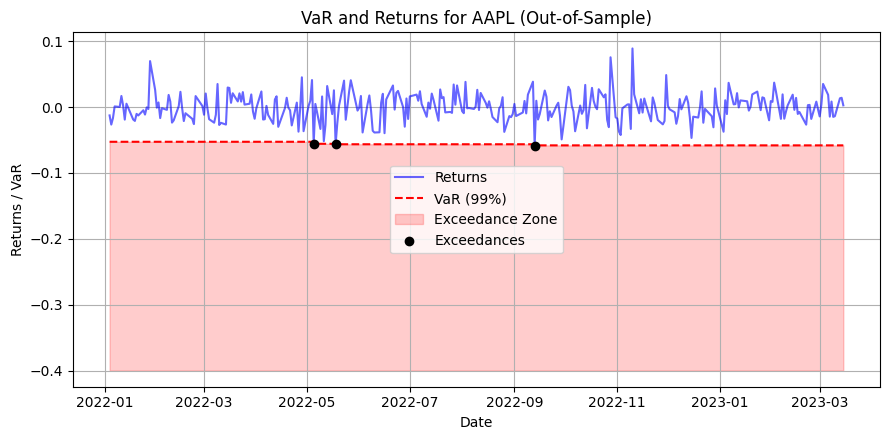


Running Rolling Window Historical VaR for MSFT...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.19it/s]


Optimizing...
Elapsed time: 0.058068037033081055 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


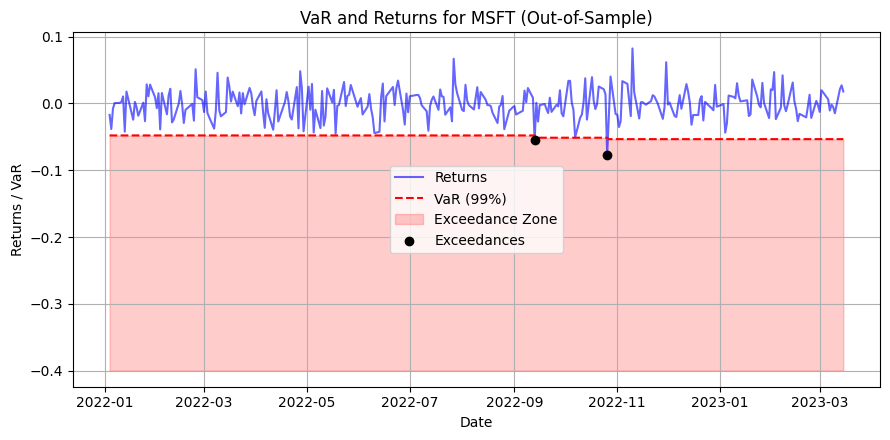


Running Rolling Window Historical VaR for JPM...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.75it/s]


Optimizing...
Elapsed time: 0.03733253479003906 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


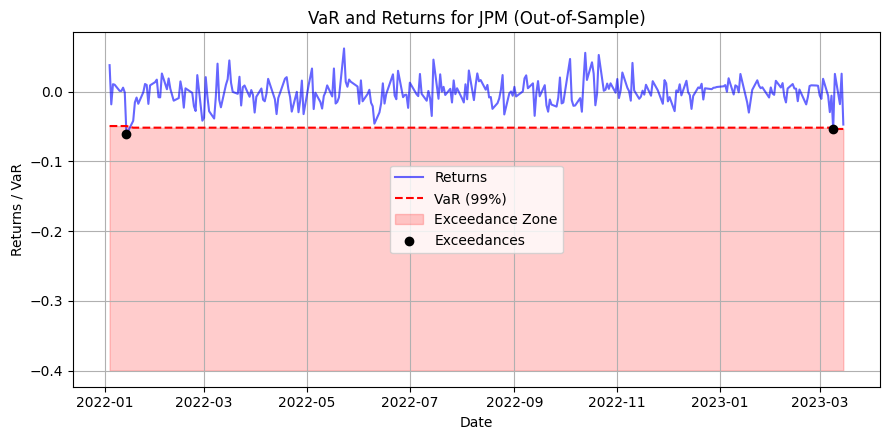


Running Rolling Window Historical VaR for F...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.42it/s]


Optimizing...
Elapsed time: 0.04782676696777344 s
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=291.00000001, n01=4.00000001, n10=4.00000001, n11=1e-08
Likelihoods: L_m=6.362202979374106e-10, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


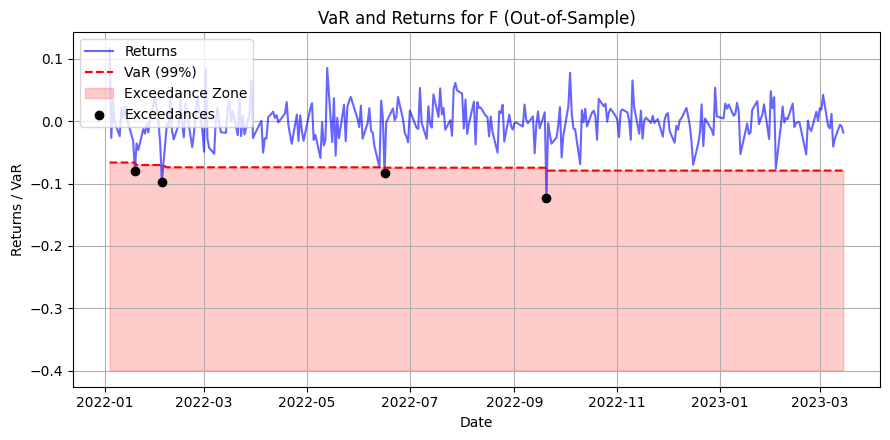


Running Rolling Window Historical VaR for PG...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 41.60it/s]


Optimizing...
Elapsed time: 0.05040478706359863 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


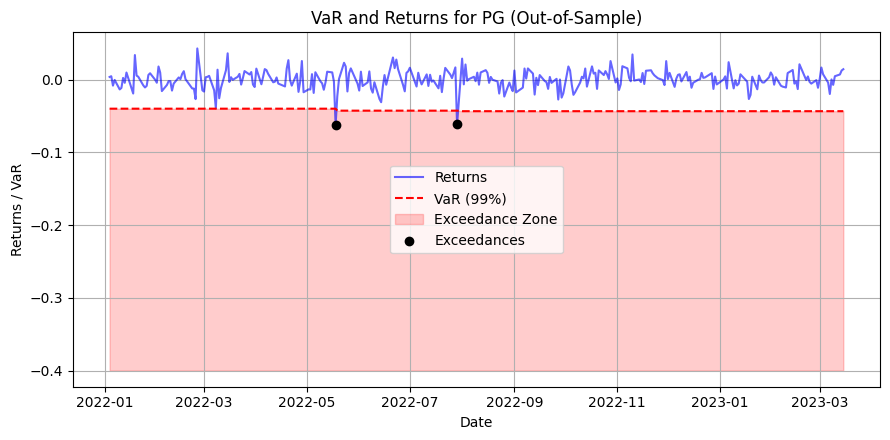


Running Rolling Window Historical VaR for ^GSPC...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.44it/s]


Optimizing...
Elapsed time: 0.039095401763916016 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


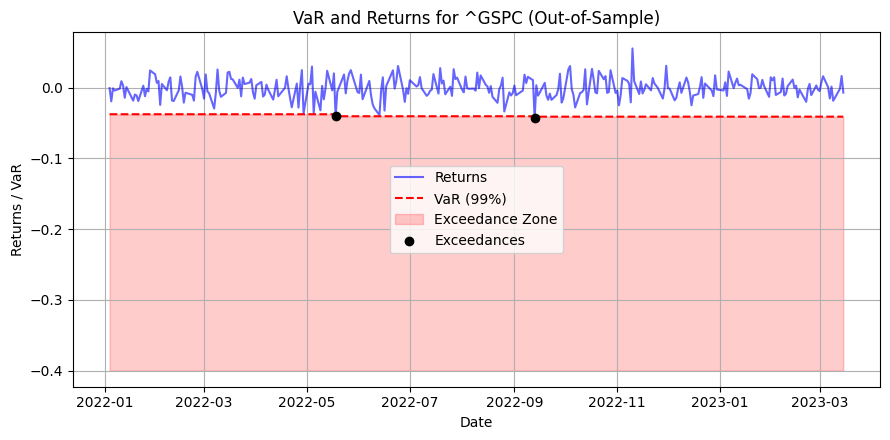


Running Rolling Window Historical VaR for ^IXIC...
Normalizing returns...


100%|██████████| 48/48 [00:02<00:00, 20.60it/s]


Optimizing...
Elapsed time: 0.06964111328125 s
Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=289.00000001, n01=5.00000001, n10=5.00000001, n11=1e-08
Likelihoods: L_m=1.0004926615874929e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


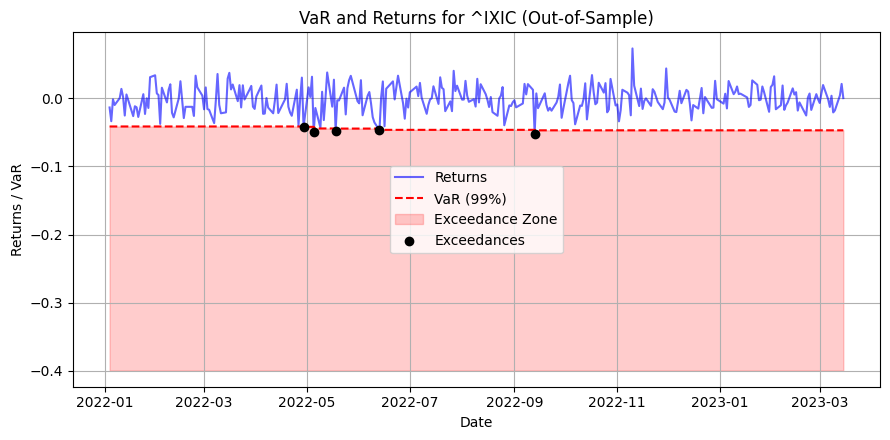


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 7.897057906663406, 'p-value': 0.004951527026856306, 'Decision': 'Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Failure Rate: 3.00%
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 7.89705790666342, 'p-value': 0.004951527026856195, 'Decision': 'Reject H0'}, 'Independence': {'LR Statistic': 0.5588131894217412, 'p-value': 0.45473882215883066, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 8.455871096085161, 'p-value': 0.014582464291787, 'Decision': 'Reject H0'}}
Engle Manganelli Test: {'test_statistic': 0.29423617231221205, 'p_value': 0.8631920403677323}
TUFF Test: {'time_to_failure': 13, 'likelihood_ratio': 2.4006247333722683, 'p_value': 0.12128680527744895,

In [ ]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

# Parameters
rolling_window_size = 252  # Length of the rolling window
confidence_level = 0.99
alpha = 1 - confidence_level

# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]


def rolling_historical_var_forecast(returns_df, out_of_sample_returns_df, rolling_window=252, confidence_level=0.99):
    historical_var_predictions = {}
    backtest_results = {}

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nRunning Rolling Window Historical VaR for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Use only historical in-sample data
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna()

        rolling_predictions = []

        # Initialize the rolling window with in-sample data
        historical_data = returns_in_sample.copy()

        for t in range(len(returns_out_of_sample)):
            # Use only the last rolling_window data points
            train_data = historical_data[-rolling_window:].dropna()

            # Calculate historical VaR
            var = np.percentile(train_data, alpha * 100)
            rolling_predictions.append(var)

            # Update the rolling window with new data
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]]).iloc[-rolling_window:]

        # Align forecasts with out-of-sample dates
        prediction_index = returns_out_of_sample.index[:len(rolling_predictions)]
        VaR_predictions = pd.Series(rolling_predictions, index=prediction_index, name="VaR")

        aligned_returns = returns_out_of_sample.reindex(VaR_predictions.index)
        violations_hist_var = (aligned_returns < VaR_predictions).astype(int)

        historical_var_predictions[ticker] = {
            "VaR": VaR_predictions,
            "aligned_returns": aligned_returns,
        }

        pnl_var_df = pd.DataFrame({
            "PnL": aligned_returns,
            "VaR": VaR_predictions,
            "Violations": violations_hist_var
        })

        # Backtesting results
        kupiec_result_hist_var = kupiec_test(pnl_var_df["Violations"], confidence_level)
        berkowitz_result_hist_var = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)
        failure_rate_hist_var = violations_hist_var.mean()
        christoffersen_result_hist_var = christoffersen_test(aligned_returns, violations_hist_var, confidence_level)
        engle_manganelli_result_hist_var = engle_manganelli_test(aligned_returns, VaR_predictions, alpha, lags=2)
        tuff_result_hist_var = tuff_test(violations_hist_var, alpha)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_hist_var,
            'berkowitz_result': berkowitz_result_hist_var,
            'failure_rate': failure_rate_hist_var,
            'christoffersen_result': christoffersen_result_hist_var,
            'engle_manganelli_result': engle_manganelli_result_hist_var,
            'tuff_result': tuff_result_hist_var
        }

        # Plot returns vs VaR with exceedances
        plt.figure(figsize=(9, 4.5))
        plt.plot(aligned_returns.index, aligned_returns, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return historical_var_predictions, backtest_results

historical_var_results, backtest_results = rolling_historical_var_forecast(returns_df, out_of_sample_returns_df, rolling_window=1000, confidence_level=0.99)

for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Engle Manganelli Test: {results['engle_manganelli_result']}")
    print(f"TUFF Test: {results['tuff_result']}")

## Backtesting EVT VaR


Running Rolling Window EVT VaR for AMZN...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 39.88it/s]


Optimizing...
Elapsed time: 0.03719615936279297 s
Unconditional Coverage:  lr_uc=7.89705790666342
Transitions: n00=282.00000001, n01=8.00000001, n10=8.00000001, n11=1.00000001
Likelihoods: L_m=5.4461416596830075e-18, L_b=2.8700984904061123e-18
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


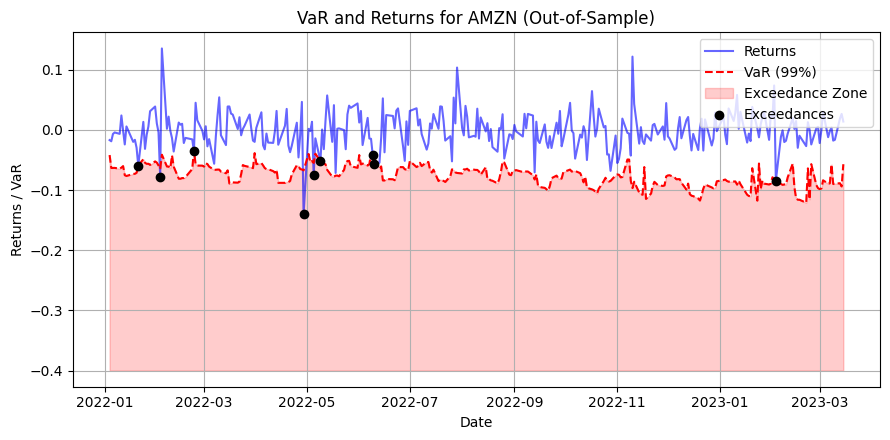


Running Rolling Window EVT VaR for DIS...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.73it/s]


Optimizing...
Elapsed time: 0.05039334297180176 s
Unconditional Coverage:  lr_uc=3.916285591040321
Transitions: n00=285.00000001, n01=7.00000001, n10=7.00000001, n11=1e-08
Likelihoods: L_m=4.515243980986244e-15, L_b=3.817498110710495e-15
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


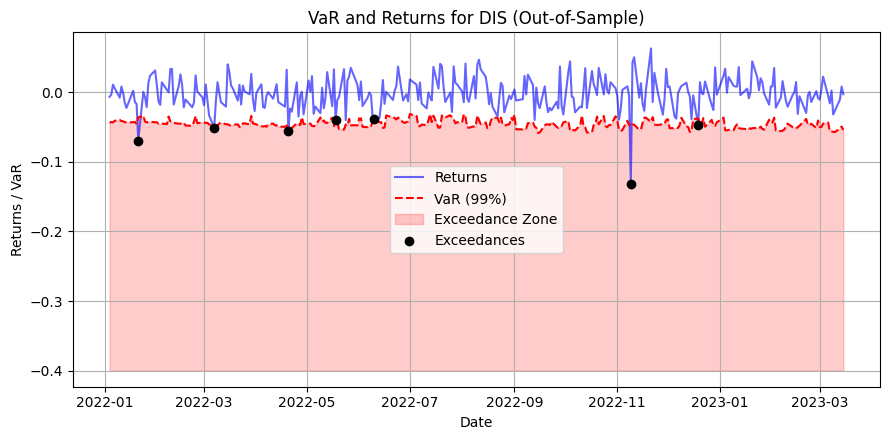


Running Rolling Window EVT VaR for AAPL...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 39.49it/s]


Optimizing...
Elapsed time: 0.04197406768798828 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


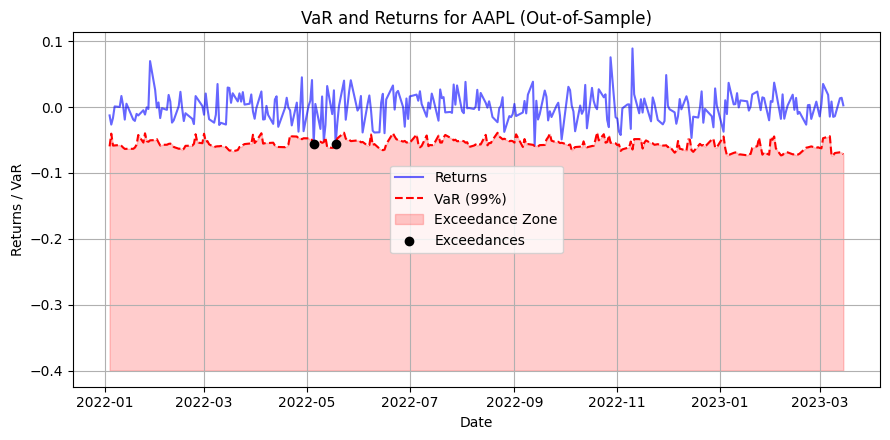


Running Rolling Window EVT VaR for MSFT...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 41.12it/s]


Optimizing...
Elapsed time: 0.04676628112792969 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


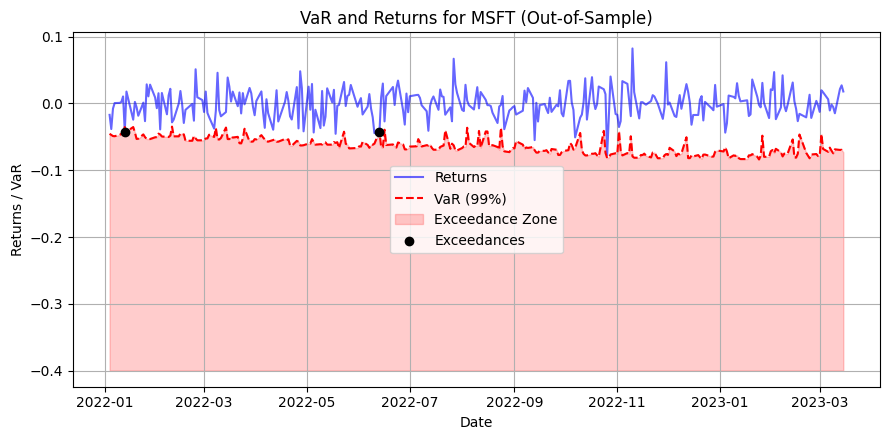


Running Rolling Window EVT VaR for JPM...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 42.23it/s]


Optimizing...
Elapsed time: 0.04929757118225098 s
Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=290.00000001, n01=4.00000001, n10=4.00000001, n11=1.00000001
Likelihoods: L_m=5.283682696897355e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


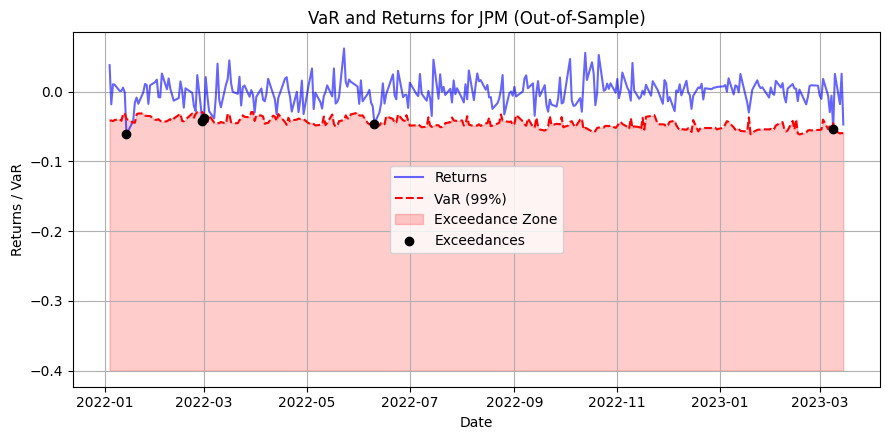


Running Rolling Window EVT VaR for F...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 36.14it/s]


Optimizing...
Elapsed time: 0.048482656478881836 s
Unconditional Coverage:  lr_uc=3.916285591040321
Transitions: n00=285.00000001, n01=7.00000001, n10=7.00000001, n11=1e-08
Likelihoods: L_m=4.515243980986244e-15, L_b=3.817498110710495e-15
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


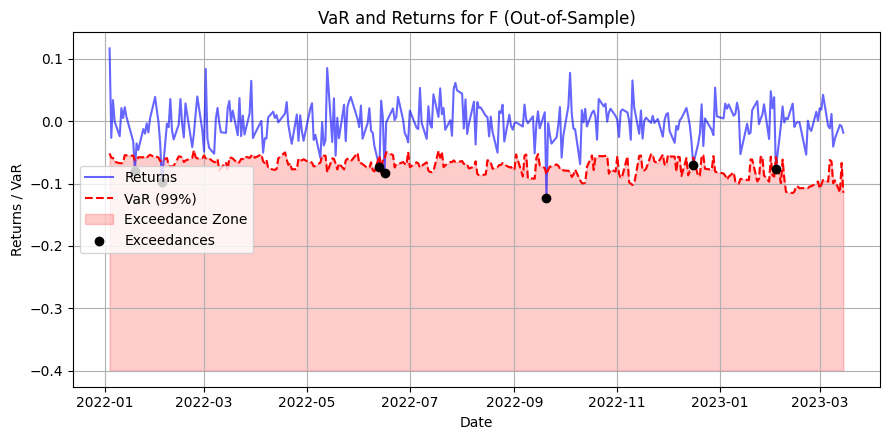


Running Rolling Window EVT VaR for PG...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 41.04it/s]


Optimizing...
Elapsed time: 0.04883432388305664 s
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=291.00000001, n01=4.00000001, n10=4.00000001, n11=1e-08
Likelihoods: L_m=6.362202979374106e-10, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


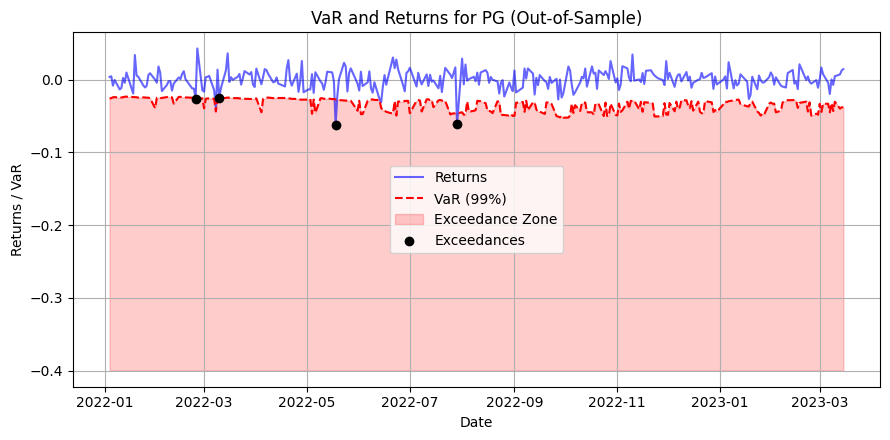


Running Rolling Window EVT VaR for ^GSPC...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 36.06it/s]


Optimizing...
Elapsed time: 0.055938720703125 s
Unconditional Coverage:  lr_uc=21.54499354033166
Transitions: n00=272.00000001, n01=13.00000001, n10=13.00000001, n11=1.00000001
Likelihoods: L_m=3.081016520657655e-25, L_b=2.8239652891514615e-25
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


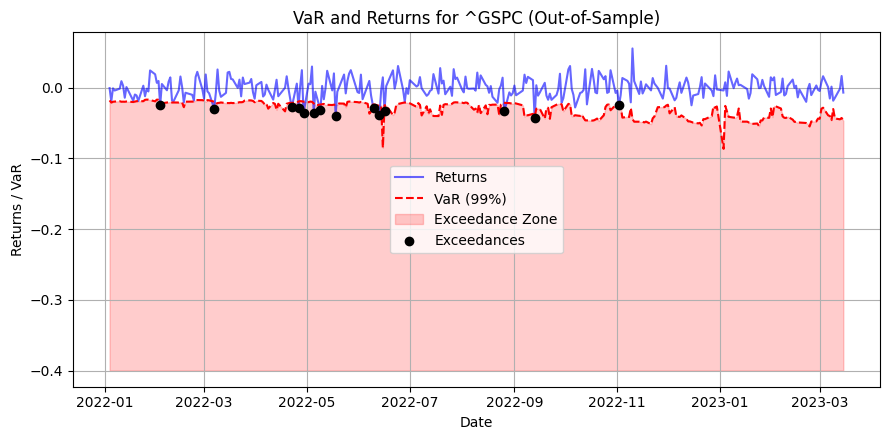


Running Rolling Window EVT VaR for ^IXIC...
Normalizing returns...


100%|██████████| 48/48 [00:00<00:00, 48.40it/s]


Optimizing...
Elapsed time: 0.03829836845397949 s
Unconditional Coverage:  lr_uc=3.916285591040321
Transitions: n00=286.00000001, n01=6.00000001, n10=6.00000001, n11=1.00000001
Likelihoods: L_m=1.1246675055458487e-14, L_b=3.817498110710495e-15
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


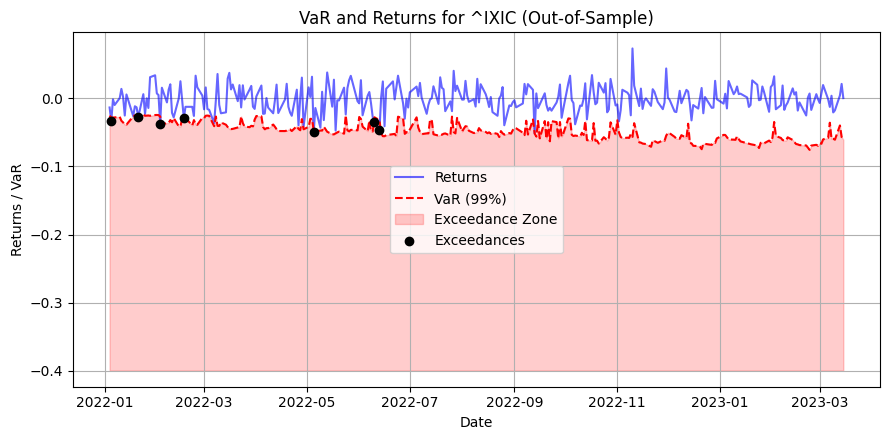


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 7.897057906663406, 'p-value': 0.004951527026856306, 'Decision': 'Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Failure Rate: 3.00%
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 7.89705790666342, 'p-value': 0.004951527026856195, 'Decision': 'Reject H0'}, 'Independence': {'LR Statistic': 1.2811221184188497, 'p-value': 0.2576905005904633, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 9.17818002508227, 'p-value': 0.010162101552111724, 'Decision': 'Reject H0'}}
Engle Manganelli Test: {'test_statistic': 0.06268439659996483, 'p_value': 0.9691438769392087}
TUFF Test: {'time_to_failure': 13, 'likelihood_ratio': 2.4006247333722683, 'p_value': 0.12128680527744895

In [ ]:
from scipy.stats import genextreme

# Parameters
rolling_window_size = 252  # Length of the rolling window
confidence_level = 0.99
alpha = 1 - confidence_level

# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]

def rolling_evt_var_forecast(returns_df, out_of_sample_returns_df, block_size=50, rolling_window=252, confidence_level=0.99):
    evt_var_predictions = {}
    backtest_results = {}

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nRunning Rolling Window EVT VaR for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Use only historical in-sample data
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna()

        rolling_predictions = []

        # Initialize the rolling window with in-sample data
        historical_data = returns_in_sample.copy()

        for t in range(len(returns_out_of_sample)):
            # Use only the last rolling_window data points
            train_data = historical_data[-rolling_window:].dropna()

            # # Fit GEV to block maxima
            block_size = 21
            block_maxima = []
            for start_idx in range(0, len(train_data), block_size):
                block = -train_data[start_idx : start_idx + block_size]
                block_maxima.append(block.max())

            shape, loc, scale = genextreme.fit(block_maxima)

            # Calculate EVT-based VaR
            if abs(shape) < 1e-4:
                quantile = loc - scale * np.log(-np.log(1 - alpha))
            else:
                quantile = loc - (scale / shape) * (1 - (-np.log(1 - alpha)) ** (-shape))

            daily_evt_var = quantile
            rolling_predictions.append(-daily_evt_var)

            # Update the rolling window with new data
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]]).iloc[-rolling_window:]

        # Align forecasts with out-of-sample dates
        prediction_index = returns_out_of_sample.index[:len(rolling_predictions)]
        VaR_predictions = pd.Series(rolling_predictions, index=prediction_index, name="VaR")

        aligned_returns = returns_out_of_sample.reindex(VaR_predictions.index)
        violations_evt_var = (aligned_returns < VaR_predictions).astype(int)


        evt_var_predictions[ticker] = {
            "VaR": VaR_predictions,
            "aligned_returns": aligned_returns,
        }
        pnl_var_df = pd.DataFrame({
            "PnL": aligned_returns,
            "VaR": VaR_predictions,
            "Violations": violations_evt_var
        })

        # Backtesting results
        kupiec_result_evt_var = kupiec_test(pnl_var_df["Violations"], confidence_level)
        berkowitz_result_evt_var = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)
        failure_rate_evt_var = violations_evt_var.mean()
        christoffersen_result_evt_var = christoffersen_test(aligned_returns, violations_evt_var, confidence_level)
        engle_manganelli_result_evt_var = engle_manganelli_test(aligned_returns, VaR_predictions, alpha, lags=2)
        tuff_result_evt_var = tuff_test(violations_evt_var, alpha)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_evt_var,
            'berkowitz_result': berkowitz_result_evt_var,
            'failure_rate': failure_rate_evt_var,
            'christoffersen_result': christoffersen_result_evt_var,
            'engle_manganelli_result': engle_manganelli_result_evt_var,
            'tuff_result': tuff_result_evt_var
        }

        # Plot returns vs VaR with exceedances
        plt.figure(figsize=(9, 4.5))
        plt.plot(aligned_returns.index, aligned_returns, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return evt_var_predictions, backtest_results

evt_var_results, backtest_results = rolling_evt_var_forecast(returns_df, out_of_sample_returns_df, block_size=21, rolling_window=1000, confidence_level=0.99)

for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Engle Manganelli Test: {results['engle_manganelli_result']}")
    print(f"TUFF Test: {results['tuff_result']}")

## Backtesting generalized pareto VaR


Running Rolling Window Pareto VaR for AMZN...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 30.88it/s]


Optimizing...
Elapsed time: 0.0558013916015625 s
Unconditional Coverage:  lr_uc=5.777919512087607
Transitions: n00=283.00000001, n01=8.00000001, n10=8.00000001, n11=1e-08
Likelihoods: L_m=1.2229925551041317e-16, L_b=9.814701051165846e-17
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


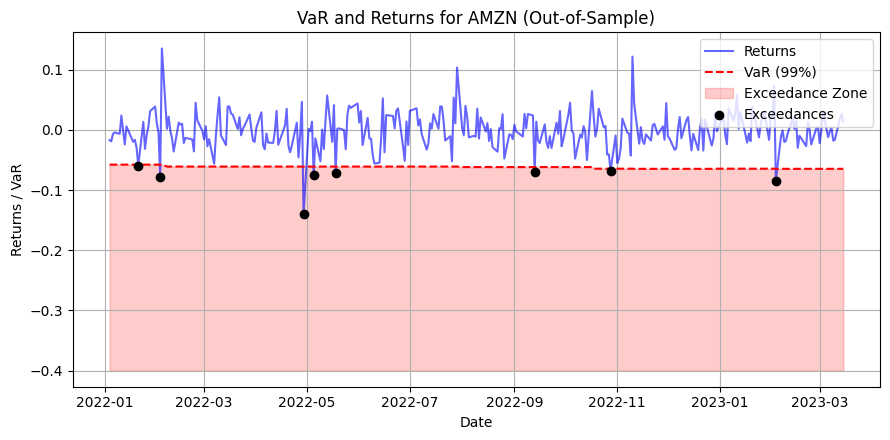


Running Rolling Window Pareto VaR for DIS...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 34.45it/s]


Optimizing...
Elapsed time: 0.049544572830200195 s
Unconditional Coverage:  lr_uc=0.0
Transitions: n00=293.00000001, n01=3.00000001, n10=3.00000001, n11=1e-08
Likelihoods: L_m=5.2629898452856685e-08, L_b=5.1052870077377365e-08
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


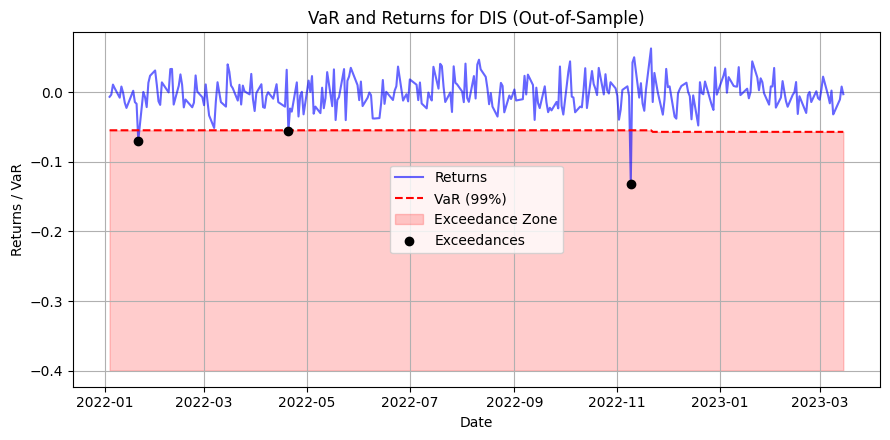


Running Rolling Window Pareto VaR for AAPL...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 38.98it/s]


Optimizing...
Elapsed time: 0.04281258583068848 s
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


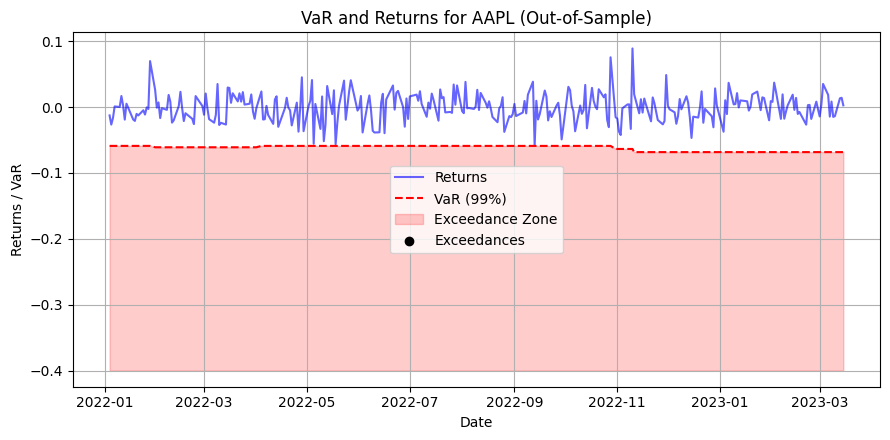


Running Rolling Window Pareto VaR for MSFT...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 41.23it/s]


Optimizing...
Elapsed time: 0.04076743125915527 s
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


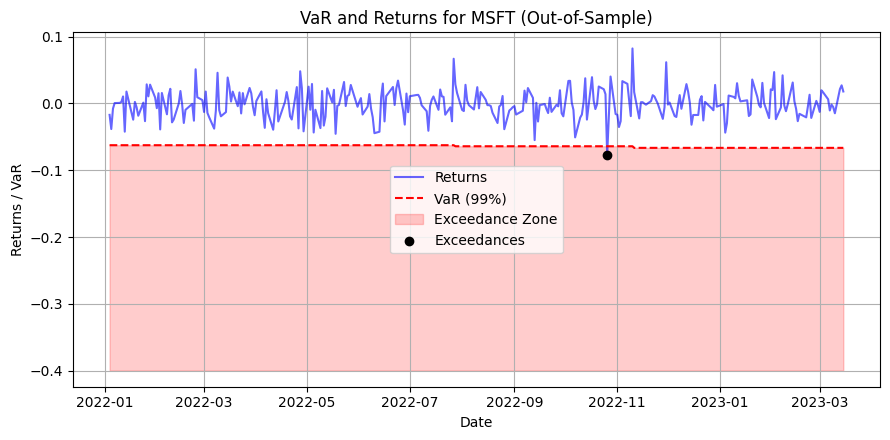


Running Rolling Window Pareto VaR for JPM...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 45.04it/s]


Optimizing...
Elapsed time: 0.03628396987915039 s
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


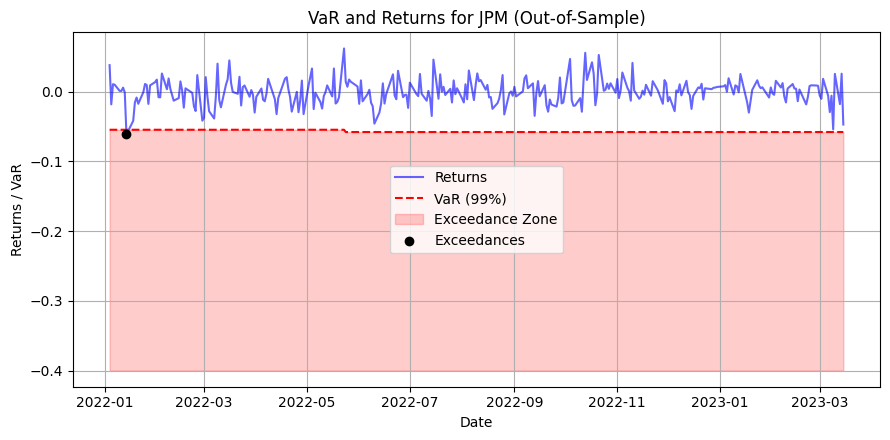


Running Rolling Window Pareto VaR for F...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 25.52it/s]


Optimizing...
Elapsed time: 0.06631946563720703 s
Unconditional Coverage:  lr_uc=2.348171745876755
Transitions: n00=287.00000001, n01=6.00000001, n10=6.00000001, n11=1e-08
Likelihoods: L_m=1.9444714360221249e-13, L_b=1.7195813215159576e-13
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


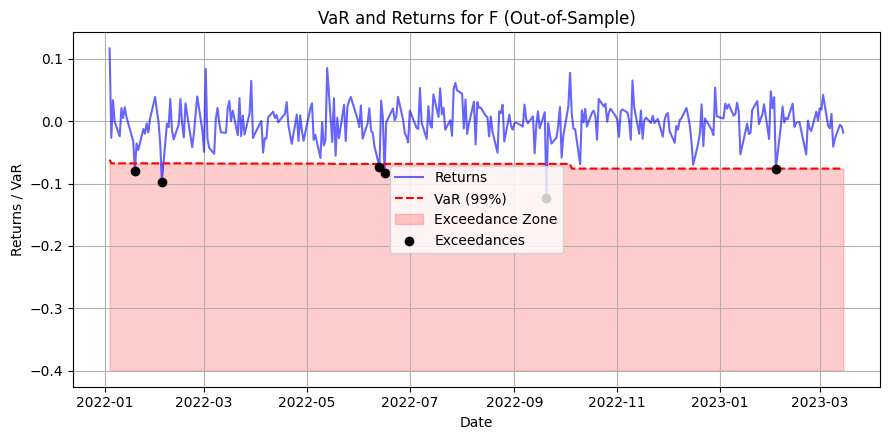


Running Rolling Window Pareto VaR for PG...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 28.56it/s]


Optimizing...
Elapsed time: 0.08482527732849121 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2


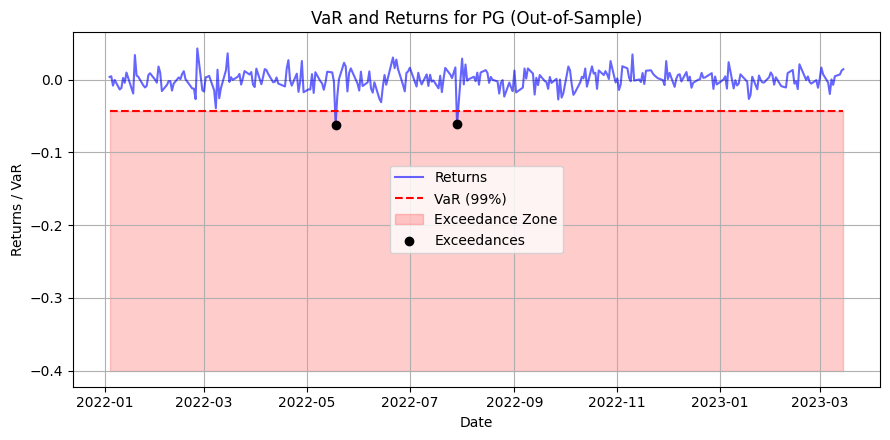


Running Rolling Window Pareto VaR for ^GSPC...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.19it/s]


Optimizing...
Elapsed time: 0.03933262825012207 s
Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=289.00000001, n01=5.00000001, n10=5.00000001, n11=1e-08
Likelihoods: L_m=1.0004926615874929e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


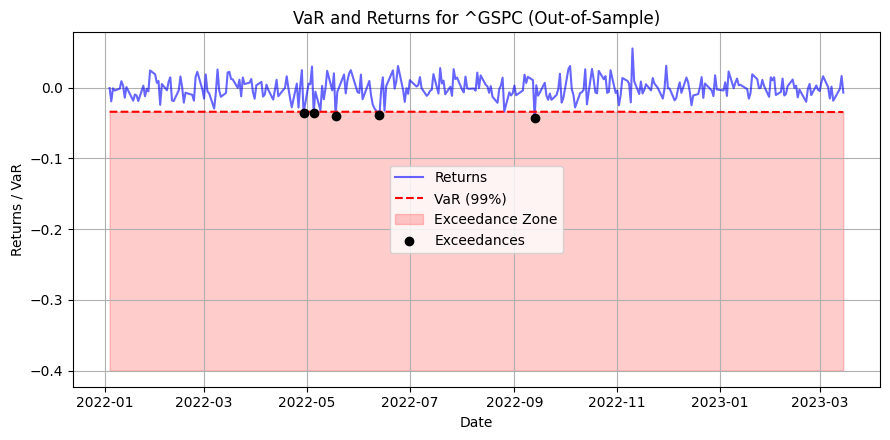


Running Rolling Window Pareto VaR for ^IXIC...
Normalizing returns...


100%|██████████| 48/48 [00:00<00:00, 48.01it/s]


Optimizing...
Elapsed time: 0.03866863250732422 s
Unconditional Coverage:  lr_uc=5.777919512087607
Transitions: n00=283.00000001, n01=8.00000001, n10=8.00000001, n11=1e-08
Likelihoods: L_m=1.2229925551041317e-16, L_b=9.814701051165846e-17
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


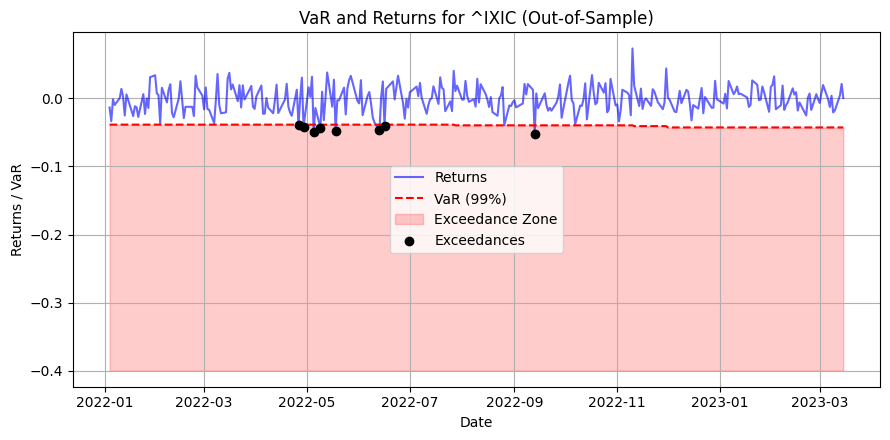


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 5.777919512087607, 'p-value': 0.01622873982041817, 'Decision': 'Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Failure Rate: 2.67%
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 5.777919512087607, 'p-value': 0.01622873982041817, 'Decision': 'Reject H0'}, 'Independence': {'LR Statistic': 0.44000898674899247, 'p-value': 0.5071181178710894, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 6.217928498836599, 'p-value': 0.04464717473746438, 'Decision': 'Reject H0'}}
Engle Manganelli Test: {'test_statistic': 0.29423617231221205, 'p_value': 0.8631920403677323}
TUFF Test: {'time_to_failure': 13, 'likelihood_ratio': 2.4006247333722683, 'p_value': 0.12128680527744895

In [ ]:
from scipy.stats import genpareto

def var_pareto_gpd(returns, threshold, shape, scale, loc, confidence_level):

    T = len(returns)

    excesses = returns[returns > threshold]
    Tu = len(excesses)  # Number of exceedances

    # print(f"Threshold (u): {threshold}")
    # print(f"Shape (ξ): {shape}")
    # print(f"Scale (σ): {scale}")
    # print(f"Loc (μ): {loc}")
    # print(f"Total Observations (T): {T}")
    # print(f"Exceedances (T_u): {Tu}")

    alpha = 1 - confidence_level
    if Tu == 0:
        raise ValueError("No exceedances found. Adjust the threshold.")

    if shape != 0:
        var = threshold + (scale / shape) * (1 - ((T / Tu * alpha) ** (-shape)))

    else:  # limit case for  shape = 0
        var = threshold - scale - np.log(T / Tu * alpha)

    # print(f"Calculated VaR: {var}")
    return var

# Parameters
# rolling_window_size = 252  # Length of the rolling window
confidence_level = 0.99
alpha = 1 - confidence_level

# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df = out_of_sample_returns_df.iloc[:300]

def rolling_pareto_var_forecast(returns_df, out_of_sample_returns_df, rolling_window=252, confidence_level=0.99):
    pareto_var_predictions = {}
    backtest_results = {}

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nRunning Rolling Window Pareto VaR for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Use only historical in-sample data
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna()

        rolling_predictions = []

        # Initialize the rolling window with in-sample data
        historical_data = returns_in_sample.copy()

        for t in range(len(returns_out_of_sample)):
            # Use only the last rolling_window data points
            train_data = historical_data[-rolling_window:].dropna()

            # fit Generalized Pareto to exceedances above the threshold
            threshold = np.percentile(train_data, 99)
            excesses = train_data[train_data > threshold] - threshold
            # excesses = threshold - train_data[train_data < threshold]
            params = genpareto.fit(excesses)
            shape, loc, scale = params

            # Calculate Pareto-based VaR
            # var_pareto = threshold + (scale / shape) * ((rolling_window / len(excesses)) ** shape - 1)
            var_pareto = var_pareto_gpd(train_data, threshold, shape, scale, loc, confidence_level)
            rolling_predictions.append(-var_pareto)

            # Update the rolling window with new data
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]]).iloc[-rolling_window:]

        # align forecasts with out-of-sample dates
        prediction_index = returns_out_of_sample.index[:len(rolling_predictions)]
        VaR_predictions = pd.Series(rolling_predictions, index=prediction_index, name="VaR")

        # pareto_var_predictions[ticker] = {
        #     "VaR": VaR_predictions
        # }

        aligned_returns = returns_out_of_sample.reindex(VaR_predictions.index)
        violations_pareto_var = (aligned_returns < VaR_predictions).astype(int)


        pareto_var_predictions[ticker] = {
            "VaR": VaR_predictions,
            "aligned_returns": aligned_returns,
        }
        pnl_var_df = pd.DataFrame({
            "PnL": aligned_returns,
            "VaR": VaR_predictions,
            "Violations": violations_pareto_var
        })

        # Backtesting results
        kupiec_result_pareto_var = kupiec_test(pnl_var_df["Violations"], confidence_level)
        berkowitz_result_pareto_var = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)
        failure_rate_pareto_var = violations_pareto_var.mean()
        christoffersen_result_pareto_var = christoffersen_test(aligned_returns, violations_pareto_var, confidence_level)
        engle_manganelli_result_pareto_var = engle_manganelli_test(aligned_returns, VaR_predictions, alpha, lags=2)
        tuff_result_pareto_var = tuff_test(violations_pareto_var, alpha)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_pareto_var,
            'berkowitz_result': berkowitz_result_pareto_var,
            'failure_rate': failure_rate_pareto_var,
            'christoffersen_result': christoffersen_result_pareto_var,
            'engle_manganelli_result': engle_manganelli_result_pareto_var,
            'tuff_result': tuff_result_pareto_var
        }

        # Plot returns vs VaR with exceedances
        plt.figure(figsize=(9, 4.5))
        plt.plot(aligned_returns.index, aligned_returns, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return pareto_var_predictions, backtest_results

pareto_var_results, backtest_results = rolling_pareto_var_forecast(returns_df, out_of_sample_returns_df, rolling_window=1000, confidence_level=0.99)

for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Engle Manganelli Test: {results['engle_manganelli_result']}")
    print(f"TUFF Test: {results['tuff_result']}")

## Backtesting GARCH VaR


Running Rolling Window GARCH for AMZN...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 32.24it/s]


Optimizing...
Elapsed time: 0.06462740898132324 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


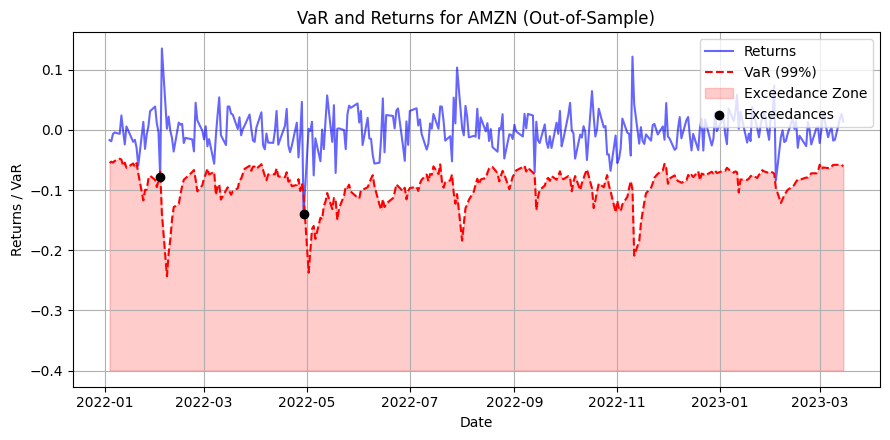

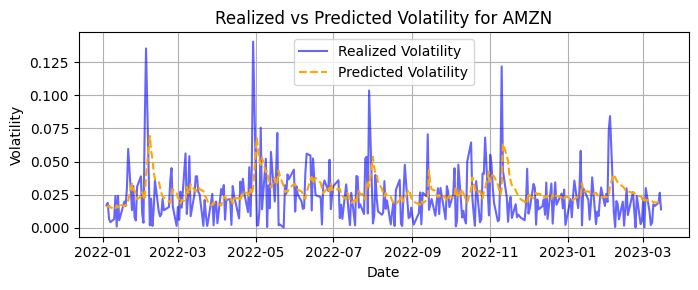


Running Rolling Window GARCH for DIS...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.31it/s]


Optimizing...
Elapsed time: 0.044771432876586914 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2


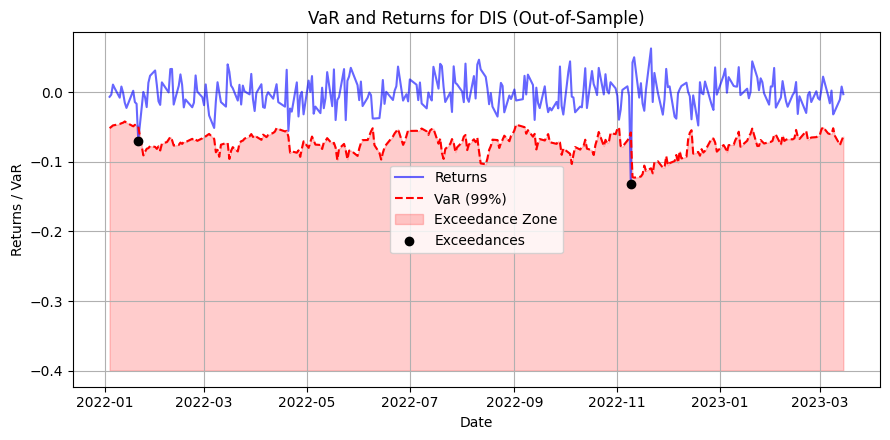

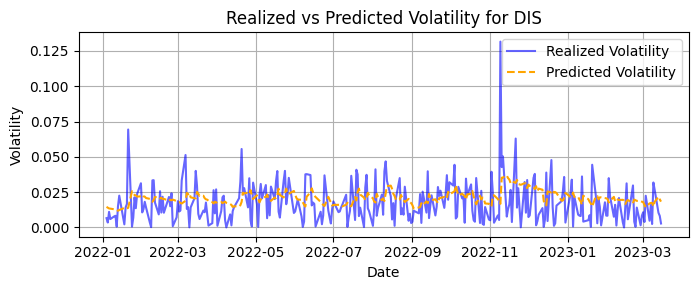


Running Rolling Window GARCH for AAPL...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 37.51it/s]


Optimizing...
Elapsed time: 0.04842400550842285 s
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


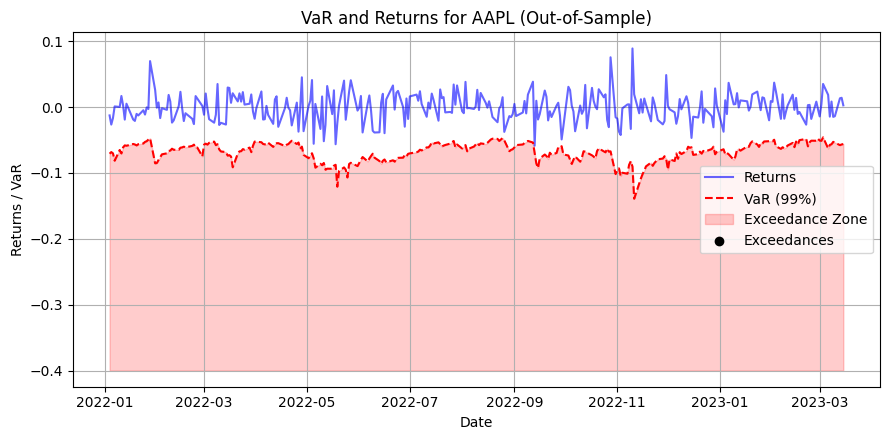

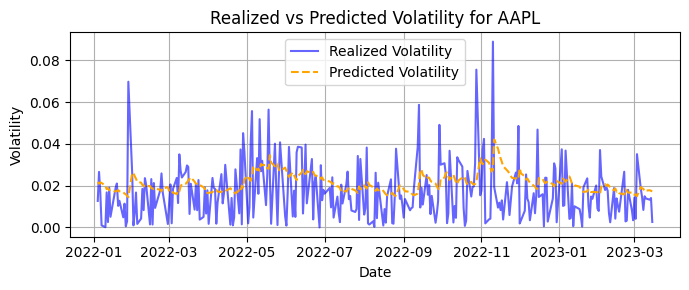


Running Rolling Window GARCH for MSFT...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 39.73it/s]


Optimizing...
Elapsed time: 0.0637354850769043 s
Unconditional Coverage:  lr_uc=0.0
Transitions: n00=293.00000001, n01=3.00000001, n10=3.00000001, n11=1e-08
Likelihoods: L_m=5.2629898452856685e-08, L_b=5.1052870077377365e-08
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


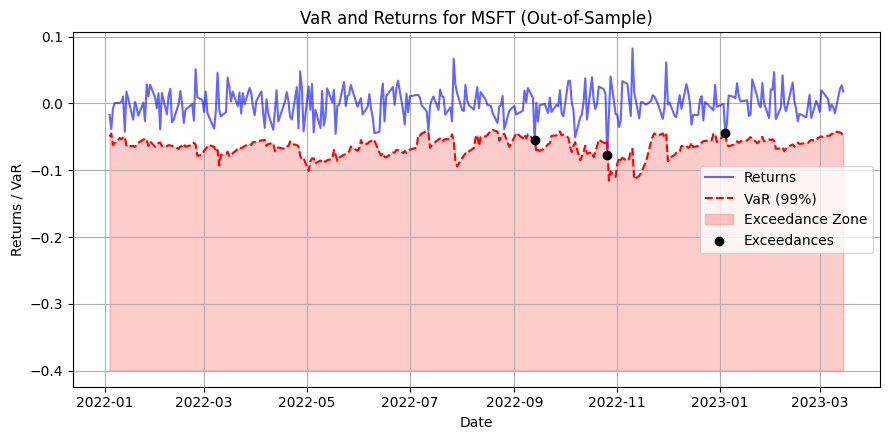

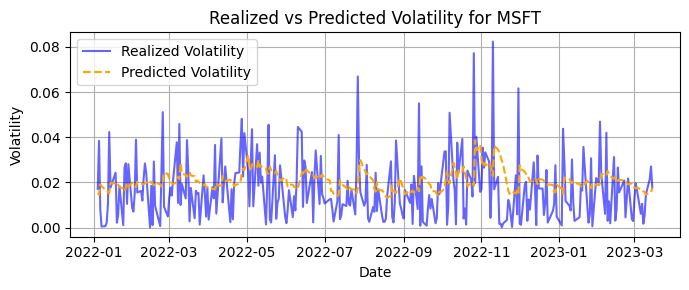


Running Rolling Window GARCH for JPM...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 43.45it/s]


Optimizing...
Elapsed time: 0.03225588798522949 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


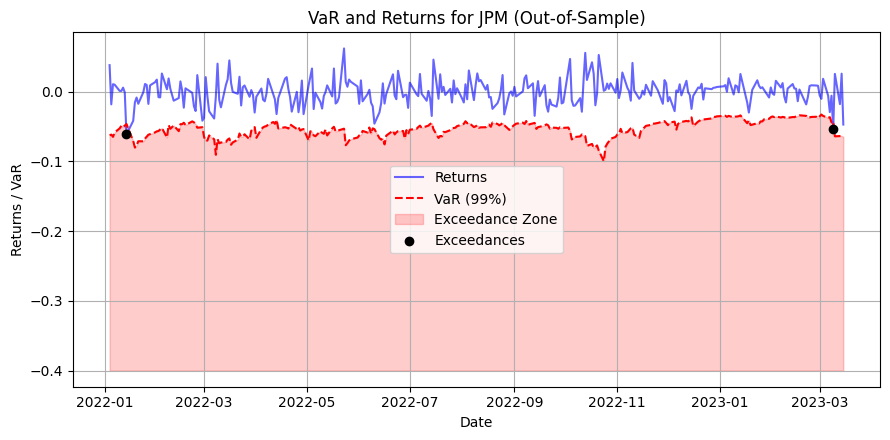

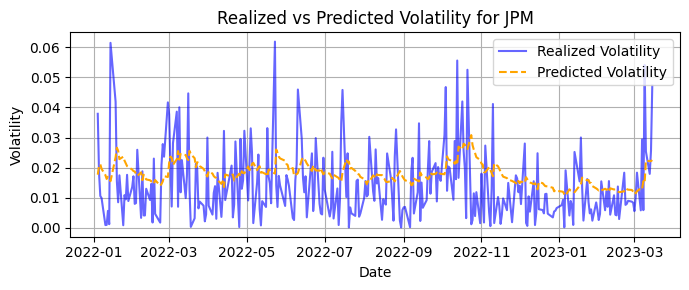


Running Rolling Window GARCH for F...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.04it/s]
<ipython-input-12-e74e31d48bf6>:181: RuntimeWarning: invalid value encountered in divide
  Z = (Z - Z.mean(axis=0)) / Z.std(axis=0)


Optimizing...
Elapsed time: 0.04738330841064453 s
Unconditional Coverage:  lr_uc=0.0
Transitions: n00=293.00000001, n01=3.00000001, n10=3.00000001, n11=1e-08
Likelihoods: L_m=5.2629898452856685e-08, L_b=5.1052870077377365e-08
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


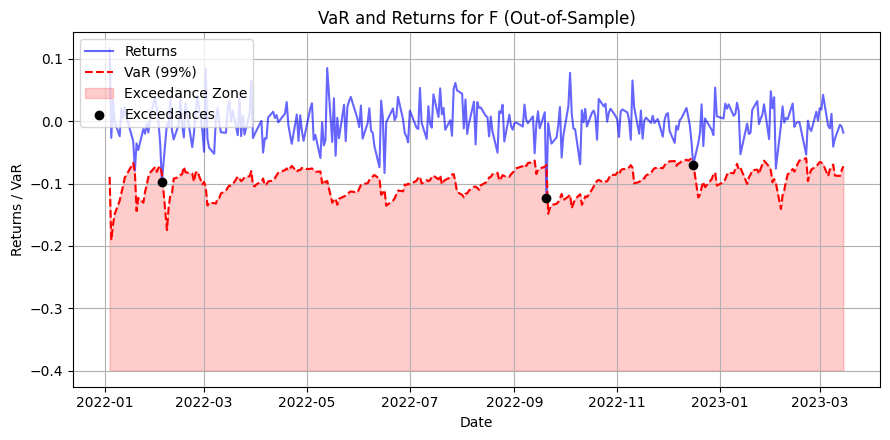

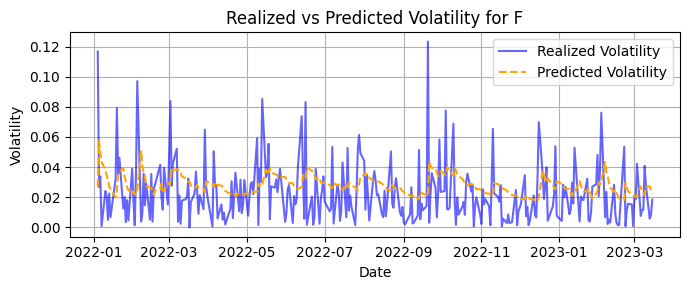


Running Rolling Window GARCH for PG...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 40.18it/s]


Optimizing...
Elapsed time: 0.05666518211364746 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2


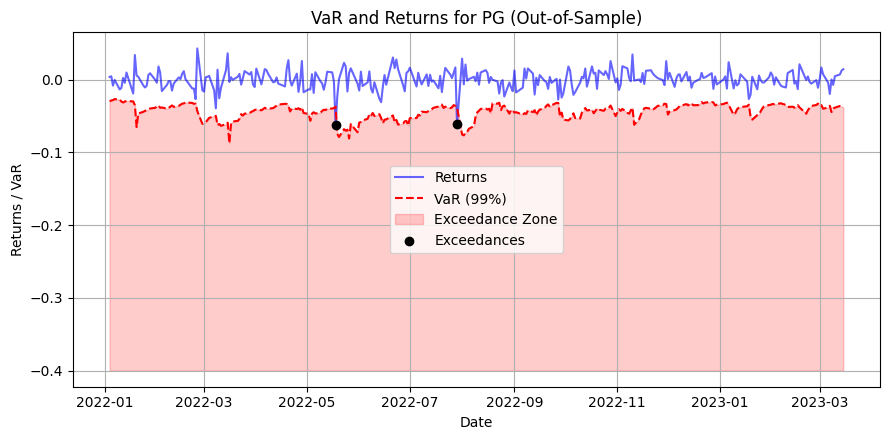

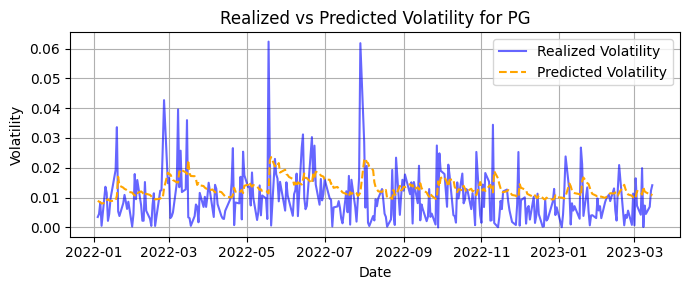


Running Rolling Window GARCH for ^GSPC...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 34.70it/s]


Optimizing...
Elapsed time: 0.05186176300048828 s
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


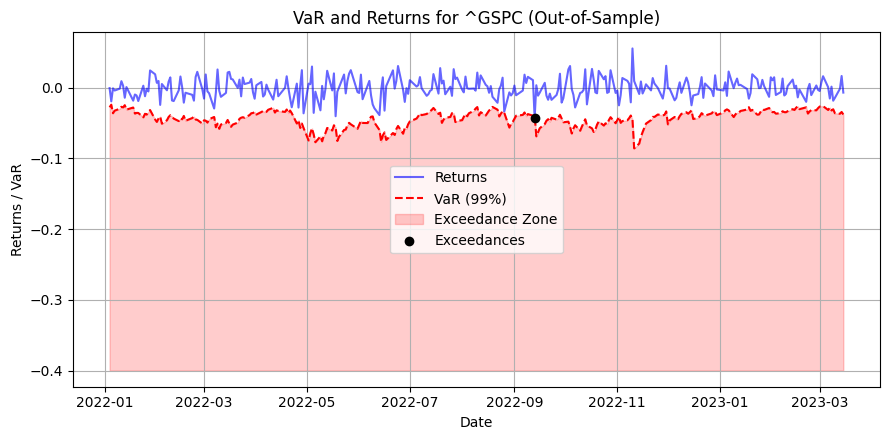

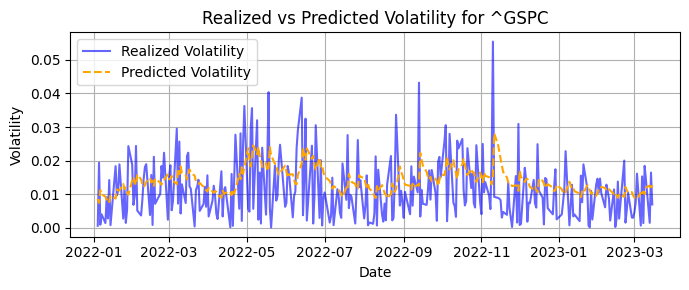


Running Rolling Window GARCH for ^IXIC...
In-sample data points: 2863
Out-of-sample data points: 300
Length of returns: 300
Length of VaR predictions: 300
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 45.82it/s]


Optimizing...
Elapsed time: 0.04021501541137695 s
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


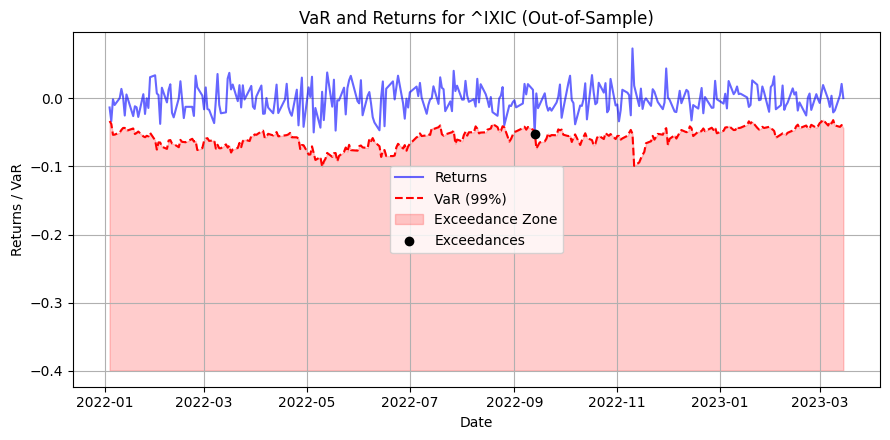

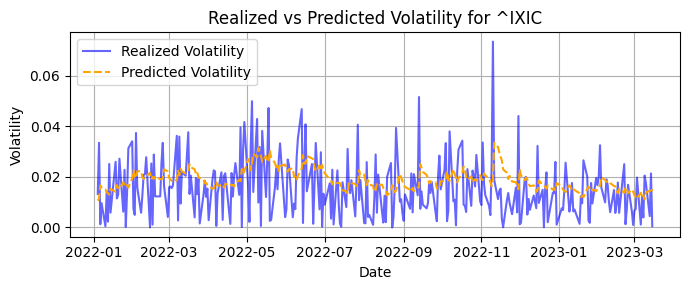


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 0.3815027983793975, 'p-value': 0.5368000594857847, 'Decision': 'Fail to Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Failure Rate: 0.67%
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 0.38150279837940104, 'p-value': 0.5368000594857829, 'Decision': 'Fail to Reject H0'}, 'Independence': {'LR Statistic': 0.02695829801783134, 'p-value': 0.8695817123558565, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 0.4084610963972324, 'p-value': 0.8152743894768312, 'Decision': 'Fail to Reject H0'}}
Engle Manganelli Test: {'test_statistic': 0.018446806557939437, 'p_value': 0.9908190018317624}
TUFF Test: Time Until First Failure = 22, Likelihood Ratio = 1.496529, P-value 

In [ ]:
from scipy.stats import t as student_t
from arch import arch_model

def preprocess_train_data(train_data):
    """Preprocess train data by handling NaN and infinite values."""
    if train_data.isnull().any():
        print("Warning: NaN values found in train_data. Filling with median.")
        train_data = train_data.fillna(train_data.median())

    if np.isinf(train_data).any():
        print("Warning: Inf values found in train_data. Replacing with max finite value.")
        train_data.replace([np.inf, -np.inf], np.nan, inplace=True)
        train_data.fillna(train_data.median(), inplace=True)

    return train_data

garch_predictions = {}
backtest_results = {}
# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]
# Parameters
rolling_window_size = 252 # lenght of window
confidence_level = 0.99
alpha = 1 - confidence_level


def rolling_garch_forecast_fixed(returns_df, out_of_sample_returns_df, rolling_window=250, confidence_level=0.99):
    garch_predictions = {}
    backtest_results = {}

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nRunning Rolling Window GARCH for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Solo dati in-sample storici
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna() #.iloc[:rolling_window]

        rolling_predictions = []
        rolling_volatility = []

        # Inizializzazione dei dati storici con i dati in-sample
        historical_data = returns_in_sample.copy()

        # Rolling window GARCH predictions without using future out-of-sample data
        for t in range(len(returns_out_of_sample)):

            # only use data available up to time t keeping fixed rolling window
            train_data = historical_data[-rolling_window:].dropna()

            # Control for nan or inf values
            train_data = preprocess_train_data(train_data)

            #  GARCH model on data available up to time t-1
            model = arch_model(train_data, mean='Zero', vol='Garch', p=1, q=1, dist='t', rescale=False)
            res = model.fit(disp='off')

            # volatility forecast for the next day
            forecast = res.forecast(horizon=1)
            vol = np.sqrt(forecast.variance.iloc[-1, 0])
            rolling_volatility.append(vol)

            # quantile of the t student distribution
            dof = res.params['nu']  # degrees of freedom for t student
            quantile_t = student_t.ppf(1 - confidence_level, df=dof)
            rolling_predictions.append(-abs(vol * quantile_t))

            # update of  rolling window with new data and keeping size fixed
            pred_series = pd.Series(rolling_predictions)
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]]).iloc[-rolling_window:]


        # align forecasts with  out-of-sample
        prediction_index = returns_out_of_sample.index[:len(rolling_predictions)]
        VaR_predictions = pd.Series(rolling_predictions, index=prediction_index, name="VaR")
        volatility_predictions = pd.Series(rolling_volatility, index=prediction_index, name="Volatility")

        aligned_returns = returns_out_of_sample.reindex(VaR_predictions.index)
        violations_garch = (aligned_returns < VaR_predictions).astype(int)

        garch_predictions[ticker] = {
            "VaR": VaR_predictions,
            "Volatility": volatility_predictions,
            "aligned_returns": aligned_returns
        }

        pnl_var_df = pd.DataFrame({
            "PnL": aligned_returns,
            "VaR": VaR_predictions,
            "Violations": violations_garch
        })

        print(f"In-sample data points: {len(returns_in_sample)}")
        print(f"Out-of-sample data points: {len(returns_out_of_sample)}")
        print(f"Length of returns: {len(aligned_returns)}")
        print(f"Length of VaR predictions: {len(VaR_predictions)}")

        kupiec_result_garch = kupiec_test(pnl_var_df["Violations"], confidence_level)
        berkowitz_result_garch  = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)
        failure_rate_garch  = violations_garch.mean()
        christoffersen_result_garch  = christoffersen_test(aligned_returns, violations_garch, confidence_level)
        engle_manganelli_result_garch  = engle_manganelli_test(aligned_returns, VaR_predictions, alpha, lags=2)
        tuff_result_garch  = tuff_test(violations_garch, alpha)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_garch ,
            'berkowitz_result': berkowitz_result_garch ,
            'failure_rate': failure_rate_garch ,
            'christoffersen_result': christoffersen_result_garch ,
            'engle_manganelli_result': engle_manganelli_result_garch ,
            'tuff_result': tuff_result_garch
        }

        # Plot returns vs VaR with exceedances
        plt.figure(figsize=(9, 4.5))
        plt.plot(aligned_returns.index, aligned_returns, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

        # Plot realized vs predicted volatility
        realized_volatility = aligned_returns.abs()
        plt.figure(figsize=(7, 3))
        plt.plot(realized_volatility.index, realized_volatility, label="Realized Volatility", color="blue", alpha=0.6)
        plt.plot(volatility_predictions.index, volatility_predictions, label="Predicted Volatility", color="orange", linestyle="--")
        plt.title(f"Realized vs Predicted Volatility for {ticker}")
        plt.xlabel("Date")
        plt.ylabel("Volatility")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return garch_predictions, backtest_results

garch_results, backtest_results = rolling_garch_forecast_fixed(returns_df, out_of_sample_returns_df, rolling_window=1000, confidence_level=0.99)


for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Engle Manganelli Test: {results['engle_manganelli_result']}")

    tuff_result_garch  = results['tuff_result']
    print(f"TUFF Test: Time Until First Failure = {tuff_result_garch['time_to_failure']}, "
          f"Likelihood Ratio = {tuff_result_garch['likelihood_ratio']:.6f}, "
          f"P-value = {tuff_result_garch['p_value']:.6f}, Decision = {tuff_result_garch['decision']}")

## Backtesting of Garch with expanding window

In [ ]:
from scipy.stats import t as student_t
from arch import arch_model
def preprocess_train_data(train_data):
    """Preprocess train data by handling NaN and infinite values."""
    if train_data.isnull().any():
        print("Warning: NaN values found in train_data. Filling with median.")
        train_data = train_data.fillna(train_data.median())

    if np.isinf(train_data).any():
        print("Warning: Inf values found in train_data. Replacing with max finite value.")
        train_data.replace([np.inf, -np.inf], np.nan, inplace=True)
        train_data.fillna(train_data.median(), inplace=True)

    return train_data

garch_predictions = {}
backtest_results = {}
# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]
# Parameters
rolling_window_size = 252 # lenght of window
confidence_level = 0.99
alpha = 1 - confidence_level


def expanding_garch_forecast(returns_df, out_of_sample_returns_df, confidence_level=0.99):
    garch_predictions = {}
    backtest_results = {}

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nRunning Expanding Window GARCH for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Solo dati in-sample storici
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna()

        expanding_predictions = []
        expanding_volatility = []

        # Inizializzazione dei dati storici con i dati in-sample
        historical_data = returns_in_sample.copy()

        # Expanding window GARCH predictions
        for t in range(len(returns_out_of_sample)):

            # Usa tutti i dati disponibili fino a t (expanding window)
            train_data = historical_data.dropna()

            # Controllo per NaN o inf
            train_data = preprocess_train_data(train_data)

            # Modello GARCH(1,1)
            model = arch_model(train_data, mean='Zero', vol='Garch', p=1, q=1, dist='t', rescale=False)
            res = model.fit(disp='off')

            # Previsione della volatilità per il giorno successivo
            forecast = res.forecast(horizon=1)
            vol = np.sqrt(forecast.variance.iloc[-1, 0])
            expanding_volatility.append(vol)

            # Calcolo del quantile della distribuzione t-student
            dof = res.params['nu']
            quantile_t = student_t.ppf(1 - confidence_level, df=dof)
            expanding_predictions.append(-abs(vol * quantile_t))

            # Aggiungi il nuovo dato alla finestra espandibile
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]])

        # Allinea le previsioni con i dati out-of-sample
        prediction_index = returns_out_of_sample.index[:len(expanding_predictions)]
        VaR_predictions = pd.Series(expanding_predictions, index=prediction_index, name="VaR")
        volatility_predictions = pd.Series(expanding_volatility, index=prediction_index, name="Volatility")

        aligned_returns = returns_out_of_sample.reindex(VaR_predictions.index)
        violations_garch = (aligned_returns < VaR_predictions).astype(int)

        garch_predictions[ticker] = {
            "VaR": VaR_predictions,
            "Volatility": volatility_predictions,
            "aligned_returns": aligned_returns
        }

        pnl_var_df = pd.DataFrame({
            "PnL": aligned_returns,
            "VaR": VaR_predictions,
            "Violations": violations_garch
        })

        kupiec_result_garch = kupiec_test(pnl_var_df["Violations"], confidence_level)
        berkowitz_result_garch = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)
        failure_rate_garch = violations_garch.mean()
        christoffersen_result_garch = christoffersen_test(aligned_returns, violations_garch, confidence_level)
        engle_manganelli_result_garch = engle_manganelli_test(aligned_returns, VaR_predictions, 1-confidence_level, lags=2)
        tuff_result_garch = tuff_test(violations_garch, 1-confidence_level)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_garch,
            'berkowitz_result': berkowitz_result_garch,
            'failure_rate': failure_rate_garch,
            'christoffersen_result': christoffersen_result_garch,
            'engle_manganelli_result': engle_manganelli_result_garch,
            'tuff_result': tuff_result_garch
        }

        # Grafici delle previsioni
        plt.figure(figsize=(9, 4.5))
        plt.plot(aligned_returns.index, aligned_returns, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Expanding Window Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

        # Grafico della volatilità realizzata vs prevista
        realized_volatility = aligned_returns.abs()
        plt.figure(figsize=(7, 3))
        plt.plot(realized_volatility.index, realized_volatility, label="Realized Volatility", color="blue", alpha=0.6)
        plt.plot(volatility_predictions.index, volatility_predictions, label="Predicted Volatility", color="orange", linestyle="--")
        plt.title(f"Realized vs Predicted Volatility for {ticker}")
        plt.xlabel("Date")
        plt.ylabel("Volatility")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return garch_predictions, backtest_results



garch_results, backtest_results = expanding_garch_forecast(returns_df, out_of_sample_returns_df, confidence_level=0.99)


for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Engle Manganelli Test: {results['engle_manganelli_result']}")

    tuff_result_garch  = results['tuff_result']
    print(f"TUFF Test: Time Until First Failure = {tuff_result_garch['time_to_failure']}, "
          f"Likelihood Ratio = {tuff_result_garch['likelihood_ratio']:.6f}, "
          f"P-value = {tuff_result_garch['p_value']:.6f}, Decision = {tuff_result_garch['decision']}")



Running Expanding Window GARCH for AMZN...


KeyboardInterrupt: 

## Backtesting EVT and GARCH (EVT parameters fixed)


Processing GARCH+EVT for AMZN...
Using fixed EVT parameters for AMZN: Shape=-0.4214, Loc=2.1795, Scale=0.8888
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 40.16it/s]


Optimizing...
Elapsed time: 0.03716111183166504 s


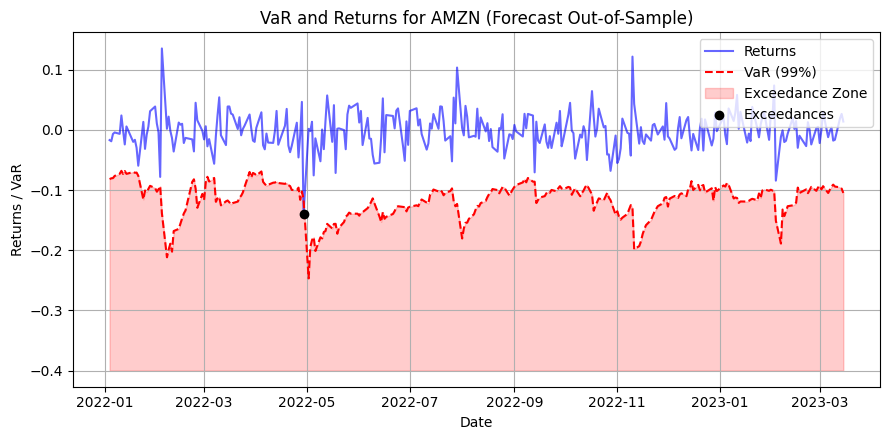


Processing GARCH+EVT for DIS...
Using fixed EVT parameters for DIS: Shape=-0.3328, Loc=2.1077, Scale=0.6123


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.98it/s]


Optimizing...
Elapsed time: 0.03931832313537598 s


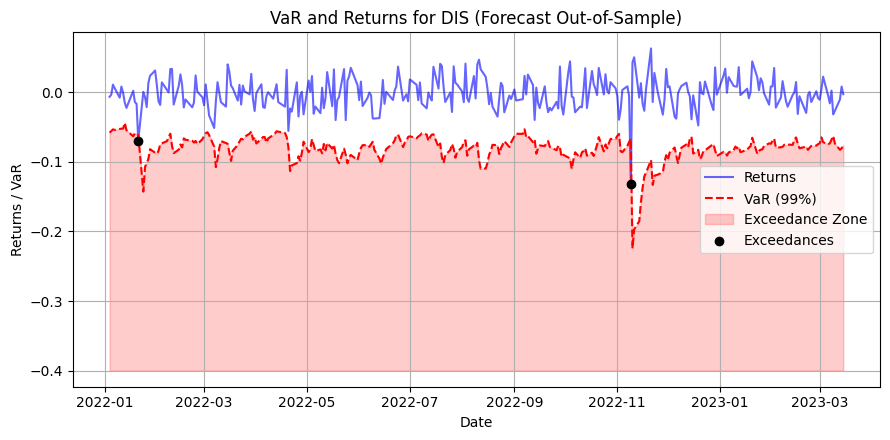


Processing GARCH+EVT for AAPL...
Using fixed EVT parameters for AAPL: Shape=-0.2983, Loc=2.2263, Scale=0.6617
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 39.51it/s]


Optimizing...
Elapsed time: 0.044470787048339844 s


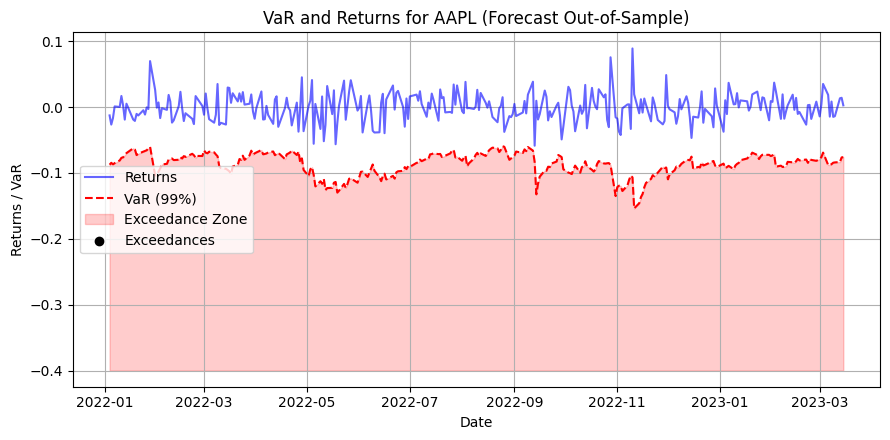


Processing GARCH+EVT for MSFT...
Using fixed EVT parameters for MSFT: Shape=-0.3259, Loc=2.2201, Scale=0.7316
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 41.66it/s]


Optimizing...
Elapsed time: 0.050136566162109375 s


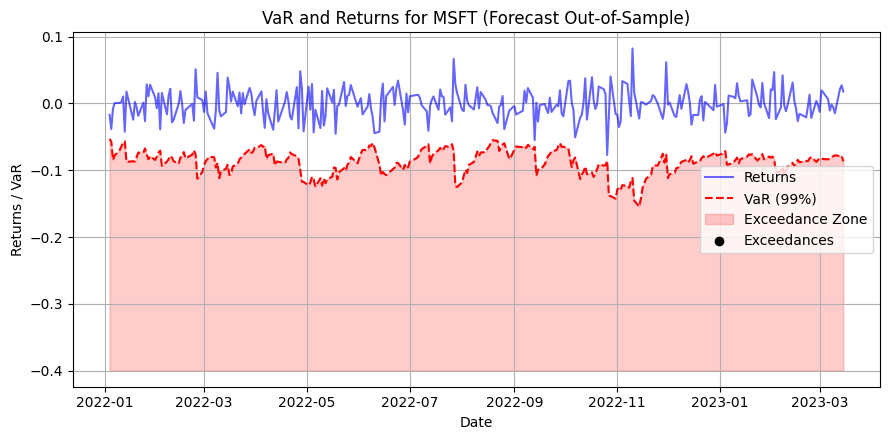


Processing GARCH+EVT for JPM...
Using fixed EVT parameters for JPM: Shape=-0.0486, Loc=2.2118, Scale=0.5952
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.17it/s]


Optimizing...
Elapsed time: 0.030039310455322266 s


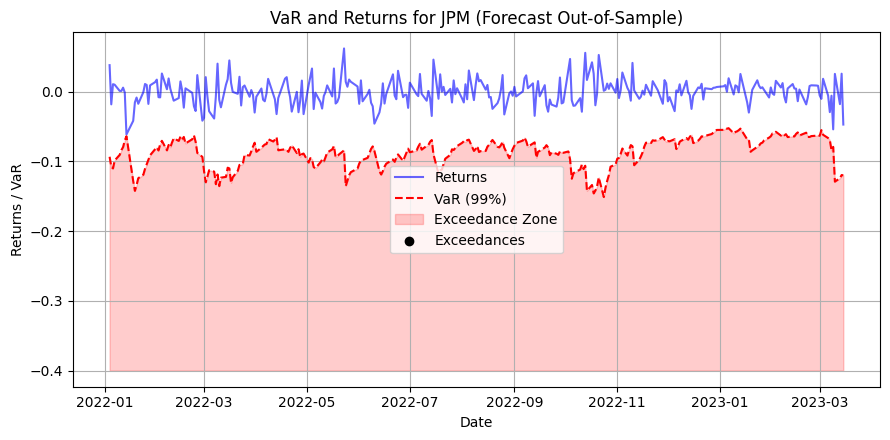


Processing GARCH+EVT for F...
Using fixed EVT parameters for F: Shape=-0.1567, Loc=2.0240, Scale=0.6352
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 36.67it/s]


Optimizing...
Elapsed time: 0.04188990592956543 s


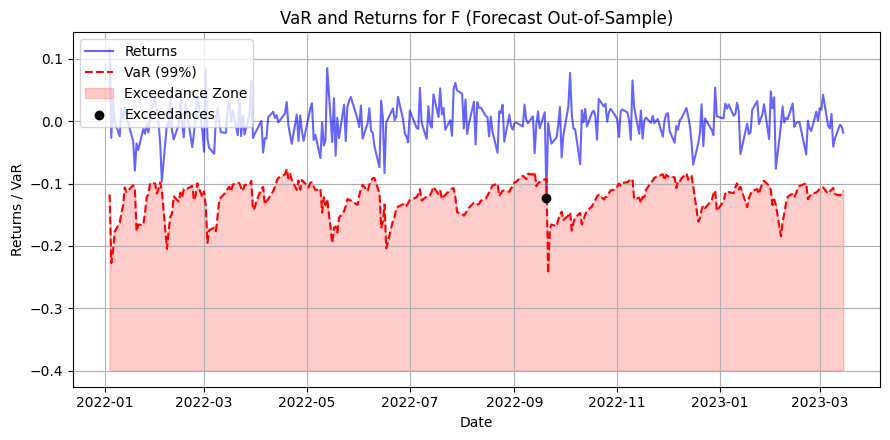


Processing GARCH+EVT for PG...
Using fixed EVT parameters for PG: Shape=-0.2935, Loc=2.0955, Scale=0.5909
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 41.18it/s]


Optimizing...
Elapsed time: 0.05273747444152832 s


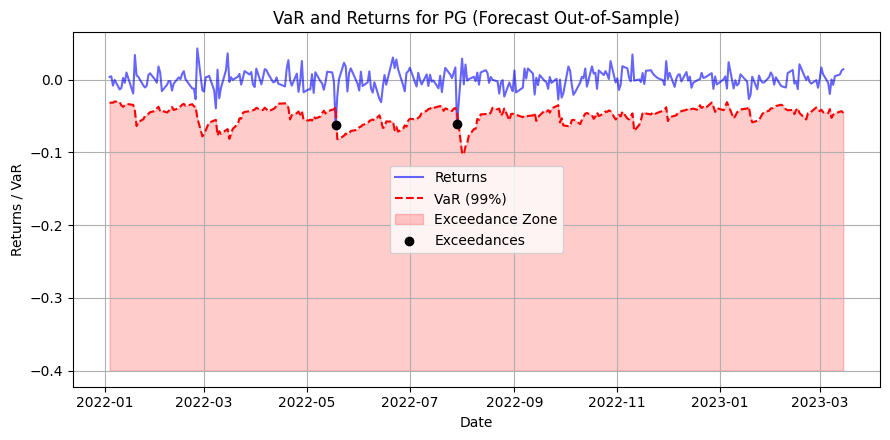


Processing GARCH+EVT for ^GSPC...
Using fixed EVT parameters for ^GSPC: Shape=-0.1493, Loc=1.9445, Scale=0.3304
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.46it/s]


Optimizing...
Elapsed time: 0.04796481132507324 s


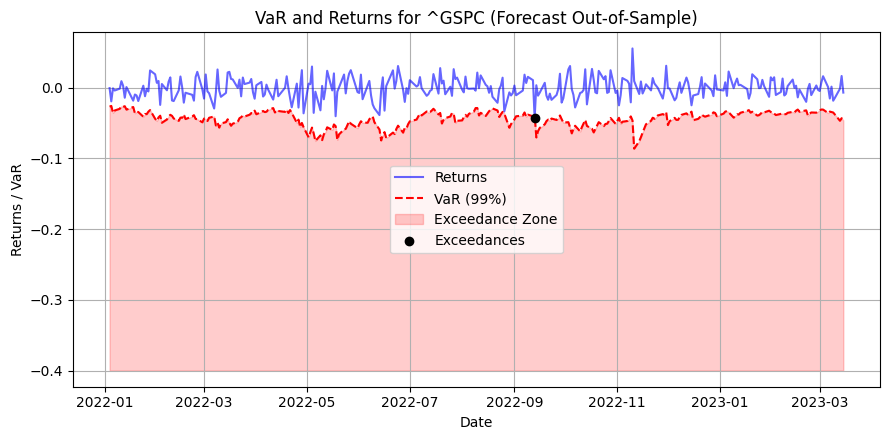


Processing GARCH+EVT for ^IXIC...
Using fixed EVT parameters for ^IXIC: Shape=-0.0126, Loc=1.9943, Scale=0.3500
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 45.60it/s]


Optimizing...
Elapsed time: 0.05402255058288574 s


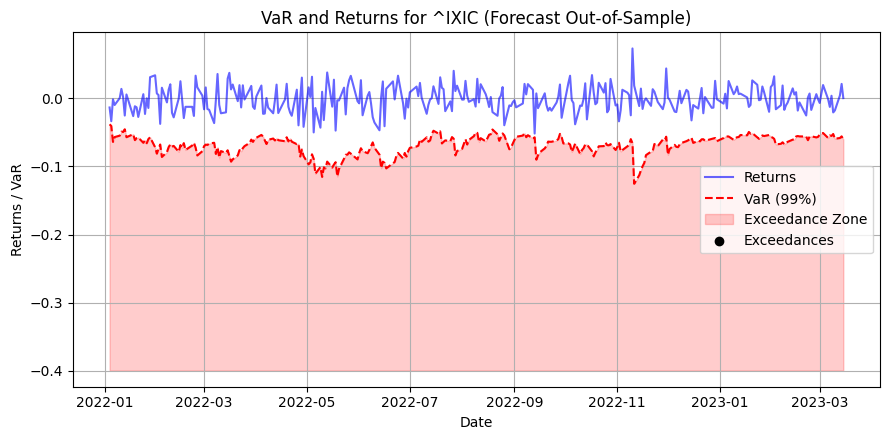


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 1.8162133062799164, 'p-value': 0.17776467920883032, 'Decision': 'Fail to Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Tuff Test: {'time_to_failure': 81, 'likelihood_ratio': 0.04189259942222634, 'p_value': 0.8378246342910947, 'decision': 'Accept'}
Engle and Manganelli Test: {'test_statistic': nan, 'p_value': nan}
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 1.8162133062799182, 'p-value': 0.1777646792088302, 'Decision': 'Fail to Reject H0'}, 'Independence': {'LR Statistic': 0.006722283042824628, 'p-value': 0.9346550392095829, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 1.8229355893227428, 'p-value': 0.40193383451781184, 'Decision': 'Fail to Reject H0

In [ ]:
from arch import arch_model
from scipy.stats import genextreme


# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]
gev_params_fixed = {
    'AMZN': (-0.4214, 2.1795, 0.8888),
    'DIS': (-0.3328, 2.1077, 0.6123),
    'AAPL': (-0.2983, 2.2263, 0.6617),
    'MSFT': (-0.3259, 2.2201, 0.7316),
    'JPM': (-0.0486, 2.2118, 0.5952),
    'F': (-0.1567, 2.0240, 0.6352),
    'PG': (-0.2935, 2.0955, 0.5909),
    '^GSPC': (-0.1493, 1.9445, 0.3304),
    '^IXIC': (-0.0126, 1.9943, 0.3500),
}

rolling_window_size = 1000
confidence_level = 0.99
alpha = 1 - confidence_level

def rolling_garch_evt_forecast_fixed(returns_df, out_of_sample_returns_df, rolling_window=250, confidence_level=0.99):
    garch_evt_predictions = {}
    backtest_results = {}

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nProcessing GARCH+EVT for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Usa solo dati storici in-sample
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna()
        rolling_predictions = []
        rolling_volatility = []

        # Recupera old EVT parameters
        if ticker in gev_params_fixed:
            shape, loc, scale = gev_params_fixed[ticker]
        else:
            print(f"Warning: No GEV parameters for {ticker}. Skipping.")
            continue

        print(f"Using fixed EVT parameters for {ticker}: Shape={shape:.4f}, Loc={loc:.4f}, Scale={scale:.4f}")

        # Inizializza la rolling window con dati in-sample
        historical_data = returns_in_sample.copy()

        for t in range(len(returns_out_of_sample)):

            # only use the last data
            train_data = historical_data[-rolling_window:].dropna()

            # Control - check for  NaN o inf values
            if train_data.isnull().any():
                print(f"Warning: NaN values found in train_data for {ticker}. Filling with zeros.")
                train_data = train_data.fillna(0)

            if np.isinf(train_data).any():
                print(f"Warning: Inf values found in train_data for {ticker}. Replacing with max finite value.")
                train_data.replace([np.inf, -np.inf], np.nan, inplace=True)
                train_data.fillna(train_data.max(), inplace=True)

            # garch fitted up to  t-1
            model = arch_model(train_data, mean='Zero', vol='Garch', p=1, q=1, dist='t', rescale=False)
            res = model.fit(disp='off')

            # forecast for next day volatility
            forecast = res.forecast(horizon=1)
            vol = np.sqrt(forecast.variance.iloc[-1, 0])
            rolling_volatility.append(vol)

            # compute evt quantile
            if abs(shape) < 1e-6:
                quantile = loc - scale * np.log(-np.log(1 - alpha))
            else:
                quantile = loc - (scale / shape) * (1 - (-np.log(1 - alpha)) ** (-shape))
            # print(f"quantile: {quantile}")
            daily_gev_var = vol * quantile
            rolling_predictions.append(-daily_gev_var)

            pred_series = pd.Series(rolling_predictions)
            # update rolling window
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]]).iloc[-rolling_window:]


        # align forecasts with  with date out-of-sample
        prediction_index = returns_out_of_sample.index
        VaR_predictions = pd.Series(rolling_predictions, index=prediction_index[:len(rolling_predictions)], name="VaR")
        volatility_predictions = pd.Series(rolling_volatility, index=prediction_index[:len(rolling_volatility)], name="Volatility")
        aligned_returns = returns_out_of_sample.reindex(VaR_predictions.index)

        garch_evt_predictions[ticker] = {
            "VaR": VaR_predictions,
            "Volatility": volatility_predictions,
            "aligned_returns": aligned_returns
        }

        violations_gevgarch = (returns_out_of_sample < VaR_predictions).astype(int)
        pnl_var_df = pd.DataFrame({
            "PnL": returns_out_of_sample,
            "VaR": VaR_predictions,
            "Violations": violations_gevgarch
        })

        kupiec_result_gevgarch = kupiec_test(pnl_var_df["Violations"], confidence_level)
        christoffersen_result_gevgarch = christoffersen_test(returns_out_of_sample, violations_gevgarch, confidence_level)
        engle_manganelli_result_gevgarch = engle_manganelli_test(returns_out_of_sample, VaR_predictions, alpha, lags=2)
        tuff_result_gevgarch = tuff_test(violations_gevgarch, alpha)
        berkowitz_result_gevgarch = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_gevgarch,
            'berkowitz_result': berkowitz_result_gevgarch,
            'christoffersen_result': christoffersen_result_gevgarch,
            'engle_manganelli_result': engle_manganelli_result_gevgarch,
            'tuff_result': tuff_result_gevgarch,
            'failure_rate': violations_gevgarch.mean()
        }

        # Plot returns vs VaR with exceedances
        plt.figure(figsize=(9, 4.5))
        plt.plot(returns_out_of_sample.index, returns_out_of_sample, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Forecast Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return garch_evt_predictions, backtest_results

garch_evt_results, backtest_results = rolling_garch_evt_forecast_fixed(returns_df, out_of_sample_returns_df, rolling_window=500, confidence_level=0.99)

for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Tuff Test: {results['tuff_result']}")
    print(f"Engle and Manganelli Test: {results['engle_manganelli_result']}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")


## Backtest for EVT+GARCH with a Different approach - rolling window that also refits the evt model, no fixed parameters


Processing GARCH+EVT with Dynamic Parameters for AMZN...
Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=289.00000001, n01=5.00000001, n10=5.00000001, n11=1e-08
Likelihoods: L_m=1.0004926615874929e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 38.27it/s]


Optimizing...
Elapsed time: 0.03299260139465332 s


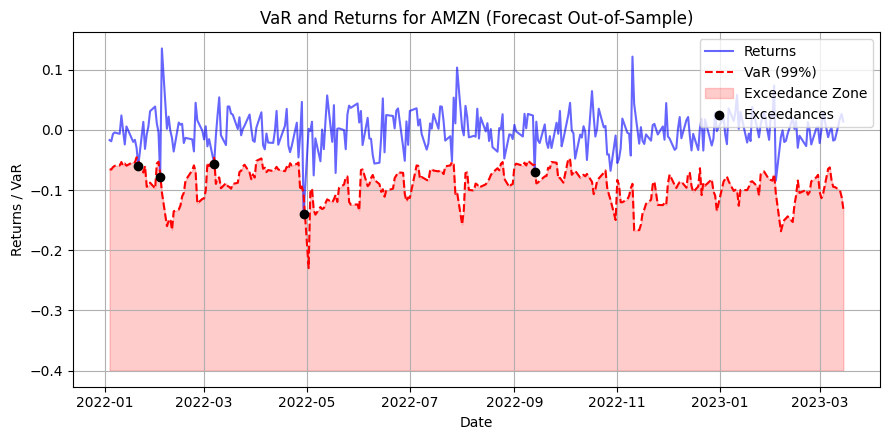


Processing GARCH+EVT with Dynamic Parameters for DIS...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.18it/s]


Optimizing...
Elapsed time: 0.05898618698120117 s


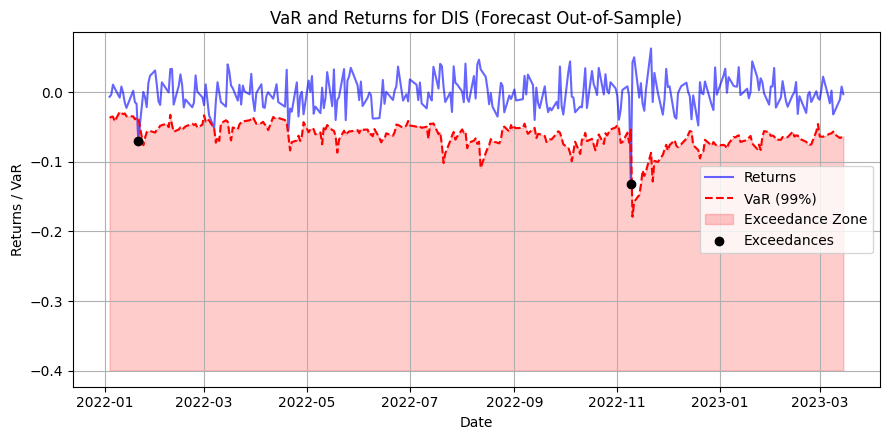


Processing GARCH+EVT with Dynamic Parameters for AAPL...
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 37.63it/s]


Optimizing...
Elapsed time: 0.04003143310546875 s


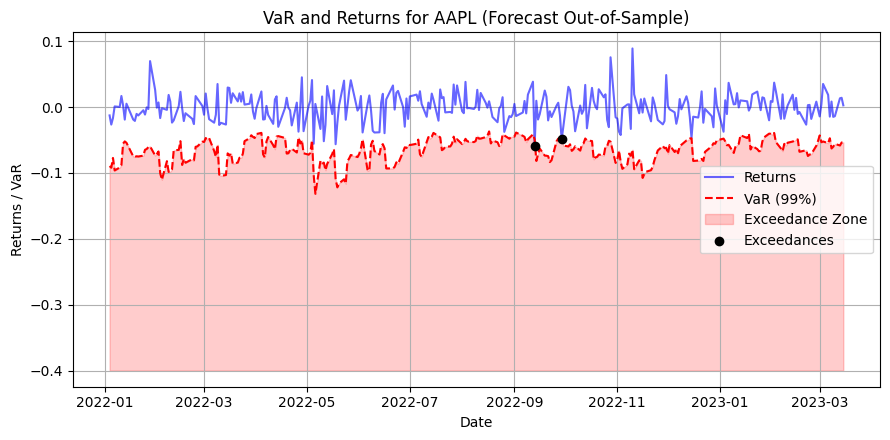


Processing GARCH+EVT with Dynamic Parameters for MSFT...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Unconditional Coverage:  lr_uc=2.348171745876755
Transitions: n00=287.00000001, n01=6.00000001, n10=6.00000001, n11=1e-08
Likelihoods: L_m=1.9444714360221249e-13, L_b=1.7195813215159576e-13
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 36.35it/s]


Optimizing...
Elapsed time: 0.038477182388305664 s


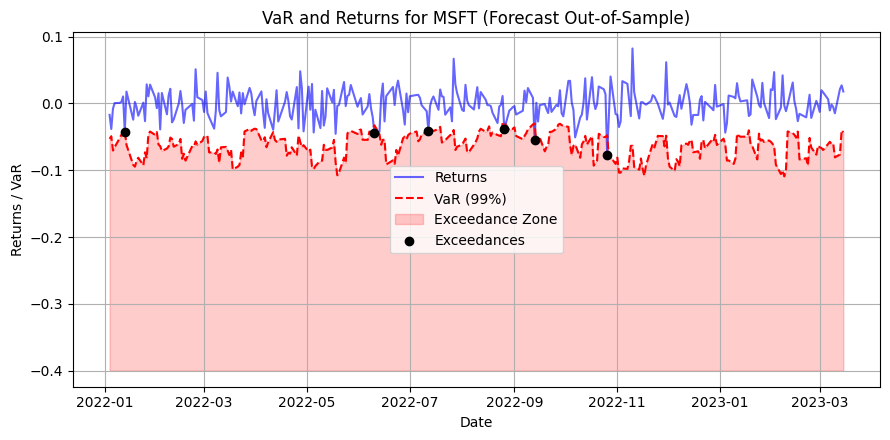


Processing GARCH+EVT with Dynamic Parameters for JPM...
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 45.31it/s]


Optimizing...
Elapsed time: 0.031622886657714844 s


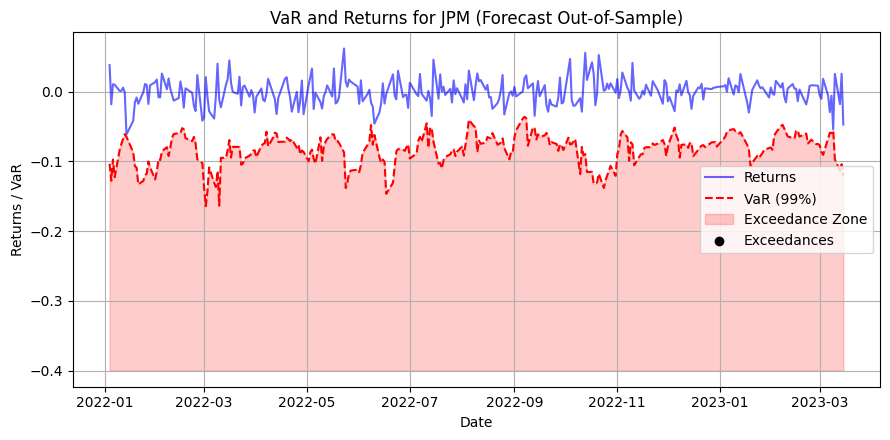


Processing GARCH+EVT with Dynamic Parameters for F...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=289.00000001, n01=5.00000001, n10=5.00000001, n11=1e-08
Likelihoods: L_m=1.0004926615874929e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 34.39it/s]


Optimizing...
Elapsed time: 0.08006787300109863 s


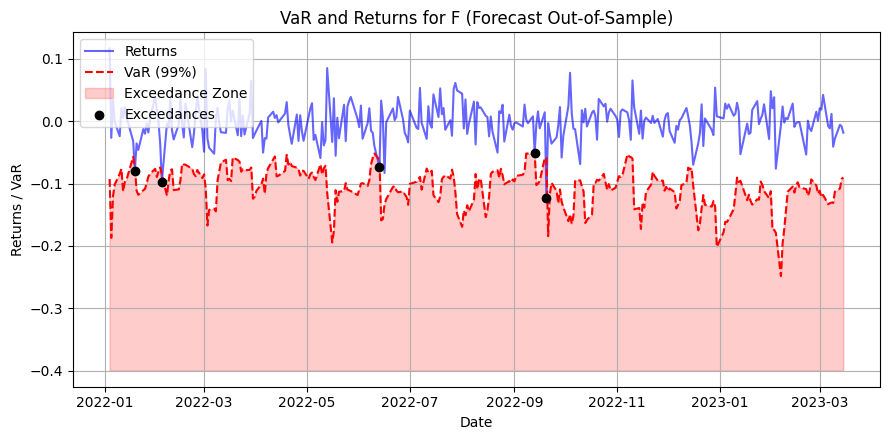


Processing GARCH+EVT with Dynamic Parameters for PG...
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=291.00000001, n01=4.00000001, n10=4.00000001, n11=1e-08
Likelihoods: L_m=6.362202979374106e-10, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 40.36it/s]


Optimizing...
Elapsed time: 0.05291104316711426 s


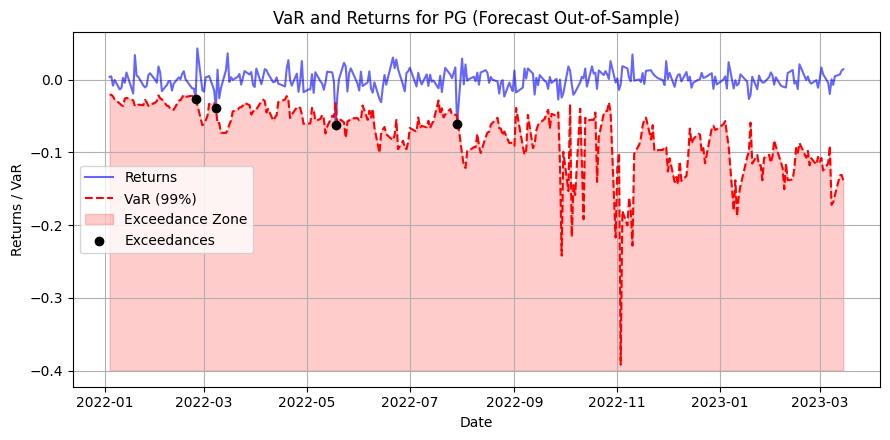


Processing GARCH+EVT with Dynamic Parameters for ^GSPC...
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 34.68it/s]


Optimizing...
Elapsed time: 0.03920602798461914 s


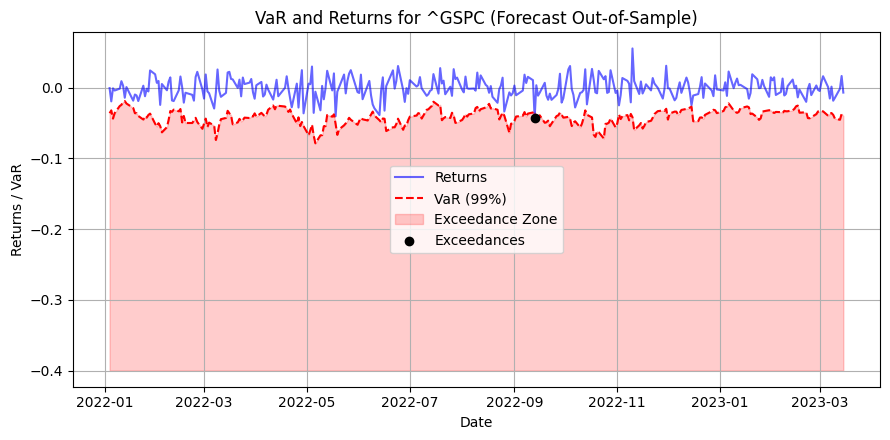


Processing GARCH+EVT with Dynamic Parameters for ^IXIC...
Unconditional Coverage:  lr_uc=1.8162133062799182
Transitions: n00=297.00000001, n01=1.00000001, n10=1.00000001, n11=1e-08
Likelihoods: L_m=0.0012365772052220115, L_b=0.0012324278713885702
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 31.99it/s]


Optimizing...
Elapsed time: 0.06870436668395996 s


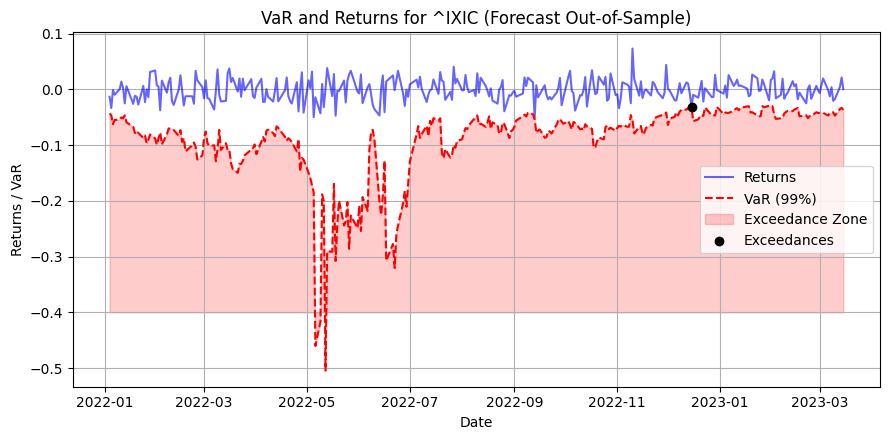


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 1.1217545845607901, 'p-value': 0.2895409599936484, 'Decision': 'Fail to Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Tuff Test: {'time_to_failure': 13, 'likelihood_ratio': 2.4006247333722683, 'p_value': 0.12128680527744895, 'decision': 'Accept'}
Engle and Manganelli Test: {'test_statistic': 0.14960996215325542, 'p_value': 0.9279244315077159}
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 1.1217545845607972, 'p-value': 0.28954095999364693, 'Decision': 'Fail to Reject H0'}, 'Independence': {'LR Statistic': 0.17013241171025584, 'p-value': 0.6799941560214265, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 1.291886996271053, 'p-value': 0.5241677574272503, 'D

In [ ]:
from arch import arch_model
from scipy.stats import genextreme


out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]

rolling_window_size = 1000
confidence_level = 0.99
alpha = 1 - confidence_level

def rolling_garch_evt_forecast_dynamic(returns_df, out_of_sample_returns_df, rolling_window=250, block_size=21, confidence_level=0.99):
    garch_evt_predictions = {}
    backtest_results = {}

    alpha = 1 - confidence_level  # Livello di significatività per il VaR

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nProcessing GARCH+EVT with Dynamic Parameters for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Dati storici in-sample
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna()

        rolling_predictions = []
        rolling_volatility = []

        historical_data = returns_in_sample.copy()

        for t in range(len(returns_out_of_sample)):
            train_data = historical_data[-rolling_window:].dropna()

            # Controllo dei dati mancanti o infiniti
            if train_data.isnull().any():
                train_data = train_data.fillna(0)
            if np.isinf(train_data).any():
                train_data.replace([np.inf, -np.inf], np.nan, inplace=True)
                train_data.fillna(train_data.max(), inplace=True)

            # Ristima del modello GARCH ogni giorno
            garch_model = arch_model(train_data, mean='Zero', vol='Garch', p=1, q=1, dist='t', rescale=False)
            garch_result = garch_model.fit(disp='off')

            # Previsione della volatilità per il giorno successivo
            forecast = garch_result.forecast(horizon=1)
            vol_forecast = np.sqrt(forecast.variance.iloc[-1, 0])
            rolling_volatility.append(vol_forecast)

            # Calcolo dei residui del GARCH (innovazioni standardizzate)
            residuals = garch_result.resid / garch_result.conditional_volatility
            residuals = residuals.dropna()

            # Estrazione dei massimi dei blocchi dai residui per la EVT
            block_maxima = []
            for start_idx in range(0, len(residuals), block_size):
                block = residuals[start_idx : start_idx + block_size]
                if not block.empty:
                    block_maxima.append(block.max())

            # Verifica se ci sono abbastanza dati per stimare la EVT
            if len(block_maxima) < 5:
                print(f"Not enough extreme values for EVT estimation for {ticker} at iteration {t}. Skipping this step.")
                continue

            # Stima dinamica dei parametri EVT (GEV) sui massimi dei blocchi
            shape, loc, scale = genextreme.fit(block_maxima)

            # Calcolo del quantile EVT per il livello di confidenza desiderato
            if abs(shape) < 1e-6:  # Caso limite per distribuzione di Gumbel
                quantile_evt = loc - scale * np.log(-np.log(1 - alpha))
            else:
                quantile_evt = loc - (scale / shape) * (1 - (-np.log(1 - alpha)) ** (-shape))

            # Calcolo del VaR combinando la volatilità GARCH con il quantile EVT
            daily_var = vol_forecast * quantile_evt
            rolling_predictions.append(-daily_var)

            # Aggiornamento della rolling window con i dati out-of-sample
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]]).iloc[-rolling_window:]

        # Allineamento dei risultati con le date out-of-sample
        prediction_index = returns_out_of_sample.index
        VaR_predictions = pd.Series(rolling_predictions, index=prediction_index[:len(rolling_predictions)], name="VaR")
        volatility_predictions = pd.Series(rolling_volatility, index=prediction_index[:len(rolling_volatility)], name="Volatility")

        # Salvataggio dei risultati per ciascun titolo
        garch_evt_predictions[ticker] = {
            "VaR": VaR_predictions,
            "Volatility": volatility_predictions,
            "Returns": returns_out_of_sample.reindex(VaR_predictions.index)
        }

        violations_gevgarch = (returns_out_of_sample < VaR_predictions).astype(int)
        pnl_var_df = pd.DataFrame({
            "PnL": returns_out_of_sample,
            "VaR": VaR_predictions,
            "Violations": violations_gevgarch
        })

        kupiec_result_gevgarch = kupiec_test(pnl_var_df["Violations"], confidence_level)
        christoffersen_result_gevgarch = christoffersen_test(returns_out_of_sample, violations_gevgarch, confidence_level)
        engle_manganelli_result_gevgarch = engle_manganelli_test(returns_out_of_sample, VaR_predictions, alpha, lags=2)
        tuff_result_gevgarch = tuff_test(violations_gevgarch, alpha)
        berkowitz_result_gevgarch = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_gevgarch,
            'berkowitz_result': berkowitz_result_gevgarch,
            'christoffersen_result': christoffersen_result_gevgarch,
            'engle_manganelli_result': engle_manganelli_result_gevgarch,
            'tuff_result': tuff_result_gevgarch,
            'failure_rate': violations_gevgarch.mean()
        }

        # Plot returns vs VaR with exceedances
        plt.figure(figsize=(9, 4.5))
        plt.plot(returns_out_of_sample.index, returns_out_of_sample, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Forecast Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return garch_evt_predictions, backtest_results

garch_evt_results, backtest_results = rolling_garch_evt_forecast_dynamic(returns_df, out_of_sample_returns_df, rolling_window=500, confidence_level=0.99)

for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Tuff Test: {results['tuff_result']}")
    print(f"Engle and Manganelli Test: {results['engle_manganelli_result']}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")


## Backtesting filtered historical simulation


Running Rolling Window FHS-GARCH for AMZN...


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Normalizing returns...


100%|██████████| 48/48 [00:06<00:00,  8.00it/s]


Optimizing...
Elapsed time: 0.15034055709838867 s
Unconditional Coverage:  lr_uc=10.245750909654376
Transitions: n00=279.00000001, n01=10.00000001, n10=10.00000001, n11=1e-08
Likelihoods: L_m=1.3307565353959991e-19, L_b=9.413883144378435e-20
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


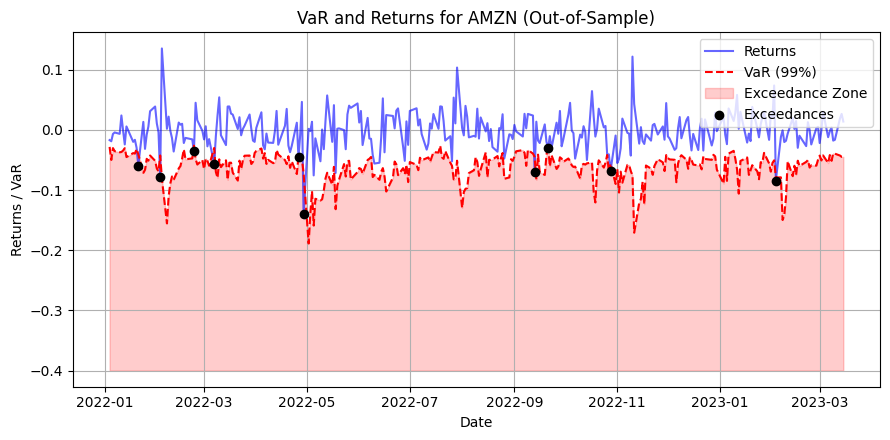

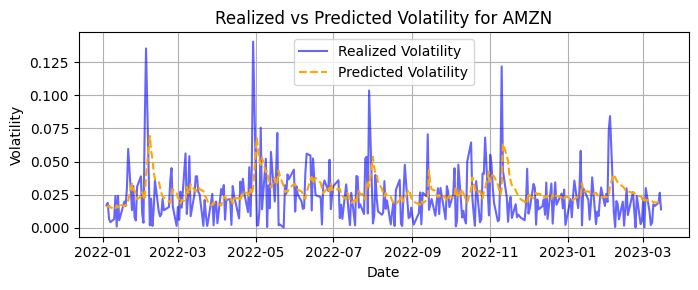


Running Rolling Window FHS-GARCH for DIS...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.80it/s]


Optimizing...
Elapsed time: 0.046779632568359375 s
Unconditional Coverage:  lr_uc=3.916285591040321
Transitions: n00=285.00000001, n01=7.00000001, n10=7.00000001, n11=1e-08
Likelihoods: L_m=4.515243980986244e-15, L_b=3.817498110710495e-15
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


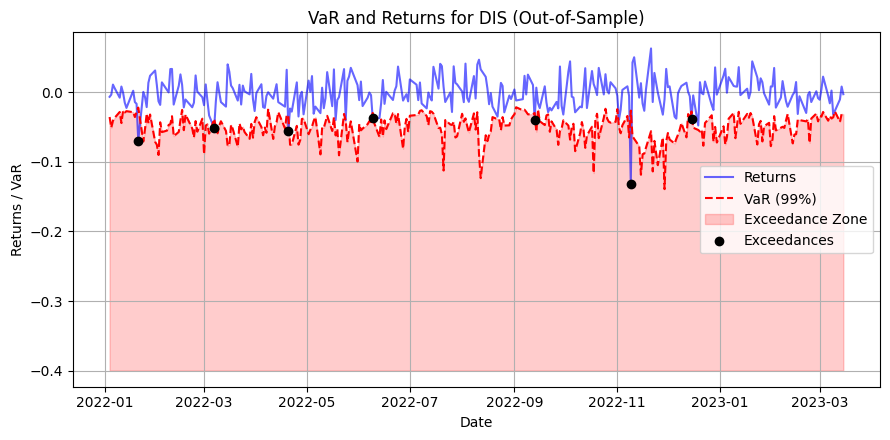

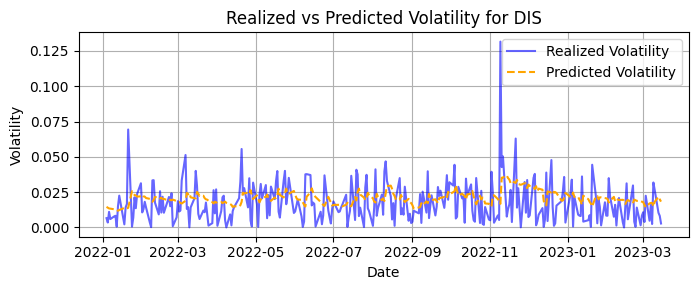


Running Rolling Window FHS-GARCH for AAPL...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 38.74it/s]


Optimizing...
Elapsed time: 0.03745102882385254 s
Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=289.00000001, n01=5.00000001, n10=5.00000001, n11=1e-08
Likelihoods: L_m=1.0004926615874929e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


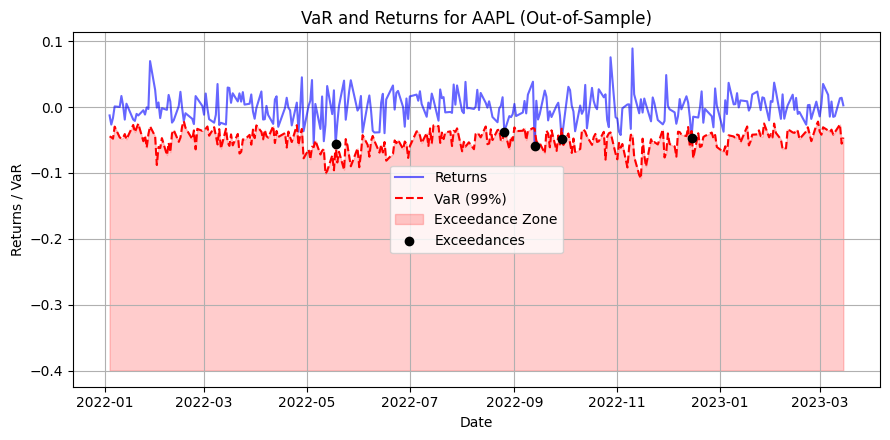

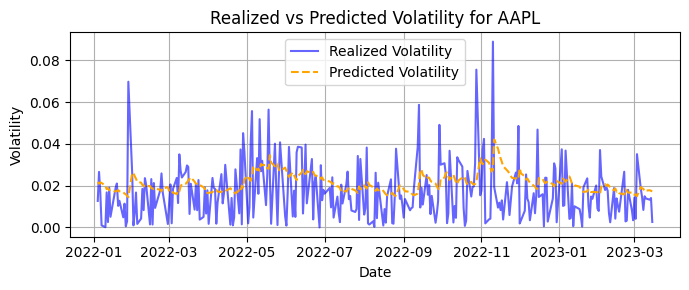


Running Rolling Window FHS-GARCH for MSFT...
Normalizing returns...


100%|██████████| 48/48 [00:02<00:00, 16.69it/s]


Optimizing...
Elapsed time: 0.12570619583129883 s
Unconditional Coverage:  lr_uc=12.801675151891175
Transitions: n00=277.00000001, n01=11.00000001, n10=11.00000001, n11=1e-08
Likelihoods: L_m=5.21412621843859e-21, L_b=3.424882383660646e-21
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


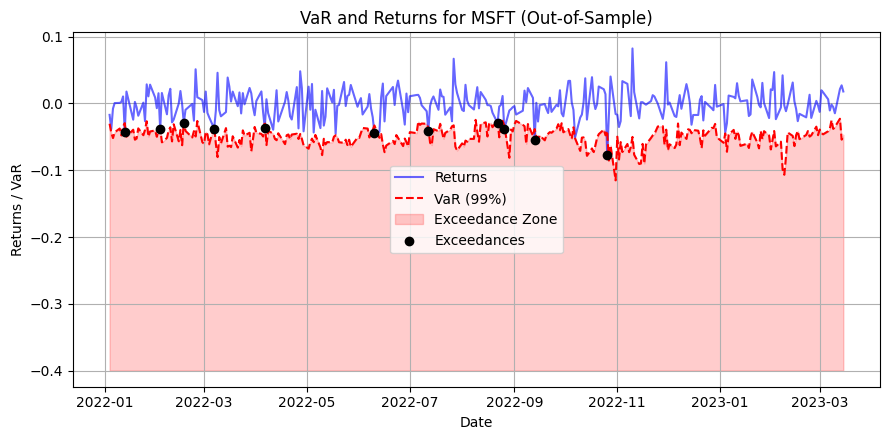

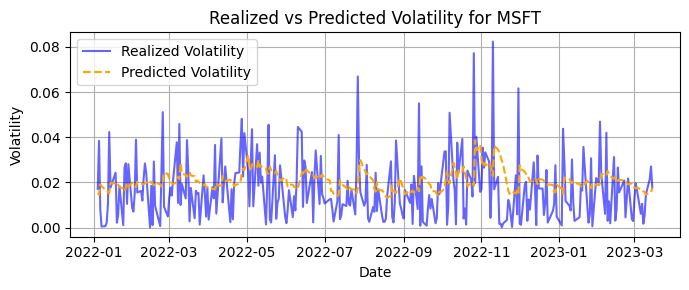


Running Rolling Window FHS-GARCH for JPM...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 43.54it/s]


Optimizing...
Elapsed time: 0.03510022163391113 s
Unconditional Coverage:  lr_uc=2.348171745876755
Transitions: n00=287.00000001, n01=6.00000001, n10=6.00000001, n11=1e-08
Likelihoods: L_m=1.9444714360221249e-13, L_b=1.7195813215159576e-13
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


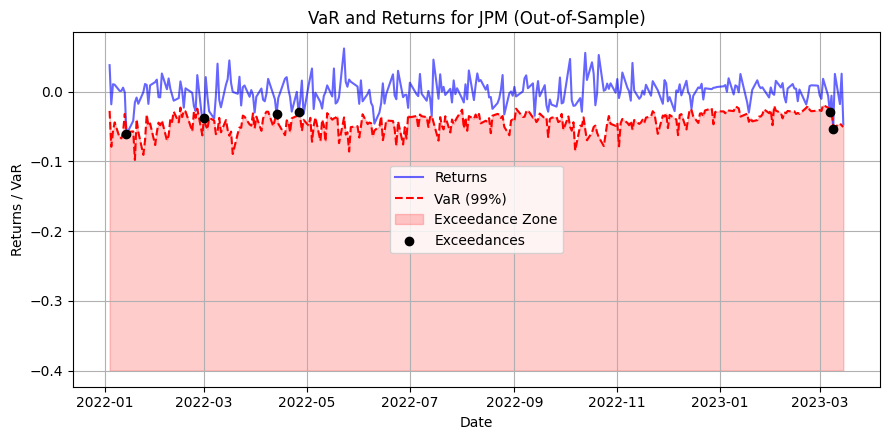

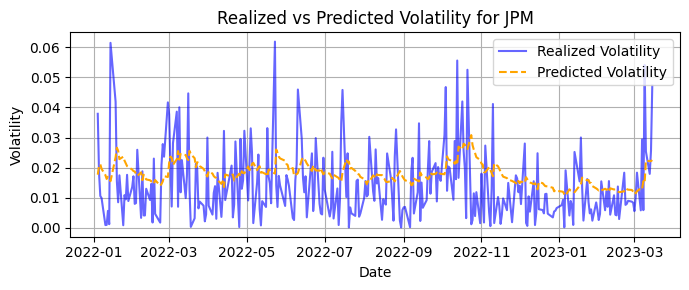


Running Rolling Window FHS-GARCH for F...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.87it/s]


Optimizing...
Elapsed time: 0.04405498504638672 s
Unconditional Coverage:  lr_uc=7.89705790666342
Transitions: n00=281.00000001, n01=9.00000001, n10=9.00000001, n11=1e-08
Likelihoods: L_m=3.7952600812508155e-18, L_b=2.8700984904061123e-18
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


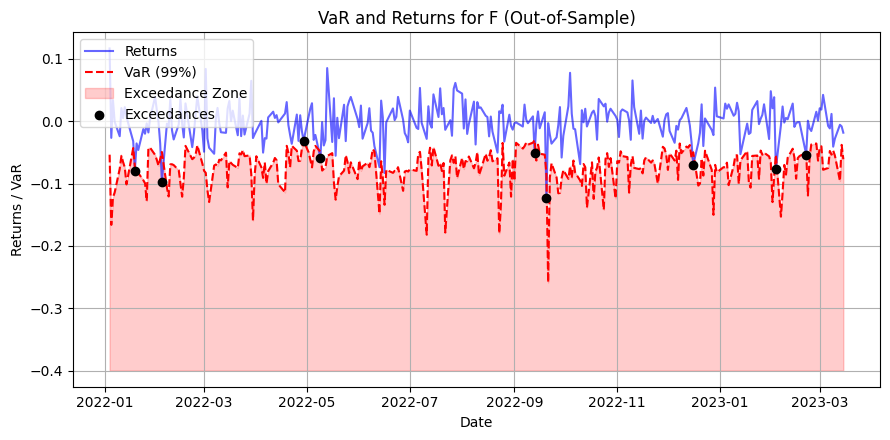

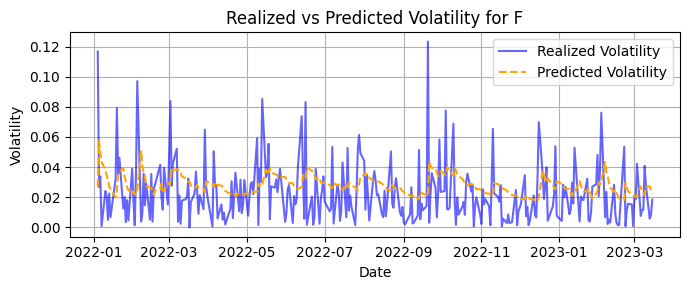


Running Rolling Window FHS-GARCH for PG...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 39.28it/s]


Optimizing...
Elapsed time: 0.06237936019897461 s
Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=289.00000001, n01=5.00000001, n10=5.00000001, n11=1e-08
Likelihoods: L_m=1.0004926615874929e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


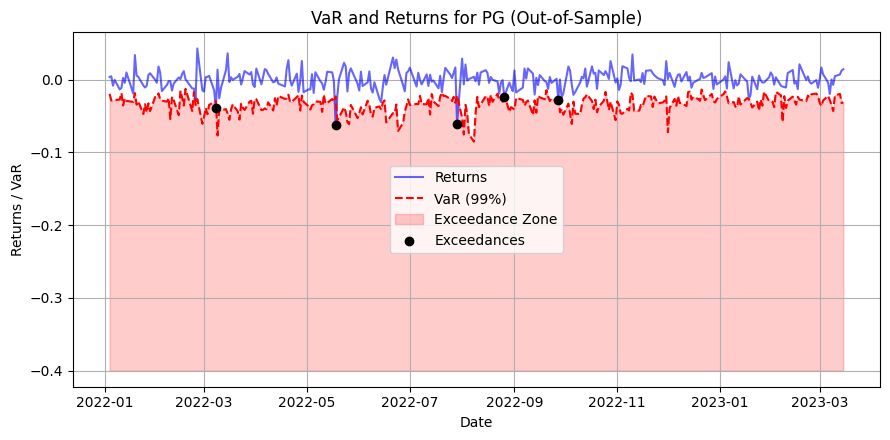

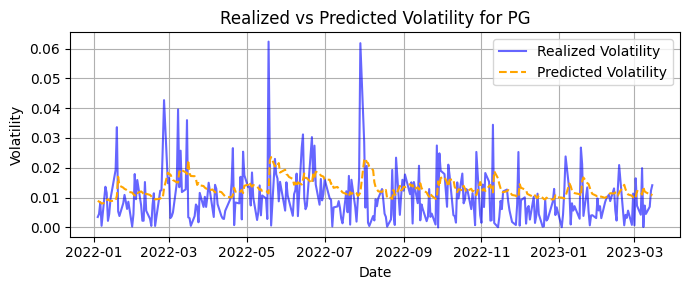


Running Rolling Window FHS-GARCH for ^GSPC...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 34.56it/s]


Optimizing...
Elapsed time: 0.038683414459228516 s
Unconditional Coverage:  lr_uc=1.1217545845607972
Transitions: n00=289.00000001, n01=5.00000001, n10=5.00000001, n11=1e-08
Likelihoods: L_m=1.0004926615874929e-11, L_b=9.189039612851628e-12
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


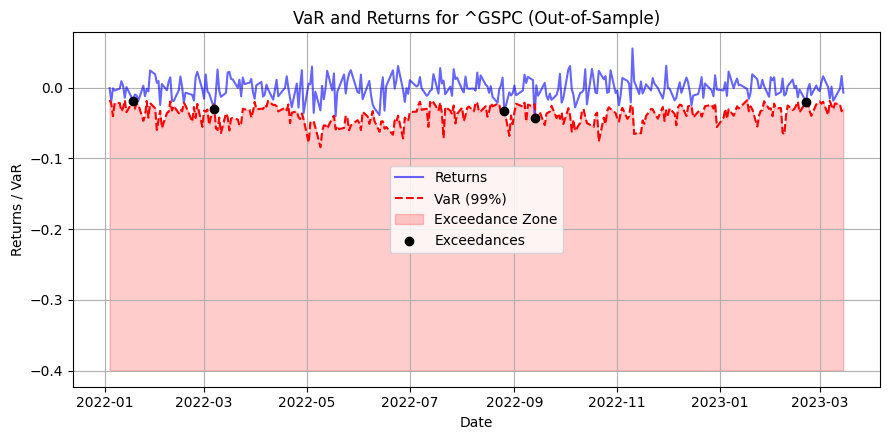

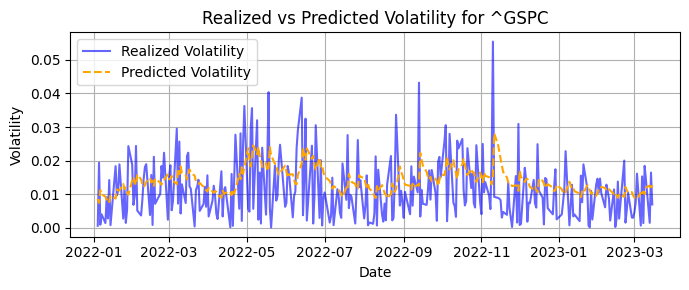


Running Rolling Window FHS-GARCH for ^IXIC...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 41.85it/s]


Optimizing...
Elapsed time: 0.045075416564941406 s
Unconditional Coverage:  lr_uc=0.0
Transitions: n00=293.00000001, n01=3.00000001, n10=3.00000001, n11=1e-08
Likelihoods: L_m=5.2629898452856685e-08, L_b=5.1052870077377365e-08
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


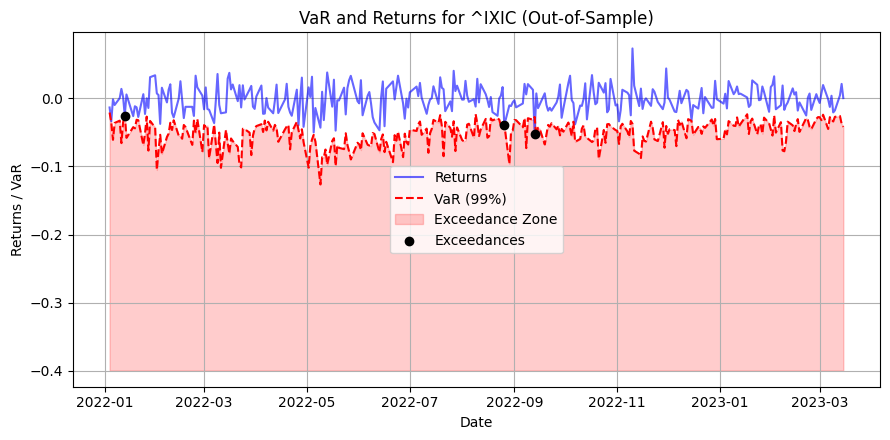

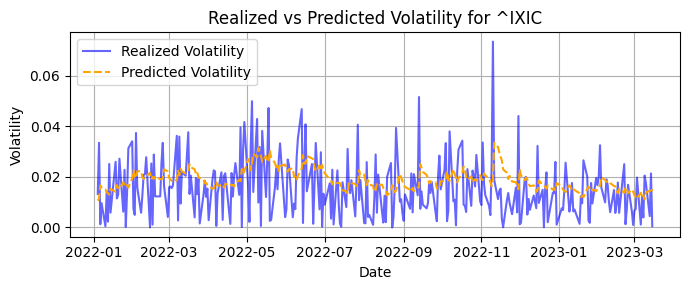


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 10.245750909654362, 'p-value': 0.0013699980440426973, 'Decision': 'Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Failure Rate: 3.33%
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 10.245750909654376, 'p-value': 0.0013699980440426973, 'Decision': 'Reject H0'}, 'Independence': {'LR Statistic': 0.6922943343494126, 'p-value': 0.40538508722261746, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 10.938045244003789, 'p-value': 0.004215350135735818, 'Decision': 'Reject H0'}}
Engle Manganelli Test: {'test_statistic': 1.23083373119044, 'p_value': 0.5404155676896223}
TUFF Test: {'time_to_failure': 13, 'likelihood_ratio': 2.4006247333722683, 'p_value': 0.121286805277

In [ ]:
from arch import arch_model
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

# Parameters
rolling_window_size = 252  # Length of the rolling window
n_simulations = 100  # Number of simulations
forecast_horizon = 300  # Time horizon for the forecast
confidence_level = 0.99
alpha = 1 - confidence_level

# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]


def rolling_fhs_garch_forecast(returns_df, out_of_sample_returns_df, rolling_window=252, n_simulations=100, forecast_horizon=250, confidence_level=0.99):
    fhs_garch_predictions = {}
    backtest_results = {}

    for ticker in out_of_sample_returns_df.columns:
        print(f"\nRunning Rolling Window FHS-GARCH for {ticker}...")

        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]  # Use only historical in-sample data
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna()
        rolling_predictions = []
        rolling_volatility = []

        # Initialize the rolling window with in-sample data
        historical_data = returns_in_sample.copy()

        for t in range(len(returns_out_of_sample)):
            # Use only the last rolling_window data points
            train_data = historical_data[-rolling_window:].dropna()

            # Fit GARCH model on data available up to time t-1
            model = arch_model(train_data, mean='Zero', vol='Garch', p=1, q=1, dist='t', rescale=False)
            res = model.fit(disp='off')

            # Forecast volatility for the next day
            forecast = res.forecast(horizon=1)
            vol = np.sqrt(forecast.variance.iloc[-1, 0])
            rolling_volatility.append(vol)

            # Simulate future returns
            z = res.std_resid.dropna()  # Standardized residuals
            simulated_paths = np.zeros((forecast_horizon, n_simulations))
            for sim in range(n_simulations):
                sampled_residuals = np.random.choice(z, size=forecast_horizon, replace=True)
                simulated_returns = sampled_residuals * vol
                simulated_paths[:, sim] = simulated_returns

            # Calculate daily VaR
            daily_VaRs = np.percentile(simulated_paths, (1 - confidence_level) * 100, axis=1)
            rolling_predictions.append(daily_VaRs[0])

            # Update the rolling window with new data
            historical_data = pd.concat([historical_data, returns_out_of_sample.iloc[t:t+1]]).iloc[-rolling_window:]

        # Align forecasts with out-of-sample dates
        prediction_index = returns_out_of_sample.index[:len(rolling_predictions)]
        VaR_predictions = pd.Series(rolling_predictions, index=prediction_index, name="VaR")
        volatility_predictions = pd.Series(rolling_volatility, index=prediction_index, name="Volatility")

        aligned_returns = returns_out_of_sample.reindex(VaR_predictions.index)
        violations_fhs_garch = (aligned_returns < VaR_predictions).astype(int)

        fhs_garch_predictions[ticker] = {
            "VaR": VaR_predictions,
            "Volatility": volatility_predictions,
            "aligned_returns": aligned_returns
        }

        pnl_var_df = pd.DataFrame({
            "PnL": aligned_returns,
            "VaR": VaR_predictions,
            "Violations": violations_fhs_garch
        })

        # Backtesting results
        kupiec_result_fhs_garch = kupiec_test(pnl_var_df["Violations"], confidence_level)
        berkowitz_result_fhs_garch = berkowitz_tail_test(pnl_var_df[["PnL"]], volatility_window=252, var_conf_level=1-confidence_level, conf_level=0.99)
        failure_rate_fhs_garch = violations_fhs_garch.mean()
        christoffersen_result_fhs_garch = christoffersen_test(aligned_returns, violations_fhs_garch, confidence_level)
        engle_manganelli_result_fhs_garch = engle_manganelli_test(aligned_returns, VaR_predictions, alpha, lags=2)
        tuff_result_fhs_garch = tuff_test(violations_fhs_garch, alpha)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_fhs_garch,
            'berkowitz_result': berkowitz_result_fhs_garch,
            'failure_rate': failure_rate_fhs_garch,
            'christoffersen_result': christoffersen_result_fhs_garch,
            'engle_manganelli_result': engle_manganelli_result_fhs_garch,
            'tuff_result': tuff_result_fhs_garch
        }

        # Plot returns vs VaR with exceedances
        plt.figure(figsize=(9, 4.5))
        plt.plot(aligned_returns.index, aligned_returns, label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_predictions.index, VaR_predictions, label=f"VaR ({int(confidence_level * 100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_predictions.index, VaR_predictions, -0.4, color="red", alpha=0.2, label="Exceedance Zone")
        exceedance_points = pnl_var_df.index[pnl_var_df["Violations"] == 1]
        plt.scatter(exceedance_points, pnl_var_df["PnL"][pnl_var_df["Violations"] == 1], color="black", label="Exceedances", zorder=5)
        plt.title(f"VaR and Returns for {ticker} (Out-of-Sample)")
        plt.xlabel("Date")
        plt.ylabel("Returns / VaR")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

        # Plot realized vs predicted volatility
        realized_volatility = aligned_returns.abs()
        plt.figure(figsize=(7, 3))
        plt.plot(realized_volatility.index, realized_volatility, label="Realized Volatility", color="blue", alpha=0.6)
        plt.plot(volatility_predictions.index, volatility_predictions, label="Predicted Volatility", color="orange", linestyle="--")
        plt.title(f"Realized vs Predicted Volatility for {ticker}")
        plt.xlabel("Date")
        plt.ylabel("Volatility")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return fhs_garch_predictions, backtest_results

fhs_garch_results, backtest_results = rolling_fhs_garch_forecast(returns_df, out_of_sample_returns_df, rolling_window=1000, n_simulations=100, forecast_horizon=250, confidence_level=0.99)

for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Engle Manganelli Test: {results['engle_manganelli_result']}")
    print(f"TUFF Test: {results['tuff_result']}")

## Backtesting quantile regression


Quantile Regression for AMZN...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 38.65it/s]


Optimizing...
Elapsed time: 0.037148475646972656 s
Unconditional Coverage:  lr_uc=12.801675151891175
Transitions: n00=278.00000001, n01=10.00000001, n10=10.00000001, n11=1.00000001
Likelihoods: L_m=4.831698489207206e-21, L_b=3.424882383660646e-21
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


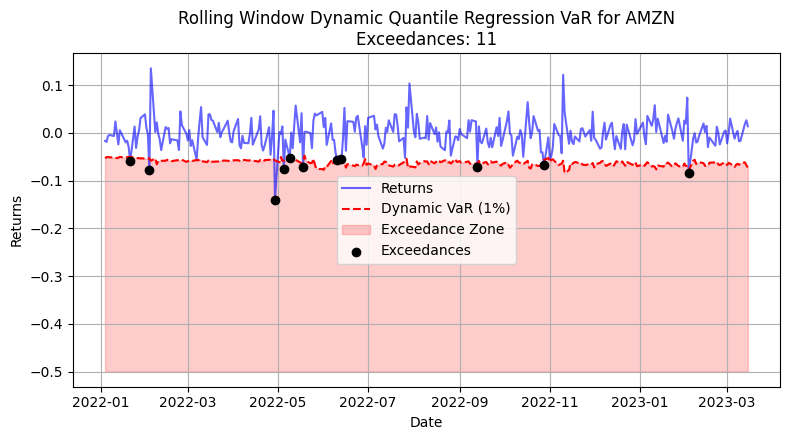


Quantile Regression for DIS...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 33.42it/s]


Optimizing...
Elapsed time: 0.04453277587890625 s
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=291.00000001, n01=4.00000001, n10=4.00000001, n11=1e-08
Likelihoods: L_m=6.362202979374106e-10, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


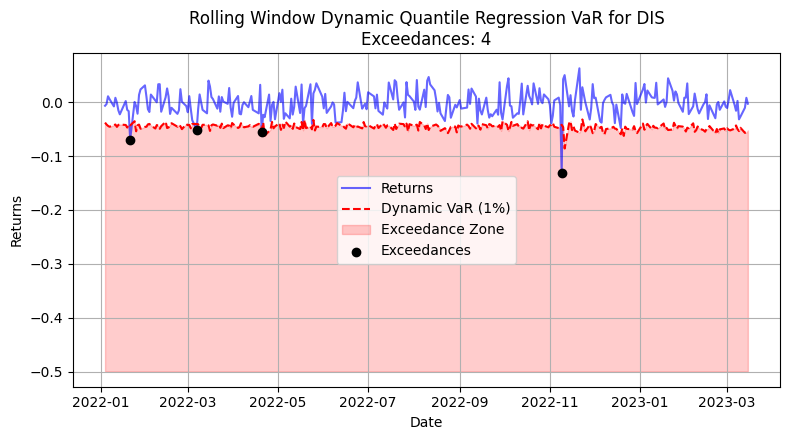


Quantile Regression for AAPL...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 39.30it/s]


Optimizing...
Elapsed time: 0.04404306411743164 s
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


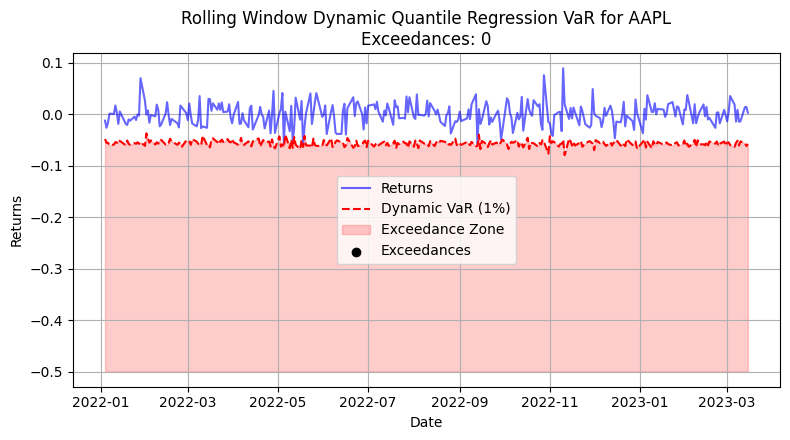


Quantile Regression for MSFT...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 25.21it/s]


Optimizing...
Elapsed time: 0.07191061973571777 s
Unconditional Coverage:  lr_uc=2.348171745876755
Transitions: n00=289.00000001, n01=4.00000001, n10=4.00000001, n11=2.00000001
Likelihoods: L_m=1.4351549206409191e-11, L_b=1.7195813215159576e-13
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


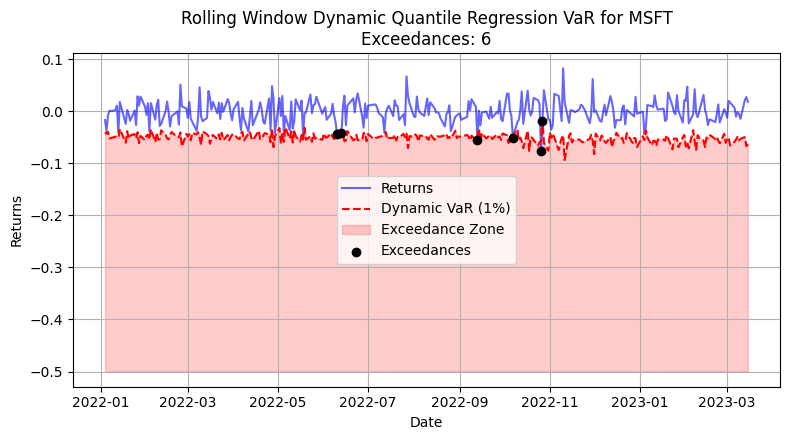


Quantile Regression for JPM...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 43.84it/s]


Optimizing...
Elapsed time: 0.043215036392211914 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=296.00000001, n01=1.00000001, n10=1.00000001, n11=1.00000001
Likelihoods: L_m=0.00031018700623722505, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


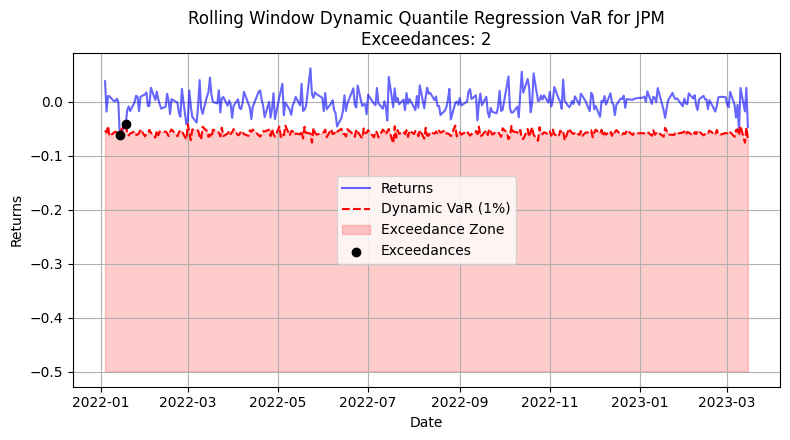


Quantile Regression for F...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 36.38it/s]


Optimizing...
Elapsed time: 0.047129154205322266 s
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=291.00000001, n01=4.00000001, n10=4.00000001, n11=1e-08
Likelihoods: L_m=6.362202979374106e-10, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99      -0.01
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


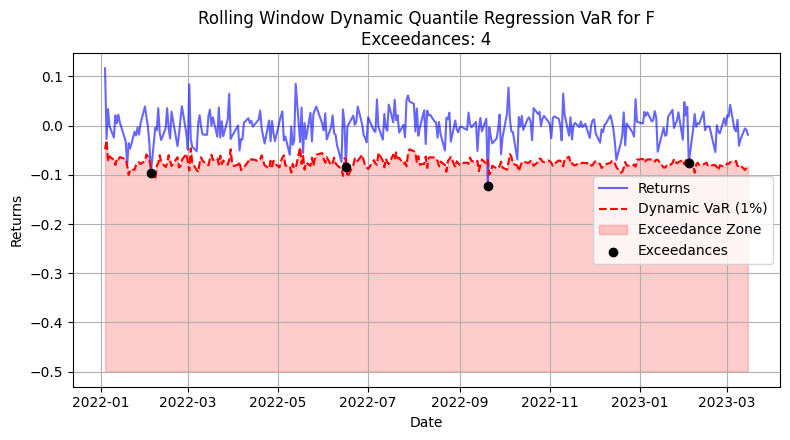


Quantile Regression for PG...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 29.34it/s]


Optimizing...
Elapsed time: 0.04666709899902344 s
Unconditional Coverage:  lr_uc=0.38150279837940104
Transitions: n00=295.00000001, n01=2.00000001, n10=2.00000001, n11=1e-08
Likelihoods: L_m=6.178623596049956e-06, L_b=6.0958997837114875e-06
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 1, Number of columns : 2


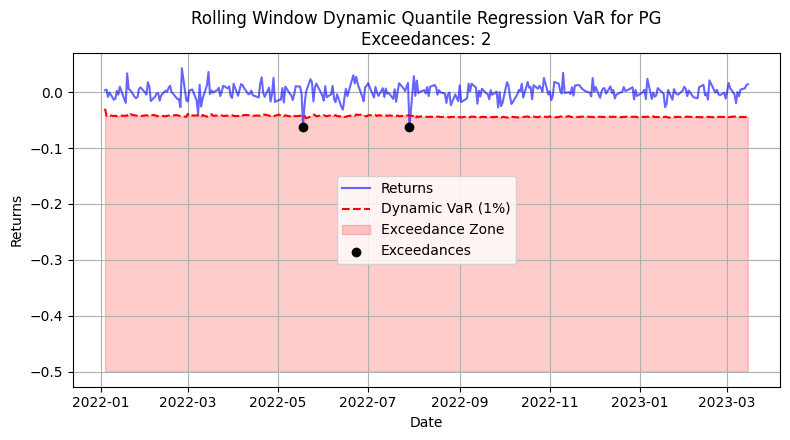


Quantile Regression for ^GSPC...
Normalizing returns...


100%|██████████| 48/48 [00:01<00:00, 35.25it/s]


Optimizing...
Elapsed time: 0.04509711265563965 s
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=291.00000001, n01=4.00000001, n10=4.00000001, n11=1e-08
Likelihoods: L_m=6.362202979374106e-10, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


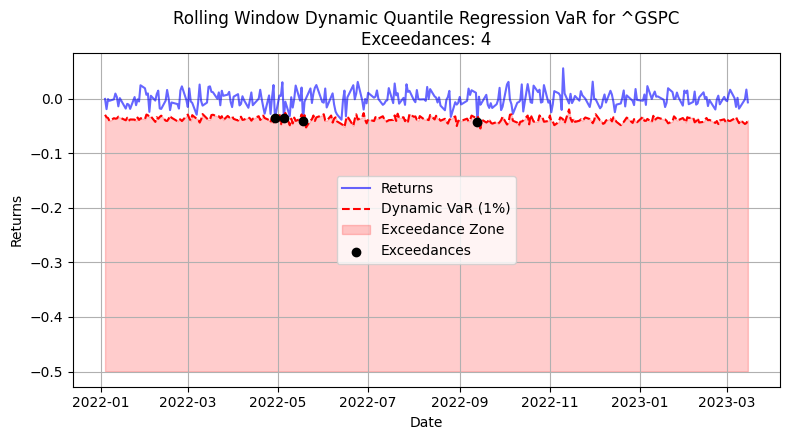


Quantile Regression for ^IXIC...
Normalizing returns...


100%|██████████| 48/48 [00:00<00:00, 48.07it/s]


Optimizing...
Elapsed time: 0.04428601264953613 s
Unconditional Coverage:  lr_uc=0.30482736825983636
Transitions: n00=292.00000001, n01=3.00000001, n10=3.00000001, n11=1.00000001
Likelihoods: L_m=5.607742229199603e-09, L_b=6.026180423256944e-10
Matrix Z for ticker:
     Hit_lag_1  Hit_lag_2
0         0.99       0.99
1         0.99       0.99
2         0.99       0.99
3         0.99       0.99
4         0.99       0.99
..         ...        ...
293       0.99       0.99
294       0.99       0.99
295       0.99       0.99
296       0.99       0.99
297       0.99       0.99

[298 rows x 2 columns]
Rank of Z: 2, Number of columns : 2


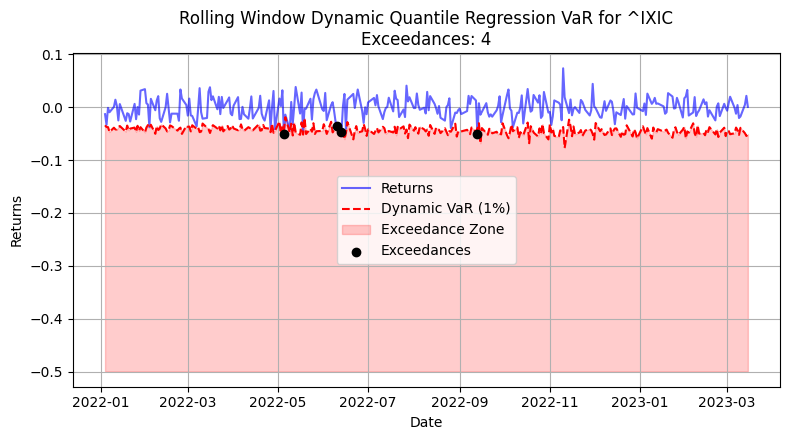


Backtesting results for AMZN:
Kupiec Test: {'LR Statistic': 12.80167515189116, 'p-value': 0.0003463091249028549, 'Decision': 'Reject H0'}
Berkowitz Test: {'solution': array([0.0290558 , 0.83330196]), 'ull': -59.74072396669894, 'rll': -61.13218303873566, 'LR': 2.7829181440734487, 'chi square test': 0.24871215081785514, 'null hypothesis': 'Distribution is Normal(0,1)', 'decision': 'Fail to Reject H0'}
Failure Rate: 3.67%
Christoffersen Test: {'Unconditional Coverage': {'LR Statistic': 12.801675151891175, 'p-value': 0.0003463091249028549, 'Decision': 'Reject H0'}, 'Independence': {'LR Statistic': 0.6882618586826936, 'p-value': 0.4067562169299662, 'Decision': 'Fail to Reject H0'}, 'Conditional Coverage': {'LR Statistic': 13.489937010573868, 'p-value': 0.0011767857412599003, 'Decision': 'Reject H0'}}
Engle Manganelli Test: {'test_statistic': 0.5119956309703693, 'p_value': 0.7741436599186956}
TUFF Test: Time Until First Failure = 13, Likelihood Ratio = 2.400625, P-value = 0.121287, Decision

In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import warnings

def add_lags(data, lags=2):
    lagged_data = data.copy()
    for lag in range(1, lags + 1):
        lagged_data[f'lag_{lag}'] = lagged_data['returns'].shift(lag)
    return lagged_data.dropna()

def add_lags_and_squared(data, lags=1):
    lagged_data = data.copy()
    for lag in range(1, lags + 1):
        lagged_data[f'lag_{lag}'] = lagged_data['returns'].shift(lag)
        lagged_data[f'lag_{lag}_squared'] = lagged_data[f'lag_{lag}'] ** 2
    return lagged_data.dropna()

def generate_out_of_sample_lags(out_of_sample_row, in_sample_data, lags):
    """
    Generate lagged features for the out-of-sample row based on the latest in-sample data.
    """
    lagged_features = {}
    for lag in range(1, lags + 1):
        lagged_value = in_sample_data['returns'].iloc[-lag] if len(in_sample_data) >= lag else np.nan
        lagged_features[f'lag_{lag}'] = lagged_value
    return lagged_features


# Data out-of-sample
out_of_sample_returns = (prices_out_of_sample.values[1:] / prices_out_of_sample.values[:-1]) - 1
out_of_sample_returns_df = pd.DataFrame(
    out_of_sample_returns, columns=prices_out_of_sample.columns, index=prices_out_of_sample.index[1:]
)
out_of_sample_returns_df= out_of_sample_returns_df.iloc[:300]
backtest_results= {}
warnings.filterwarnings("ignore", category=sm.tools.sm_exceptions.IterationLimitWarning)

def backtest_var(returns_df, out_of_sample_returns_df, alpha=0.01, lags=2, window=250):
    results = {}

    for ticker in returns_df.columns:
        print(f"\nQuantile Regression for {ticker}...")

        # In-sample data
        returns_in_sample = returns_df[ticker].dropna().iloc[:-300]
        returns_in_sample = returns_in_sample.to_frame(name='returns')

        # Out-of-sample data
        returns_out_of_sample = out_of_sample_returns_df[ticker].dropna().iloc[:300]
        returns_out_of_sample = returns_out_of_sample.to_frame(name='returns')

        VaR_dynamic_series = []
        index_series = []
        exceedances = 0
        exceedance_points = []

        violations = []  # Store 1 for exceedances, 0 otherwise

        # Rolling window prediction for out-of-sample data
        for out_of_sample_index, out_of_sample_row in returns_out_of_sample.iterrows():
            lagged_data = add_lags(returns_in_sample, lags=lags)

            if lagged_data.empty:
                continue

            y = lagged_data['returns']
            X = lagged_data.drop(columns=['returns'])
            X = sm.add_constant(X)

            model = sm.QuantReg(y, X)
            try:
                quantile_model = model.fit(q=alpha, max_iter=5000, disp=False)
            except Exception as e:
                warnings.warn(f"Quantile regression failed for {ticker} at index {out_of_sample_index}: {e}")
                continue

            # Generate lagged features for the current out-of-sample observation
            lagged_features = generate_out_of_sample_lags(out_of_sample_row, returns_in_sample, lags)
            X_out_of_sample = [1] + [lagged_features[f'lag_{i}'] for i in range(1, lags + 1)]

            # Predict VaR for the current out-of-sample observation
            try:
                VaR_dynamic = quantile_model.predict([X_out_of_sample])[0]
            except Exception as e:
                warnings.warn(f"Prediction failed for {ticker} at index {out_of_sample_index}: {e}")
                continue

            VaR_dynamic_series.append(VaR_dynamic)
            index_series.append(out_of_sample_index)

            # Check for exceedance
            if out_of_sample_row['returns'] < VaR_dynamic:
                exceedances += 1
                exceedance_points.append(out_of_sample_index)
                violations.append(1)
            else:
                violations.append(0)

            # Update the in-sample data with the current out-of-sample observation
            returns_in_sample = pd.concat([returns_in_sample, out_of_sample_row.to_frame().T])
            returns_in_sample = returns_in_sample.iloc[-window:]  # Keep the window size fixed

        VaR_dynamic_series = pd.Series(VaR_dynamic_series, index=pd.DatetimeIndex(index_series), name='VaR_dynamic')

        aligned_returns = returns_out_of_sample.reindex(VaR_dynamic_series.index).squeeze()

        violations_2 = (returns_out_of_sample["returns"] < VaR_dynamic_series).astype(int)
        # Store results for further analysis
        results[ticker] = {
            "VaR": VaR_dynamic_series,
            "violations": pd.Series(violations, index=pd.DatetimeIndex(index_series)),
            "exceedances": exceedances,
            "violations_2": violations_2,
            "returns_out_of_sample": returns_out_of_sample,
            "aligned_returns": aligned_returns
        }
        alligned_returns_dataframe = returns_out_of_sample["returns"].to_frame()
        kupiec_result_garch = kupiec_test(violations_2, 0.99)
        berkowitz_result_garch  = berkowitz_tail_test(alligned_returns_dataframe, volatility_window=252, var_conf_level=1-0.99, conf_level=0.99)
        failure_rate_garch  = violations_2.mean()
        christoffersen_result_garch  = christoffersen_test(aligned_returns, violations_2, 0.99)
        engle_manganelli_result_garch  = engle_manganelli_test(aligned_returns, VaR_dynamic_series, alpha, lags=2)
        tuff_result_garch  = tuff_test(violations_2, alpha)

        backtest_results[ticker] = {
            'kupiec_result': kupiec_result_garch ,
            'berkowitz_result': berkowitz_result_garch ,
            'failure_rate': failure_rate_garch ,
            'christoffersen_result': christoffersen_result_garch ,
            'engle_manganelli_result': engle_manganelli_result_garch ,
            'tuff_result': tuff_result_garch
        }
        plt.figure(figsize=(8, 4.5))
        plt.plot(returns_out_of_sample.index, returns_out_of_sample['returns'], label="Returns", color="blue", alpha=0.6)
        plt.plot(VaR_dynamic_series.index, VaR_dynamic_series, label=f"Dynamic VaR ({int(alpha*100)}%)", color="red", linestyle="--")
        plt.fill_between(VaR_dynamic_series.index, VaR_dynamic_series, -0.5, color="red", alpha=0.2, label="Exceedance Zone")
        plt.scatter(exceedance_points, returns_out_of_sample.loc[exceedance_points, 'returns'], color='black', label="Exceedances", zorder=5)
        plt.title(f"Rolling Window Dynamic Quantile Regression VaR for {ticker}\nExceedances: {exceedances}")
        plt.xlabel("Date")
        plt.ylabel("Returns")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return results, backtest_results


results_quantile, backtest_results = backtest_var(returns_df, out_of_sample_returns_df, alpha=0.01, lags=2, window=1000)


for ticker, results in backtest_results.items():
    print(f"\nBacktesting results for {ticker}:")
    print(f"Kupiec Test: {results['kupiec_result']}")
    print(f"Berkowitz Test: {results['berkowitz_result']}")
    print(f"Failure Rate: {results['failure_rate']:.2%}")
    print(f"Christoffersen Test: {results['christoffersen_result']}")
    print(f"Engle Manganelli Test: {results['engle_manganelli_result']}")

    tuff_result_garch  = results['tuff_result']
    print(f"TUFF Test: Time Until First Failure = {tuff_result_garch['time_to_failure']}, "
          f"Likelihood Ratio = {tuff_result_garch['likelihood_ratio']:.6f}, "
          f"P-value = {tuff_result_garch['p_value']:.6f}, Decision = {tuff_result_garch['decision']}")